# Deep Convolutional GANs

In this notebook, you'll build a GAN using convolutional layers in the generator and discriminator. This is called a Deep Convolutional GAN, or DCGAN for short. The DCGAN architecture was first explored last year and has seen impressive results in generating new images, you can read the [original paper here](https://arxiv.org/pdf/1511.06434.pdf).

You'll be training DCGAN on the [Street View House Numbers](http://ufldl.stanford.edu/housenumbers/) (SVHN) dataset. These are color images of house numbers collected from Google street view. SVHN images are in color and much more variable than MNIST. 

![SVHN Examples](assets/SVHN_examples.png)

So, we'll need a deeper and more powerful network. This is accomplished through using convolutional layers in the discriminator and generator. It's also necessary to use batch normalization to get the convolutional networks to train. The only real changes compared to what [you saw previously](https://github.com/udacity/deep-learning/tree/master/gan_mnist) are in the generator and discriminator, otherwise the rest of the implementation is the same.

In [1]:
%matplotlib inline

import pickle as pkl

import matplotlib.pyplot as plt
import numpy as np
from scipy.io import loadmat
import tensorflow as tf

In [2]:
!mkdir data

mkdir: cannot create directory ‘data’: File exists


## Getting the data

Here you can download the SVHN dataset. Run the cell above and it'll download to your machine.

In [3]:
from urllib.request import urlretrieve
from os.path import isfile, isdir
from tqdm import tqdm

data_dir = 'data/'

if not isdir(data_dir):
    raise Exception("Data directory doesn't exist!")

class DLProgress(tqdm):
    last_block = 0

    def hook(self, block_num=1, block_size=1, total_size=None):
        self.total = total_size
        self.update((block_num - self.last_block) * block_size)
        self.last_block = block_num

if not isfile(data_dir + "train_32x32.mat"):
    with DLProgress(unit='B', unit_scale=True, miniters=1, desc='SVHN Training Set') as pbar:
        urlretrieve(
            'http://ufldl.stanford.edu/housenumbers/train_32x32.mat',
            data_dir + 'train_32x32.mat',
            pbar.hook)

if not isfile(data_dir + "test_32x32.mat"):
    with DLProgress(unit='B', unit_scale=True, miniters=1, desc='SVHN Testing Set') as pbar:
        urlretrieve(
            'http://ufldl.stanford.edu/housenumbers/test_32x32.mat',
            data_dir + 'test_32x32.mat',
            pbar.hook)

SVHN Training Set: 182MB [00:10, 16.8MB/s]                              
SVHN Testing Set: 64.3MB [00:04, 15.3MB/s]                            


These SVHN files are `.mat` files typically used with Matlab. However, we can load them in with `scipy.io.loadmat` which we imported above.

In [4]:
trainset = loadmat(data_dir + 'train_32x32.mat')
testset = loadmat(data_dir + 'test_32x32.mat')

Here I'm showing a small sample of the images. Each of these is 32x32 with 3 color channels (RGB). These are the real images we'll pass to the discriminator and what the generator will eventually fake.

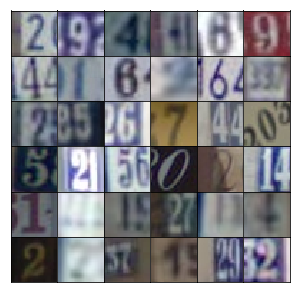

In [5]:
idx = np.random.randint(0, trainset['X'].shape[3], size=36)
fig, axes = plt.subplots(6, 6, sharex=True, sharey=True, figsize=(5,5),)
for ii, ax in zip(idx, axes.flatten()):
    ax.imshow(trainset['X'][:,:,:,ii], aspect='equal')
    ax.xaxis.set_visible(False)
    ax.yaxis.set_visible(False)
plt.subplots_adjust(wspace=0, hspace=0)

Here we need to do a bit of preprocessing and getting the images into a form where we can pass batches to the network. First off, we need to rescale the images to a range of -1 to 1, since the output of our generator is also in that range. We also have a set of test and validation images which could be used if we're trying to identify the numbers in the images.

In [6]:
def scale(x, feature_range=(-1, 1)):
    # scale to (0, 1)
    x = ((x - x.min())/(255 - x.min()))
    
    # scale to feature_range
    min, max = feature_range
    x = x * (max - min) + min
    return x

In [7]:
class Dataset:
    def __init__(self, train, test, val_frac=0.5, shuffle=False, scale_func=None):
        split_idx = int(len(test['y'])*(1 - val_frac))
        self.test_x, self.valid_x = test['X'][:,:,:,:split_idx], test['X'][:,:,:,split_idx:]
        self.test_y, self.valid_y = test['y'][:split_idx], test['y'][split_idx:]
        self.train_x, self.train_y = train['X'], train['y']
        
        self.train_x = np.rollaxis(self.train_x, 3)
        self.valid_x = np.rollaxis(self.valid_x, 3)
        self.test_x = np.rollaxis(self.test_x, 3)
        
        if scale_func is None:
            self.scaler = scale
        else:
            self.scaler = scale_func
        self.shuffle = shuffle
        
    def batches(self, batch_size):
        if self.shuffle:
            idx = np.arange(len(dataset.train_x))
            np.random.shuffle(idx)
            self.train_x = self.train_x[idx]
            self.train_y = self.train_y[idx]
        
        n_batches = len(self.train_y)//batch_size
        for ii in range(0, len(self.train_y), batch_size):
            x = self.train_x[ii:ii+batch_size]
            y = self.train_y[ii:ii+batch_size]
            
            yield self.scaler(x), y

## Network Inputs

Here, just creating some placeholders like normal.

In [8]:
def model_inputs(real_dim, z_dim):
    inputs_real = tf.placeholder(tf.float32, (None, *real_dim), name='input_real')
    inputs_z = tf.placeholder(tf.float32, (None, z_dim), name='input_z')
    
    return inputs_real, inputs_z

## Generator

Here you'll build the generator network. The input will be our noise vector `z` as before. Also as before, the output will be a $tanh$ output, but this time with size 32x32 which is the size of our SVHN images.

What's new here is we'll use convolutional layers to create our new images. The first layer is a fully connected layer which is reshaped into a deep and narrow layer, something like 4x4x1024 as in the original DCGAN paper. Then we use batch normalization and a leaky ReLU activation. Next is a transposed convolution where typically you'd halve the depth and double the width and height of the previous layer. Again, we use batch normalization and leaky ReLU. For each of these layers, the general scheme is convolution > batch norm > leaky ReLU.

You keep stacking layers up like this until you get the final transposed convolution layer with shape 32x32x3. Below is the archicture used in the original DCGAN paper:

![DCGAN Generator](assets/dcgan.png)

Note that the final layer here is 64x64x3, while for our SVHN dataset, we only want it to be 32x32x3. 

>**Exercise:** Build the transposed convolutional network for the generator in the function below. Be sure to use leaky ReLUs on all the layers except for the last tanh layer, as well as batch normalization on all the transposed convolutional layers except the last one.

In [9]:
def generator(z, output_dim, reuse=False, alpha=0.2, training=True):
    with tf.variable_scope('generator', reuse=reuse):
        # First fully connected layer
        x1 = tf.layers.dense(z, 4 * 4 * 512)
        # Reshape it to start the convolutional stack
        x1 = tf.reshape(x1, (-1, 4, 4, 512))
        x1 = tf.layers.batch_normalization(x1, training = training)
        x1 = tf.maximum(alpha * x1, x1)
        # 4x4x512 now
        
        x2 = tf.layers.conv2d_transpose(x1, 256, 5, strides = 2, padding = 'same')
        x2 = tf.layers.batch_normalization(x2, training = training)
        x2 = tf.maximum(alpha * x2, x2)
        # 8x8x256 now
        
        x3 = tf.layers.conv2d_transpose(x2, 128, 5, strides = 2, padding = 'same')
        x3 = tf.layers.batch_normalization(x3, training = training)
        x3 = tf.maximum(alpha * x3, x3)
        # 16x16x128

        logits = tf.layers.conv2d_transpose(x3, output_dim, 5, strides = 2, padding = 'same')
        # Output layer, 32x32x3        
        out = tf.tanh(logits)
        
        return out

## Discriminator

Here you'll build the discriminator. This is basically just a convolutional classifier like you've built before. The input to the discriminator are 32x32x3 tensors/images. You'll want a few convolutional layers, then a fully connected layer for the output. As before, we want a sigmoid output, and you'll need to return the logits as well. For the depths of the convolutional layers I suggest starting with 16, 32, 64 filters in the first layer, then double the depth as you add layers. Note that in the DCGAN paper, they did all the downsampling using only strided convolutional layers with no maxpool layers.

You'll also want to use batch normalization with `tf.layers.batch_normalization` on each layer except the first convolutional and output layers. Again, each layer should look something like convolution > batch norm > leaky ReLU.

Note: in this project, your batch normalization layers will always use batch statistics. (That is, always set `training` to `True`.) That's because we are only interested in using the discriminator to help train the generator. However, if you wanted to use the discriminator for inference later, then you would need to set the `training` parameter appropriately.

>**Exercise:** Build the convolutional network for the discriminator. The input is a 32x32x3 images, the output is a sigmoid plus the logits. Again, use Leaky ReLU activations and batch normalization on all the layers except the first.

In [10]:
def discriminator(x, reuse = False, alpha = .2):
    with tf.variable_scope('discriminator', reuse = reuse):
        # Input layer is 32x32x3
        x1 = tf.layers.conv2d(x, 64, 5, strides = 2, padding = 'same')
        relu1 = tf.maximum(alpha * x1, x1)
        # 16x16x64

        x2 = tf.layers.conv2d(relu1, 128, 5, strides = 2, padding = 'same')
        bn2 = tf.layers.batch_normalization(x2, training = True)
        relu2 = tf.maximum(alpha * bn2, bn2)
        # 8x8x128

        x3 = tf.layers.conv2d(relu2, 256, 5, strides = 2, padding = 'same')
        bn3 = tf.layers.batch_normalization(x3, training = True)
        relu3 = tf.maximum(alpha * bn3, bn3)
        # 4x4x256

        flat = tf.reshape(relu3, (-1, 4*4*256))
        logits = tf.layers.dense(flat, 1)
        out = tf.sigmoid(logits)
        
        return out, logits

## Model Loss

Calculating the loss like before, nothing new here.

In [11]:
def model_loss(input_real, input_z, output_dim, alpha=0.2):
    """
    Get the loss for the discriminator and generator
    :param input_real: Images from the real dataset
    :param input_z: Z input
    :param out_channel_dim: The number of channels in the output image
    :return: A tuple of (discriminator loss, generator loss)
    """
    g_model = generator(input_z, output_dim, alpha=alpha)
    d_model_real, d_logits_real = discriminator(input_real, alpha=alpha)
    d_model_fake, d_logits_fake = discriminator(g_model, reuse=True, alpha=alpha)

    d_loss_real = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_real, labels=tf.ones_like(d_model_real)))
    d_loss_fake = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_fake, labels=tf.zeros_like(d_model_fake)))
    g_loss = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_fake, labels=tf.ones_like(d_model_fake)))

    d_loss = d_loss_real + d_loss_fake

    return d_loss, g_loss

## Optimizers

Not much new here, but notice how the train operations are wrapped in a `with tf.control_dependencies` block so the batch normalization layers can update their population statistics.

In [12]:
def model_opt(d_loss, g_loss, learning_rate, beta1):
    """
    Get optimization operations
    :param d_loss: Discriminator loss Tensor
    :param g_loss: Generator loss Tensor
    :param learning_rate: Learning Rate Placeholder
    :param beta1: The exponential decay rate for the 1st moment in the optimizer
    :return: A tuple of (discriminator training operation, generator training operation)
    """
    # Get weights and bias to update
    t_vars = tf.trainable_variables()
    d_vars = [var for var in t_vars if var.name.startswith('discriminator')]
    g_vars = [var for var in t_vars if var.name.startswith('generator')]

    # Optimize
    with tf.control_dependencies(tf.get_collection(tf.GraphKeys.UPDATE_OPS)):
        d_train_opt = tf.train.AdamOptimizer(learning_rate, beta1=beta1).minimize(d_loss, var_list=d_vars)
        g_train_opt = tf.train.AdamOptimizer(learning_rate, beta1=beta1).minimize(g_loss, var_list=g_vars)

    return d_train_opt, g_train_opt

## Building the model

Here we can use the functions we defined about to build the model as a class. This will make it easier to move the network around in our code since the nodes and operations in the graph are packaged in one object.

In [13]:
class GAN:
    def __init__(self, real_size, z_size, learning_rate, alpha=0.2, beta1=0.5):
        tf.reset_default_graph()
        
        self.input_real, self.input_z = model_inputs(real_size, z_size)
        
        self.d_loss, self.g_loss = model_loss(self.input_real, self.input_z,
                                              real_size[2], alpha=alpha)
        
        self.d_opt, self.g_opt = model_opt(self.d_loss, self.g_loss, learning_rate, beta1)

Here is a function for displaying generated images.

In [14]:
def view_samples(epoch, samples, nrows, ncols, figsize=(5,5)):
    fig, axes = plt.subplots(figsize=figsize, nrows=nrows, ncols=ncols, 
                             sharey=True, sharex=True)
    for ax, img in zip(axes.flatten(), samples[epoch]):
        ax.axis('off')
        img = ((img - img.min())*255 / (img.max() - img.min())).astype(np.uint8)
        ax.set_adjustable('box-forced')
        im = ax.imshow(img, aspect='equal')
   
    plt.subplots_adjust(wspace=0, hspace=0)
    return fig, axes

And another function we can use to train our network. Notice when we call `generator` to create the samples to display, we set `training` to `False`. That's so the batch normalization layers will use the population statistics rather than the batch statistics. Also notice that we set the `net.input_real` placeholder when we run the generator's optimizer. The generator doesn't actually use it, but we'd get an error without it because of the `tf.control_dependencies` block we created in `model_opt`. 

In [15]:
def train(net, dataset, epochs, batch_size, print_every=10, show_every=100, figsize=(5,5)):
    saver = tf.train.Saver()
    sample_z = np.random.uniform(-1, 1, size=(72, z_size))

    samples, losses = [], []
    steps = 0

    with tf.Session() as sess:
        sess.run(tf.global_variables_initializer())
        for e in range(epochs):
            for x, y in dataset.batches(batch_size):
                steps += 1

                # Sample random noise for G
                batch_z = np.random.uniform(-1, 1, size=(batch_size, z_size))

                # Run optimizers
                _ = sess.run(net.d_opt, feed_dict={net.input_real: x, net.input_z: batch_z})
                _ = sess.run(net.g_opt, feed_dict={net.input_z: batch_z, net.input_real: x})

                if steps % print_every == 0:
                    # At the end of each epoch, get the losses and print them out
                    train_loss_d = net.d_loss.eval({net.input_z: batch_z, net.input_real: x})
                    train_loss_g = net.g_loss.eval({net.input_z: batch_z})

                    print("Epoch {}/{}...".format(e+1, epochs),
                          "Discriminator Loss: {:.4f}...".format(train_loss_d),
                          "Generator Loss: {:.4f}".format(train_loss_g))
                    # Save losses to view after training
                    losses.append((train_loss_d, train_loss_g))

                if steps % show_every == 0:
                    gen_samples = sess.run(
                                   generator(net.input_z, 3, reuse=True, training=False),
                                   feed_dict={net.input_z: sample_z})
                    samples.append(gen_samples)
                    _ = view_samples(-1, samples, 6, 12, figsize=figsize)
                    plt.show()

        saver.save(sess, './checkpoints/generator.ckpt')

    with open('samples.pkl', 'wb') as f:
        pkl.dump(samples, f)
    
    return losses, samples

## Hyperparameters

GANs are very sensitive to hyperparameters. A lot of experimentation goes into finding the best hyperparameters such that the generator and discriminator don't overpower each other. Try out your own hyperparameters or read [the DCGAN paper](https://arxiv.org/pdf/1511.06434.pdf) to see what worked for them.

>**Exercise:** Find hyperparameters to train this GAN. The values found in the DCGAN paper work well, or you can experiment on your own. In general, you want the discriminator loss to be around 0.3, this means it is correctly classifying images as fake or real about 50% of the time.

In [16]:
real_size = (32,32,3)
z_size = 100
learning_rate = 0.0002
batch_size = 128
epochs = 25
alpha = 0.2
beta1 = 0.5

# Create the network
net = GAN(real_size, z_size, learning_rate, alpha=alpha, beta1=beta1)

Epoch 1/25... Discriminator Loss: 1.6343... Generator Loss: 0.4519
Epoch 1/25... Discriminator Loss: 0.3988... Generator Loss: 1.9507
Epoch 1/25... Discriminator Loss: 0.1579... Generator Loss: 2.6182
Epoch 1/25... Discriminator Loss: 0.2114... Generator Loss: 2.6562
Epoch 1/25... Discriminator Loss: 0.1331... Generator Loss: 2.9807
Epoch 1/25... Discriminator Loss: 0.3004... Generator Loss: 1.8527
Epoch 1/25... Discriminator Loss: 0.1077... Generator Loss: 3.0008
Epoch 1/25... Discriminator Loss: 0.1809... Generator Loss: 3.3662
Epoch 1/25... Discriminator Loss: 0.1488... Generator Loss: 3.8683
Epoch 1/25... Discriminator Loss: 0.7583... Generator Loss: 1.6567


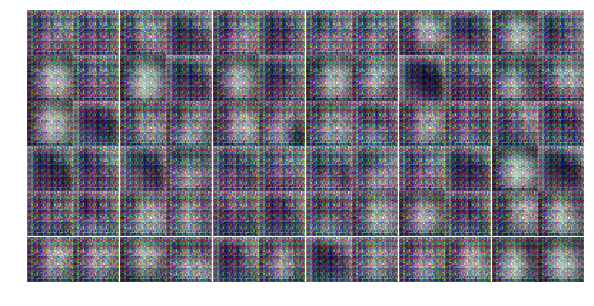

Epoch 1/25... Discriminator Loss: 0.6480... Generator Loss: 2.0740
Epoch 1/25... Discriminator Loss: 0.7875... Generator Loss: 2.9278
Epoch 1/25... Discriminator Loss: 0.4879... Generator Loss: 1.4535
Epoch 1/25... Discriminator Loss: 0.3655... Generator Loss: 2.1880
Epoch 1/25... Discriminator Loss: 0.5457... Generator Loss: 2.2308
Epoch 1/25... Discriminator Loss: 0.4367... Generator Loss: 2.1601
Epoch 1/25... Discriminator Loss: 0.3855... Generator Loss: 1.6415
Epoch 1/25... Discriminator Loss: 0.5623... Generator Loss: 1.3167
Epoch 1/25... Discriminator Loss: 0.4097... Generator Loss: 1.8158
Epoch 1/25... Discriminator Loss: 0.3880... Generator Loss: 5.5148


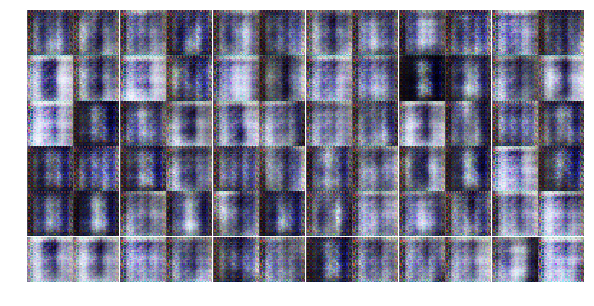

Epoch 1/25... Discriminator Loss: 1.0563... Generator Loss: 0.5473
Epoch 1/25... Discriminator Loss: 0.1425... Generator Loss: 3.3191
Epoch 1/25... Discriminator Loss: 0.5785... Generator Loss: 1.4631
Epoch 1/25... Discriminator Loss: 0.1384... Generator Loss: 3.4465
Epoch 1/25... Discriminator Loss: 2.2837... Generator Loss: 4.2791
Epoch 1/25... Discriminator Loss: 0.7773... Generator Loss: 1.6077
Epoch 1/25... Discriminator Loss: 0.7697... Generator Loss: 1.7901
Epoch 1/25... Discriminator Loss: 0.6282... Generator Loss: 1.5914
Epoch 1/25... Discriminator Loss: 0.7430... Generator Loss: 1.1816
Epoch 1/25... Discriminator Loss: 0.7845... Generator Loss: 1.0777


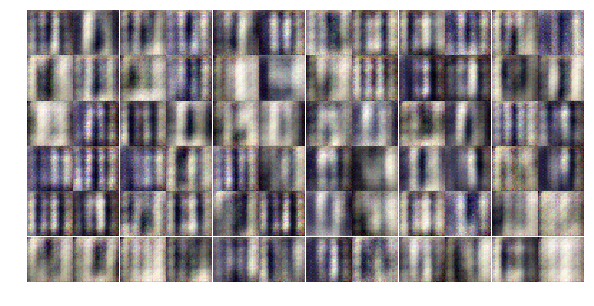

Epoch 1/25... Discriminator Loss: 0.8428... Generator Loss: 1.0444
Epoch 1/25... Discriminator Loss: 0.4189... Generator Loss: 1.5290
Epoch 1/25... Discriminator Loss: 0.4847... Generator Loss: 1.3910
Epoch 1/25... Discriminator Loss: 0.6069... Generator Loss: 1.8472
Epoch 1/25... Discriminator Loss: 0.6182... Generator Loss: 1.7428
Epoch 1/25... Discriminator Loss: 0.3819... Generator Loss: 1.9421
Epoch 1/25... Discriminator Loss: 0.2756... Generator Loss: 2.2589
Epoch 1/25... Discriminator Loss: 0.5103... Generator Loss: 3.0023
Epoch 1/25... Discriminator Loss: 0.4553... Generator Loss: 2.6518
Epoch 1/25... Discriminator Loss: 0.2370... Generator Loss: 2.8740


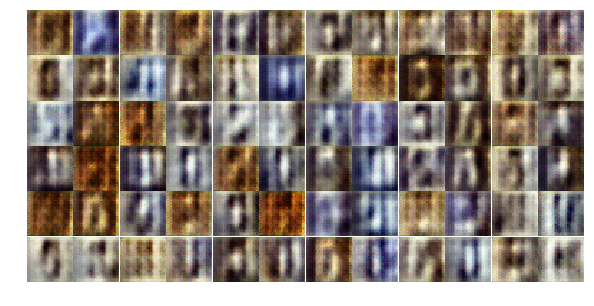

Epoch 1/25... Discriminator Loss: 0.1707... Generator Loss: 3.3053
Epoch 1/25... Discriminator Loss: 0.2805... Generator Loss: 2.2901
Epoch 1/25... Discriminator Loss: 0.1905... Generator Loss: 3.2710
Epoch 1/25... Discriminator Loss: 0.7130... Generator Loss: 2.5219
Epoch 1/25... Discriminator Loss: 1.7437... Generator Loss: 0.2948
Epoch 1/25... Discriminator Loss: 1.0160... Generator Loss: 2.4739
Epoch 1/25... Discriminator Loss: 0.3445... Generator Loss: 2.5980
Epoch 1/25... Discriminator Loss: 0.6317... Generator Loss: 1.7654
Epoch 1/25... Discriminator Loss: 0.5352... Generator Loss: 1.6302
Epoch 1/25... Discriminator Loss: 0.7348... Generator Loss: 1.2022


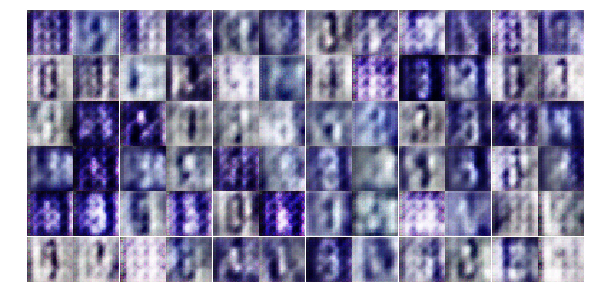

Epoch 1/25... Discriminator Loss: 0.7525... Generator Loss: 1.4242
Epoch 1/25... Discriminator Loss: 0.9716... Generator Loss: 0.7459
Epoch 1/25... Discriminator Loss: 0.6961... Generator Loss: 1.3198
Epoch 1/25... Discriminator Loss: 0.8486... Generator Loss: 0.8827
Epoch 1/25... Discriminator Loss: 0.5694... Generator Loss: 1.6106
Epoch 1/25... Discriminator Loss: 1.0807... Generator Loss: 0.8388
Epoch 1/25... Discriminator Loss: 0.9273... Generator Loss: 1.4304
Epoch 2/25... Discriminator Loss: 0.7802... Generator Loss: 1.2932
Epoch 2/25... Discriminator Loss: 0.6107... Generator Loss: 2.0710
Epoch 2/25... Discriminator Loss: 0.8280... Generator Loss: 1.1563


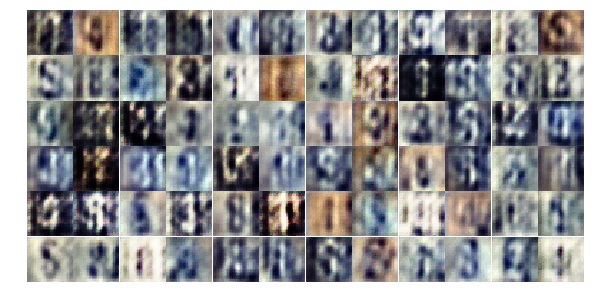

Epoch 2/25... Discriminator Loss: 1.0769... Generator Loss: 1.3484
Epoch 2/25... Discriminator Loss: 0.8342... Generator Loss: 1.4244
Epoch 2/25... Discriminator Loss: 1.3538... Generator Loss: 1.2010
Epoch 2/25... Discriminator Loss: 1.0696... Generator Loss: 1.0226
Epoch 2/25... Discriminator Loss: 1.2690... Generator Loss: 1.0672
Epoch 2/25... Discriminator Loss: 1.1114... Generator Loss: 0.8254
Epoch 2/25... Discriminator Loss: 1.0839... Generator Loss: 0.9818
Epoch 2/25... Discriminator Loss: 0.8891... Generator Loss: 1.0524
Epoch 2/25... Discriminator Loss: 0.6917... Generator Loss: 1.2527
Epoch 2/25... Discriminator Loss: 0.9155... Generator Loss: 1.3046


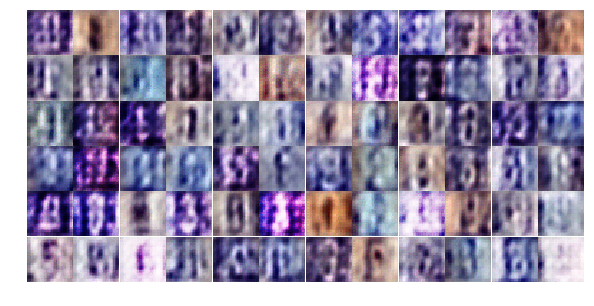

Epoch 2/25... Discriminator Loss: 1.1417... Generator Loss: 1.5405
Epoch 2/25... Discriminator Loss: 1.2087... Generator Loss: 1.1364
Epoch 2/25... Discriminator Loss: 0.8301... Generator Loss: 1.1141
Epoch 2/25... Discriminator Loss: 0.7246... Generator Loss: 1.3518
Epoch 2/25... Discriminator Loss: 0.8253... Generator Loss: 1.3137
Epoch 2/25... Discriminator Loss: 1.0007... Generator Loss: 1.2301
Epoch 2/25... Discriminator Loss: 1.5211... Generator Loss: 0.4766
Epoch 2/25... Discriminator Loss: 0.9561... Generator Loss: 0.8842
Epoch 2/25... Discriminator Loss: 1.5601... Generator Loss: 0.5111
Epoch 2/25... Discriminator Loss: 1.1806... Generator Loss: 0.8822


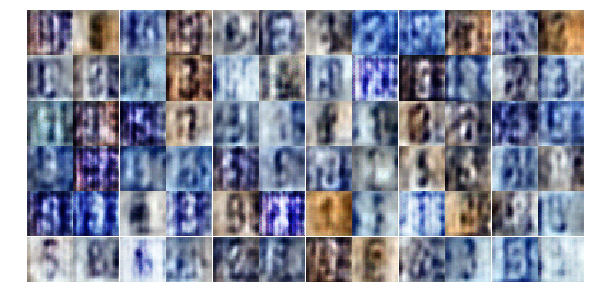

Epoch 2/25... Discriminator Loss: 1.0713... Generator Loss: 0.9274
Epoch 2/25... Discriminator Loss: 1.2678... Generator Loss: 0.9971
Epoch 2/25... Discriminator Loss: 1.2339... Generator Loss: 1.2516
Epoch 2/25... Discriminator Loss: 0.9465... Generator Loss: 0.8211
Epoch 2/25... Discriminator Loss: 1.1035... Generator Loss: 0.8313
Epoch 2/25... Discriminator Loss: 1.0087... Generator Loss: 1.3381
Epoch 2/25... Discriminator Loss: 0.8284... Generator Loss: 1.1768
Epoch 2/25... Discriminator Loss: 1.4067... Generator Loss: 0.6518
Epoch 2/25... Discriminator Loss: 1.2353... Generator Loss: 0.9699
Epoch 2/25... Discriminator Loss: 0.8923... Generator Loss: 1.2379


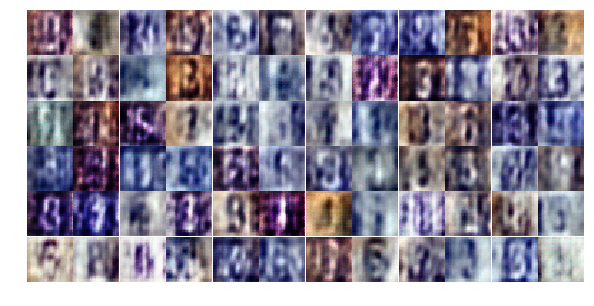

Epoch 2/25... Discriminator Loss: 0.9961... Generator Loss: 0.9318
Epoch 2/25... Discriminator Loss: 1.2156... Generator Loss: 0.5541
Epoch 2/25... Discriminator Loss: 1.1596... Generator Loss: 0.6860
Epoch 2/25... Discriminator Loss: 1.3906... Generator Loss: 0.6435
Epoch 2/25... Discriminator Loss: 1.0087... Generator Loss: 1.0433
Epoch 2/25... Discriminator Loss: 0.9885... Generator Loss: 1.0629
Epoch 2/25... Discriminator Loss: 1.0499... Generator Loss: 0.8820
Epoch 2/25... Discriminator Loss: 1.1481... Generator Loss: 1.0401
Epoch 2/25... Discriminator Loss: 1.2323... Generator Loss: 1.0320
Epoch 2/25... Discriminator Loss: 1.2269... Generator Loss: 0.7693


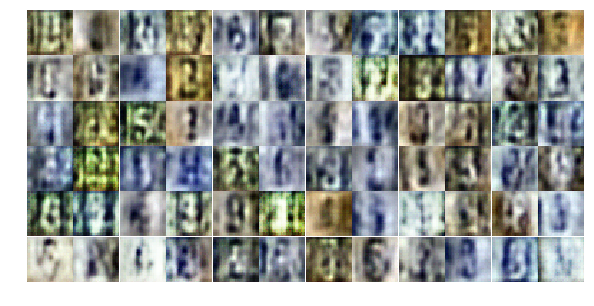

Epoch 2/25... Discriminator Loss: 0.9679... Generator Loss: 1.2388
Epoch 2/25... Discriminator Loss: 1.0578... Generator Loss: 0.8393
Epoch 2/25... Discriminator Loss: 1.0423... Generator Loss: 0.6547
Epoch 2/25... Discriminator Loss: 0.9559... Generator Loss: 1.0175
Epoch 2/25... Discriminator Loss: 1.3421... Generator Loss: 0.6541
Epoch 2/25... Discriminator Loss: 1.1387... Generator Loss: 0.9426
Epoch 2/25... Discriminator Loss: 1.0241... Generator Loss: 1.1000
Epoch 2/25... Discriminator Loss: 0.8972... Generator Loss: 1.1530
Epoch 2/25... Discriminator Loss: 0.9499... Generator Loss: 1.0818
Epoch 2/25... Discriminator Loss: 1.0889... Generator Loss: 1.0162


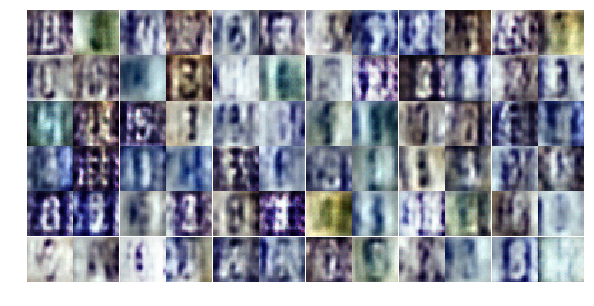

Epoch 2/25... Discriminator Loss: 1.0768... Generator Loss: 0.8432
Epoch 2/25... Discriminator Loss: 1.0281... Generator Loss: 0.9269
Epoch 2/25... Discriminator Loss: 1.2750... Generator Loss: 0.6059
Epoch 2/25... Discriminator Loss: 1.0328... Generator Loss: 0.8324
Epoch 3/25... Discriminator Loss: 0.9893... Generator Loss: 2.1332
Epoch 3/25... Discriminator Loss: 0.7017... Generator Loss: 1.3269
Epoch 3/25... Discriminator Loss: 0.8960... Generator Loss: 1.1814
Epoch 3/25... Discriminator Loss: 0.9211... Generator Loss: 0.9323
Epoch 3/25... Discriminator Loss: 0.7003... Generator Loss: 1.1817
Epoch 3/25... Discriminator Loss: 1.0042... Generator Loss: 1.1227


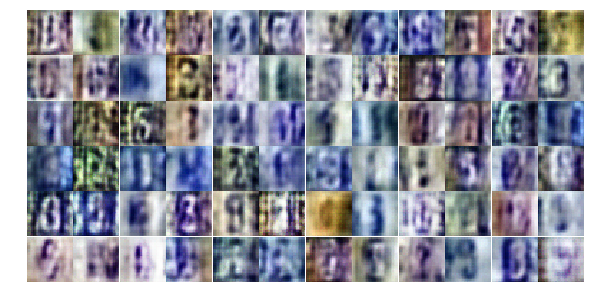

Epoch 3/25... Discriminator Loss: 0.8539... Generator Loss: 1.1146
Epoch 3/25... Discriminator Loss: 1.0803... Generator Loss: 0.7663
Epoch 3/25... Discriminator Loss: 1.0693... Generator Loss: 0.6982
Epoch 3/25... Discriminator Loss: 0.8477... Generator Loss: 1.2688
Epoch 3/25... Discriminator Loss: 0.6962... Generator Loss: 1.4681
Epoch 3/25... Discriminator Loss: 1.0091... Generator Loss: 0.9047
Epoch 3/25... Discriminator Loss: 0.6632... Generator Loss: 1.4458
Epoch 3/25... Discriminator Loss: 0.9853... Generator Loss: 0.6912
Epoch 3/25... Discriminator Loss: 0.9191... Generator Loss: 0.8481
Epoch 3/25... Discriminator Loss: 0.7279... Generator Loss: 1.1173


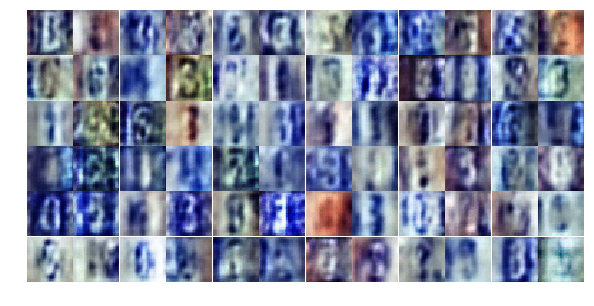

Epoch 3/25... Discriminator Loss: 0.6698... Generator Loss: 1.3644
Epoch 3/25... Discriminator Loss: 0.4637... Generator Loss: 1.7848
Epoch 3/25... Discriminator Loss: 0.6135... Generator Loss: 1.2570
Epoch 3/25... Discriminator Loss: 0.9554... Generator Loss: 1.0092
Epoch 3/25... Discriminator Loss: 1.1129... Generator Loss: 0.7457
Epoch 3/25... Discriminator Loss: 0.5152... Generator Loss: 1.7428
Epoch 3/25... Discriminator Loss: 0.6954... Generator Loss: 1.1501
Epoch 3/25... Discriminator Loss: 0.8713... Generator Loss: 1.2278
Epoch 3/25... Discriminator Loss: 0.7641... Generator Loss: 1.0794
Epoch 3/25... Discriminator Loss: 0.9416... Generator Loss: 1.1102


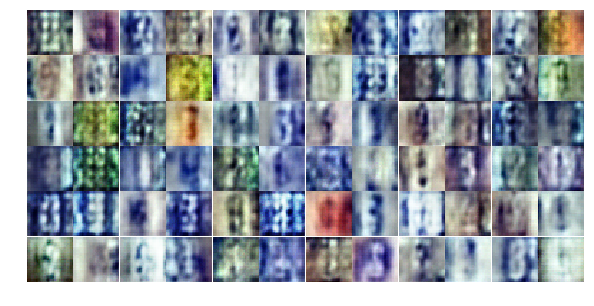

Epoch 3/25... Discriminator Loss: 0.8920... Generator Loss: 1.8683
Epoch 3/25... Discriminator Loss: 0.8281... Generator Loss: 1.0620
Epoch 3/25... Discriminator Loss: 0.7796... Generator Loss: 1.1302
Epoch 3/25... Discriminator Loss: 0.7626... Generator Loss: 1.1528
Epoch 3/25... Discriminator Loss: 0.9898... Generator Loss: 0.9360
Epoch 3/25... Discriminator Loss: 0.6264... Generator Loss: 1.2438
Epoch 3/25... Discriminator Loss: 0.9370... Generator Loss: 0.9756
Epoch 3/25... Discriminator Loss: 0.9141... Generator Loss: 1.5764
Epoch 3/25... Discriminator Loss: 0.7170... Generator Loss: 1.3423
Epoch 3/25... Discriminator Loss: 0.7121... Generator Loss: 1.1751


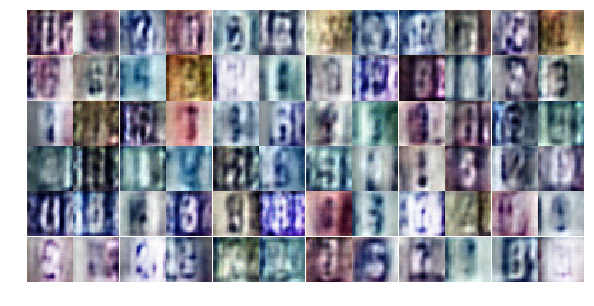

Epoch 3/25... Discriminator Loss: 0.8645... Generator Loss: 1.1149
Epoch 3/25... Discriminator Loss: 0.5821... Generator Loss: 1.7541
Epoch 3/25... Discriminator Loss: 0.6646... Generator Loss: 1.7061
Epoch 3/25... Discriminator Loss: 0.6530... Generator Loss: 1.2250
Epoch 3/25... Discriminator Loss: 0.7507... Generator Loss: 1.7045
Epoch 3/25... Discriminator Loss: 0.6760... Generator Loss: 1.5206
Epoch 3/25... Discriminator Loss: 0.7138... Generator Loss: 1.6756
Epoch 3/25... Discriminator Loss: 0.5317... Generator Loss: 1.7330
Epoch 3/25... Discriminator Loss: 1.1116... Generator Loss: 2.7127
Epoch 3/25... Discriminator Loss: 0.7763... Generator Loss: 1.4738


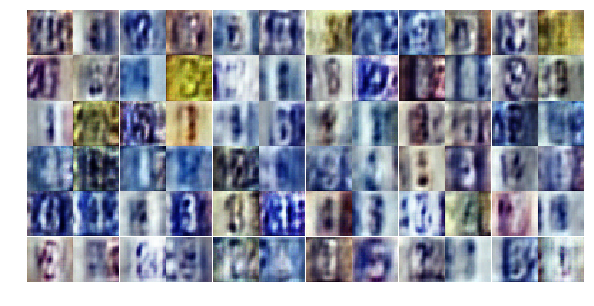

Epoch 3/25... Discriminator Loss: 0.8858... Generator Loss: 0.8693
Epoch 3/25... Discriminator Loss: 0.8771... Generator Loss: 0.8640
Epoch 3/25... Discriminator Loss: 0.6408... Generator Loss: 1.5062
Epoch 3/25... Discriminator Loss: 0.6571... Generator Loss: 1.4414
Epoch 3/25... Discriminator Loss: 0.5531... Generator Loss: 1.6882
Epoch 3/25... Discriminator Loss: 0.6534... Generator Loss: 1.1938
Epoch 3/25... Discriminator Loss: 0.5394... Generator Loss: 1.6890
Epoch 3/25... Discriminator Loss: 0.8680... Generator Loss: 1.3413
Epoch 3/25... Discriminator Loss: 0.7678... Generator Loss: 1.0311
Epoch 3/25... Discriminator Loss: 0.5998... Generator Loss: 1.4338


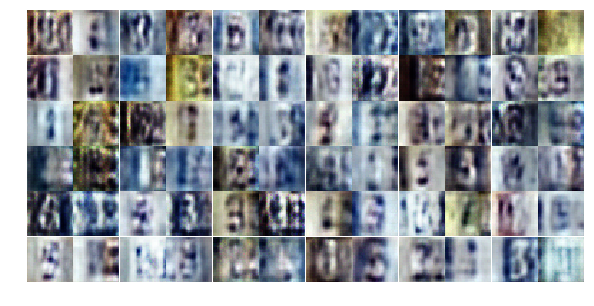

Epoch 3/25... Discriminator Loss: 1.5306... Generator Loss: 0.3839
Epoch 4/25... Discriminator Loss: 0.7824... Generator Loss: 1.1055
Epoch 4/25... Discriminator Loss: 0.9132... Generator Loss: 0.7502
Epoch 4/25... Discriminator Loss: 0.4841... Generator Loss: 1.5056
Epoch 4/25... Discriminator Loss: 0.7800... Generator Loss: 0.9581
Epoch 4/25... Discriminator Loss: 0.5418... Generator Loss: 1.6463
Epoch 4/25... Discriminator Loss: 1.1731... Generator Loss: 2.2448
Epoch 4/25... Discriminator Loss: 0.6434... Generator Loss: 1.1767
Epoch 4/25... Discriminator Loss: 0.4467... Generator Loss: 1.7011
Epoch 4/25... Discriminator Loss: 0.4997... Generator Loss: 1.4440


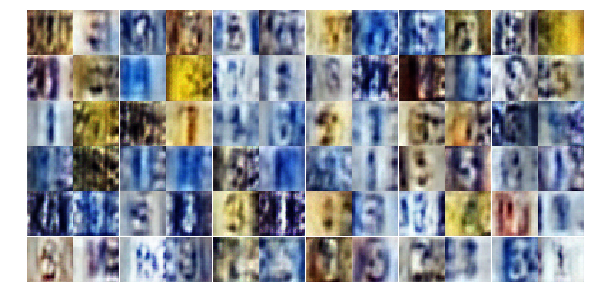

Epoch 4/25... Discriminator Loss: 0.5164... Generator Loss: 1.3770
Epoch 4/25... Discriminator Loss: 0.8988... Generator Loss: 2.9184
Epoch 4/25... Discriminator Loss: 1.1373... Generator Loss: 0.6425
Epoch 4/25... Discriminator Loss: 0.4840... Generator Loss: 2.0466
Epoch 4/25... Discriminator Loss: 0.9665... Generator Loss: 0.7796
Epoch 4/25... Discriminator Loss: 0.8158... Generator Loss: 0.8675
Epoch 4/25... Discriminator Loss: 1.5539... Generator Loss: 0.3241
Epoch 4/25... Discriminator Loss: 0.5316... Generator Loss: 1.6732
Epoch 4/25... Discriminator Loss: 0.7781... Generator Loss: 1.0084
Epoch 4/25... Discriminator Loss: 0.5947... Generator Loss: 1.6178


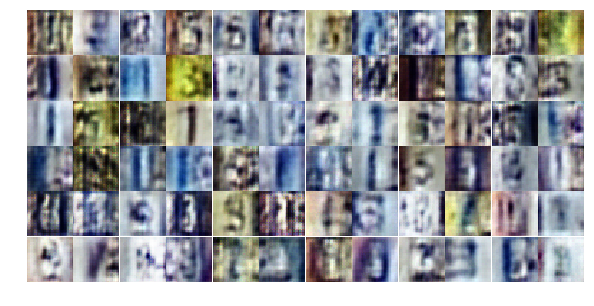

Epoch 4/25... Discriminator Loss: 0.9309... Generator Loss: 0.7941
Epoch 4/25... Discriminator Loss: 0.4396... Generator Loss: 1.6202
Epoch 4/25... Discriminator Loss: 0.4618... Generator Loss: 1.3862
Epoch 4/25... Discriminator Loss: 0.3787... Generator Loss: 2.0527
Epoch 4/25... Discriminator Loss: 0.4168... Generator Loss: 1.7908
Epoch 4/25... Discriminator Loss: 0.4415... Generator Loss: 1.9899
Epoch 4/25... Discriminator Loss: 0.6911... Generator Loss: 1.0530
Epoch 4/25... Discriminator Loss: 0.5926... Generator Loss: 1.3115
Epoch 4/25... Discriminator Loss: 0.7835... Generator Loss: 1.2246
Epoch 4/25... Discriminator Loss: 0.4767... Generator Loss: 1.6217


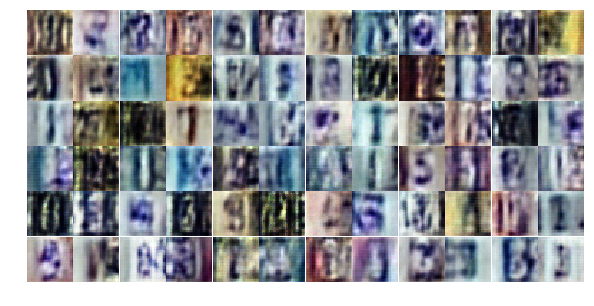

Epoch 4/25... Discriminator Loss: 0.6687... Generator Loss: 1.8063
Epoch 4/25... Discriminator Loss: 0.9969... Generator Loss: 2.5627
Epoch 4/25... Discriminator Loss: 0.5025... Generator Loss: 1.6514
Epoch 4/25... Discriminator Loss: 0.5622... Generator Loss: 1.5898
Epoch 4/25... Discriminator Loss: 0.3885... Generator Loss: 2.1405
Epoch 4/25... Discriminator Loss: 0.3774... Generator Loss: 2.0098
Epoch 4/25... Discriminator Loss: 0.6448... Generator Loss: 1.9880
Epoch 4/25... Discriminator Loss: 0.5775... Generator Loss: 1.8088
Epoch 4/25... Discriminator Loss: 0.4217... Generator Loss: 1.7392
Epoch 4/25... Discriminator Loss: 0.5536... Generator Loss: 1.2986


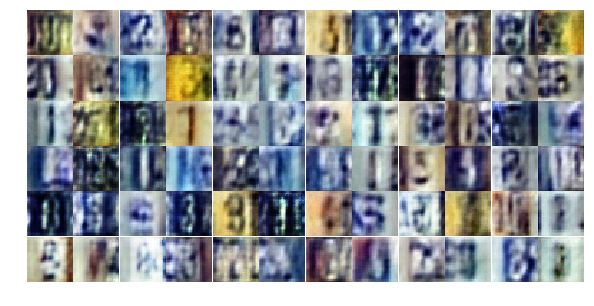

Epoch 4/25... Discriminator Loss: 0.6213... Generator Loss: 1.0868
Epoch 4/25... Discriminator Loss: 0.6512... Generator Loss: 0.9712
Epoch 4/25... Discriminator Loss: 0.5162... Generator Loss: 1.3438
Epoch 4/25... Discriminator Loss: 0.3329... Generator Loss: 2.3372
Epoch 4/25... Discriminator Loss: 0.4412... Generator Loss: 1.9640
Epoch 4/25... Discriminator Loss: 0.6155... Generator Loss: 2.8942
Epoch 4/25... Discriminator Loss: 0.6155... Generator Loss: 1.3369
Epoch 4/25... Discriminator Loss: 0.5364... Generator Loss: 1.3632
Epoch 4/25... Discriminator Loss: 0.4140... Generator Loss: 1.7279
Epoch 4/25... Discriminator Loss: 0.4190... Generator Loss: 1.9611


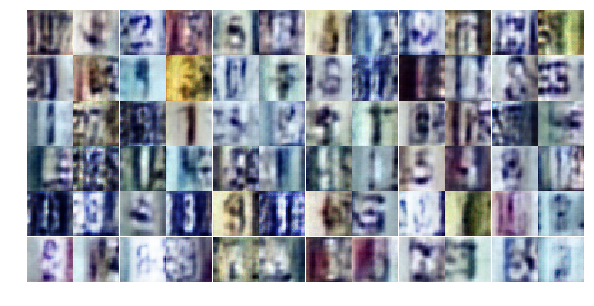

Epoch 4/25... Discriminator Loss: 0.5307... Generator Loss: 1.3312
Epoch 4/25... Discriminator Loss: 0.2742... Generator Loss: 2.1027
Epoch 4/25... Discriminator Loss: 0.4106... Generator Loss: 1.5843
Epoch 4/25... Discriminator Loss: 0.5275... Generator Loss: 1.9803
Epoch 4/25... Discriminator Loss: 0.9513... Generator Loss: 0.7893
Epoch 4/25... Discriminator Loss: 0.7909... Generator Loss: 3.2062
Epoch 4/25... Discriminator Loss: 0.3325... Generator Loss: 1.8791
Epoch 4/25... Discriminator Loss: 0.8356... Generator Loss: 0.8330
Epoch 4/25... Discriminator Loss: 0.4170... Generator Loss: 1.8031
Epoch 5/25... Discriminator Loss: 0.4567... Generator Loss: 1.4533


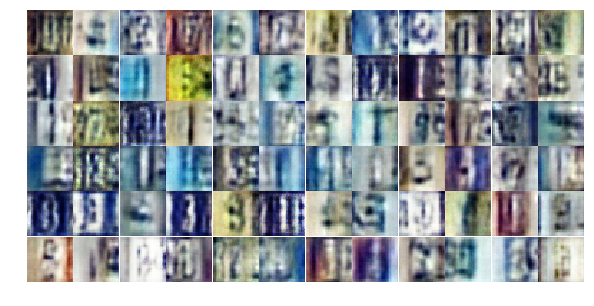

Epoch 5/25... Discriminator Loss: 0.3612... Generator Loss: 1.9133
Epoch 5/25... Discriminator Loss: 0.3196... Generator Loss: 1.8902
Epoch 5/25... Discriminator Loss: 0.4256... Generator Loss: 1.5872
Epoch 5/25... Discriminator Loss: 0.3577... Generator Loss: 1.5618
Epoch 5/25... Discriminator Loss: 0.8482... Generator Loss: 3.7521
Epoch 5/25... Discriminator Loss: 0.8972... Generator Loss: 0.7087
Epoch 5/25... Discriminator Loss: 1.1077... Generator Loss: 2.0390
Epoch 5/25... Discriminator Loss: 0.4700... Generator Loss: 1.4463
Epoch 5/25... Discriminator Loss: 0.7609... Generator Loss: 0.8726
Epoch 5/25... Discriminator Loss: 0.6884... Generator Loss: 1.2656


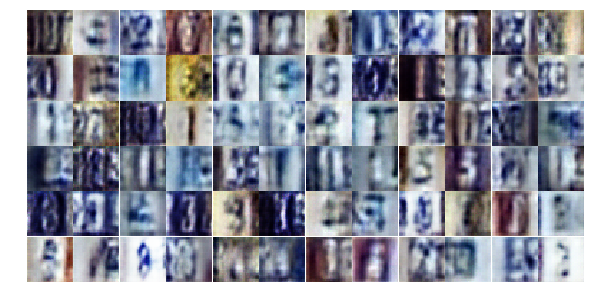

Epoch 5/25... Discriminator Loss: 0.6287... Generator Loss: 1.1758
Epoch 5/25... Discriminator Loss: 0.3921... Generator Loss: 1.6980
Epoch 5/25... Discriminator Loss: 0.4051... Generator Loss: 1.5591
Epoch 5/25... Discriminator Loss: 0.6238... Generator Loss: 1.3360
Epoch 5/25... Discriminator Loss: 0.6287... Generator Loss: 2.3700
Epoch 5/25... Discriminator Loss: 1.0900... Generator Loss: 2.5580
Epoch 5/25... Discriminator Loss: 0.5211... Generator Loss: 1.6460
Epoch 5/25... Discriminator Loss: 0.4094... Generator Loss: 2.1732
Epoch 5/25... Discriminator Loss: 0.3645... Generator Loss: 2.4129
Epoch 5/25... Discriminator Loss: 0.6364... Generator Loss: 1.0773


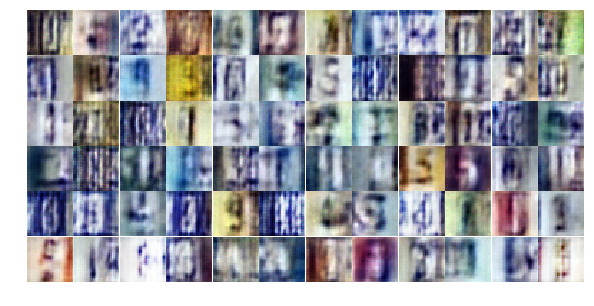

Epoch 5/25... Discriminator Loss: 0.3524... Generator Loss: 1.9075
Epoch 5/25... Discriminator Loss: 1.5599... Generator Loss: 0.3595
Epoch 5/25... Discriminator Loss: 0.8497... Generator Loss: 0.8036
Epoch 5/25... Discriminator Loss: 0.5945... Generator Loss: 1.2264
Epoch 5/25... Discriminator Loss: 0.7164... Generator Loss: 0.9670
Epoch 5/25... Discriminator Loss: 0.7653... Generator Loss: 0.9212
Epoch 5/25... Discriminator Loss: 0.5169... Generator Loss: 1.2722
Epoch 5/25... Discriminator Loss: 0.5167... Generator Loss: 1.3924
Epoch 5/25... Discriminator Loss: 0.6590... Generator Loss: 0.9904
Epoch 5/25... Discriminator Loss: 0.4476... Generator Loss: 1.3857


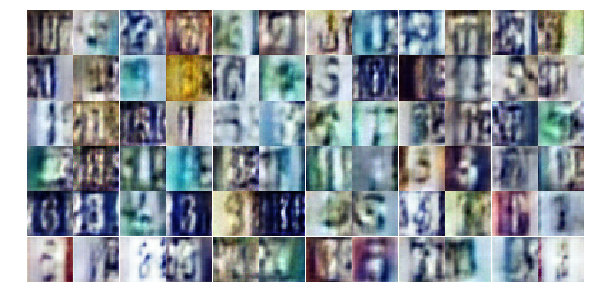

Epoch 5/25... Discriminator Loss: 0.6138... Generator Loss: 1.5357
Epoch 5/25... Discriminator Loss: 0.4235... Generator Loss: 1.6497
Epoch 5/25... Discriminator Loss: 0.4752... Generator Loss: 1.4314
Epoch 5/25... Discriminator Loss: 0.4578... Generator Loss: 2.0359
Epoch 5/25... Discriminator Loss: 1.6540... Generator Loss: 3.3655
Epoch 5/25... Discriminator Loss: 0.4916... Generator Loss: 1.7568
Epoch 5/25... Discriminator Loss: 0.6290... Generator Loss: 1.5696
Epoch 5/25... Discriminator Loss: 0.7890... Generator Loss: 0.8601
Epoch 5/25... Discriminator Loss: 1.1651... Generator Loss: 0.4955
Epoch 5/25... Discriminator Loss: 0.4194... Generator Loss: 1.6975


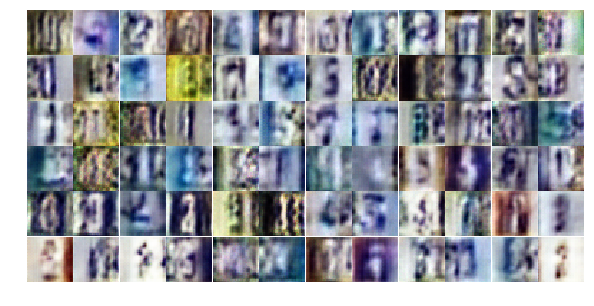

Epoch 5/25... Discriminator Loss: 0.3532... Generator Loss: 2.1534
Epoch 5/25... Discriminator Loss: 0.3413... Generator Loss: 1.6422
Epoch 5/25... Discriminator Loss: 1.2269... Generator Loss: 0.4646
Epoch 5/25... Discriminator Loss: 0.5664... Generator Loss: 1.6579
Epoch 5/25... Discriminator Loss: 1.6017... Generator Loss: 2.9654
Epoch 5/25... Discriminator Loss: 1.0222... Generator Loss: 0.6828
Epoch 5/25... Discriminator Loss: 0.6273... Generator Loss: 1.7795
Epoch 5/25... Discriminator Loss: 0.6087... Generator Loss: 1.0978
Epoch 5/25... Discriminator Loss: 0.4690... Generator Loss: 1.4784
Epoch 5/25... Discriminator Loss: 0.5131... Generator Loss: 1.8095


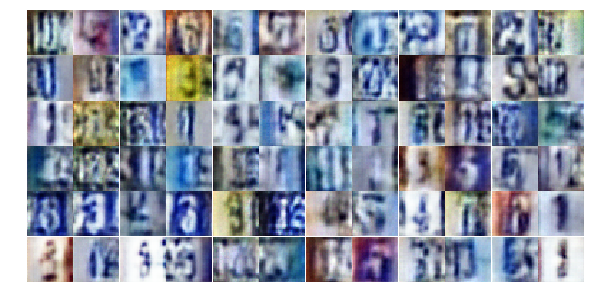

Epoch 5/25... Discriminator Loss: 0.8254... Generator Loss: 0.9471
Epoch 5/25... Discriminator Loss: 0.5775... Generator Loss: 1.1748
Epoch 5/25... Discriminator Loss: 0.8937... Generator Loss: 0.7370
Epoch 5/25... Discriminator Loss: 0.5777... Generator Loss: 1.3184
Epoch 5/25... Discriminator Loss: 0.4071... Generator Loss: 1.8157
Epoch 5/25... Discriminator Loss: 0.5493... Generator Loss: 1.2222
Epoch 6/25... Discriminator Loss: 0.5980... Generator Loss: 1.1296
Epoch 6/25... Discriminator Loss: 0.5144... Generator Loss: 1.2648
Epoch 6/25... Discriminator Loss: 0.5508... Generator Loss: 1.3022
Epoch 6/25... Discriminator Loss: 0.8597... Generator Loss: 0.7089


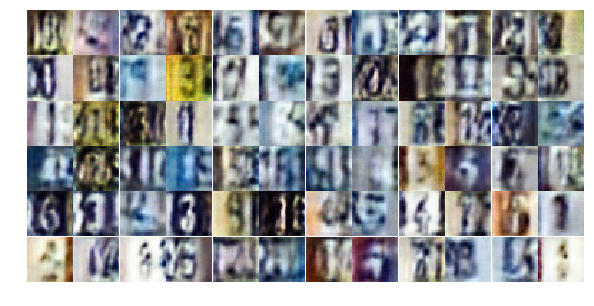

Epoch 6/25... Discriminator Loss: 1.4474... Generator Loss: 0.3953
Epoch 6/25... Discriminator Loss: 0.8295... Generator Loss: 0.7643
Epoch 6/25... Discriminator Loss: 0.6080... Generator Loss: 1.2711
Epoch 6/25... Discriminator Loss: 0.6304... Generator Loss: 1.1725
Epoch 6/25... Discriminator Loss: 1.1589... Generator Loss: 0.5131
Epoch 6/25... Discriminator Loss: 0.7825... Generator Loss: 0.9142
Epoch 6/25... Discriminator Loss: 0.5404... Generator Loss: 1.9296
Epoch 6/25... Discriminator Loss: 0.8427... Generator Loss: 0.9941
Epoch 6/25... Discriminator Loss: 0.4594... Generator Loss: 1.5391
Epoch 6/25... Discriminator Loss: 0.5035... Generator Loss: 1.5770


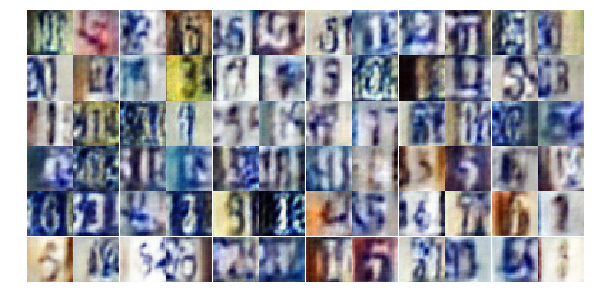

Epoch 6/25... Discriminator Loss: 0.4183... Generator Loss: 1.7971
Epoch 6/25... Discriminator Loss: 1.6788... Generator Loss: 3.5757
Epoch 6/25... Discriminator Loss: 1.0883... Generator Loss: 0.6123
Epoch 6/25... Discriminator Loss: 0.3849... Generator Loss: 1.9436
Epoch 6/25... Discriminator Loss: 0.3662... Generator Loss: 1.8331
Epoch 6/25... Discriminator Loss: 0.4791... Generator Loss: 1.2500
Epoch 6/25... Discriminator Loss: 1.0481... Generator Loss: 0.6036
Epoch 6/25... Discriminator Loss: 0.7112... Generator Loss: 2.4235
Epoch 6/25... Discriminator Loss: 0.5254... Generator Loss: 1.7683
Epoch 6/25... Discriminator Loss: 0.7359... Generator Loss: 0.9657


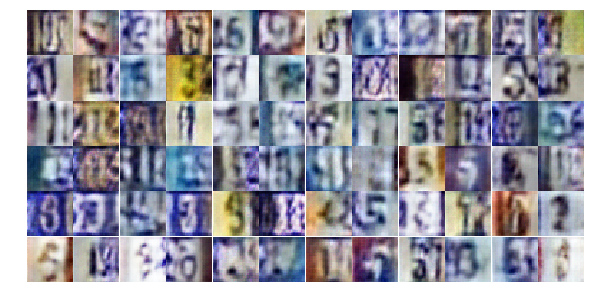

Epoch 6/25... Discriminator Loss: 0.7450... Generator Loss: 0.8762
Epoch 6/25... Discriminator Loss: 0.6604... Generator Loss: 1.5392
Epoch 6/25... Discriminator Loss: 1.1095... Generator Loss: 0.5281
Epoch 6/25... Discriminator Loss: 0.5629... Generator Loss: 1.2953
Epoch 6/25... Discriminator Loss: 0.4291... Generator Loss: 2.3165
Epoch 6/25... Discriminator Loss: 2.1362... Generator Loss: 0.1825
Epoch 6/25... Discriminator Loss: 1.0252... Generator Loss: 0.5979
Epoch 6/25... Discriminator Loss: 0.3599... Generator Loss: 1.8162
Epoch 6/25... Discriminator Loss: 0.4873... Generator Loss: 1.5948
Epoch 6/25... Discriminator Loss: 0.4568... Generator Loss: 1.7863


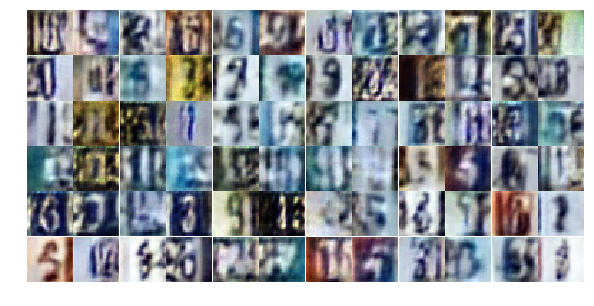

Epoch 6/25... Discriminator Loss: 0.5498... Generator Loss: 1.3262
Epoch 6/25... Discriminator Loss: 0.6482... Generator Loss: 1.2543
Epoch 6/25... Discriminator Loss: 0.6430... Generator Loss: 1.1429
Epoch 6/25... Discriminator Loss: 0.4433... Generator Loss: 1.6918
Epoch 6/25... Discriminator Loss: 0.4829... Generator Loss: 1.8431
Epoch 6/25... Discriminator Loss: 0.5997... Generator Loss: 1.2331
Epoch 6/25... Discriminator Loss: 0.5168... Generator Loss: 1.4646
Epoch 6/25... Discriminator Loss: 0.6528... Generator Loss: 1.7315
Epoch 6/25... Discriminator Loss: 0.4489... Generator Loss: 1.6833
Epoch 6/25... Discriminator Loss: 0.5696... Generator Loss: 1.1490


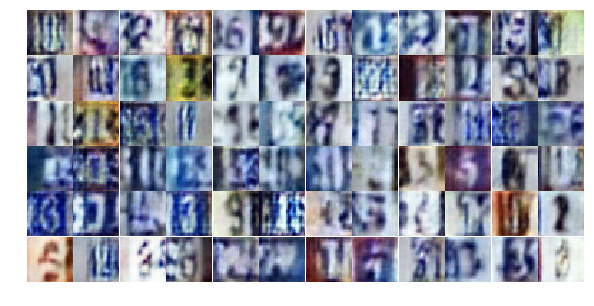

Epoch 6/25... Discriminator Loss: 1.7039... Generator Loss: 4.3581
Epoch 6/25... Discriminator Loss: 0.8546... Generator Loss: 2.2286
Epoch 6/25... Discriminator Loss: 1.0346... Generator Loss: 0.6445
Epoch 6/25... Discriminator Loss: 0.5772... Generator Loss: 1.1762
Epoch 6/25... Discriminator Loss: 0.4021... Generator Loss: 1.5188
Epoch 6/25... Discriminator Loss: 0.4524... Generator Loss: 1.7949
Epoch 6/25... Discriminator Loss: 1.0275... Generator Loss: 0.6268
Epoch 6/25... Discriminator Loss: 1.1133... Generator Loss: 0.5119
Epoch 6/25... Discriminator Loss: 0.7052... Generator Loss: 1.0703
Epoch 6/25... Discriminator Loss: 0.6641... Generator Loss: 1.0198


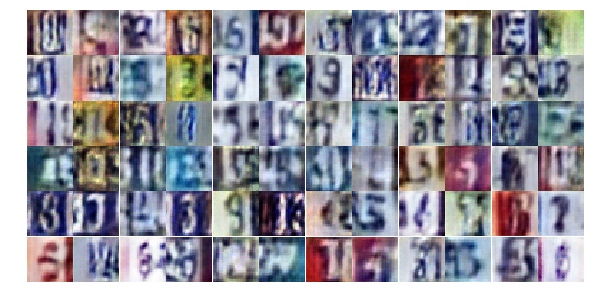

Epoch 6/25... Discriminator Loss: 0.4876... Generator Loss: 1.4088
Epoch 6/25... Discriminator Loss: 1.0337... Generator Loss: 0.5703
Epoch 6/25... Discriminator Loss: 0.4653... Generator Loss: 2.0811
Epoch 7/25... Discriminator Loss: 0.6027... Generator Loss: 1.7716
Epoch 7/25... Discriminator Loss: 0.5501... Generator Loss: 1.4459
Epoch 7/25... Discriminator Loss: 0.3426... Generator Loss: 1.9834
Epoch 7/25... Discriminator Loss: 0.5733... Generator Loss: 1.1038
Epoch 7/25... Discriminator Loss: 0.6306... Generator Loss: 1.0617
Epoch 7/25... Discriminator Loss: 0.7833... Generator Loss: 3.3064
Epoch 7/25... Discriminator Loss: 0.6857... Generator Loss: 1.4956


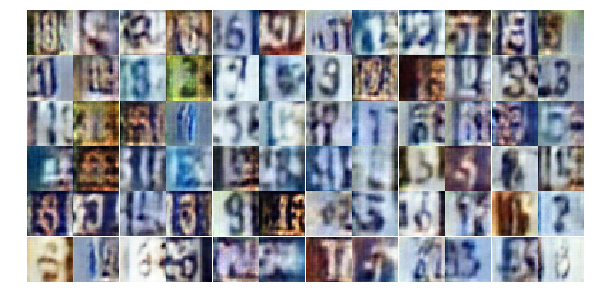

Epoch 7/25... Discriminator Loss: 0.6370... Generator Loss: 1.6653
Epoch 7/25... Discriminator Loss: 1.0329... Generator Loss: 0.6058
Epoch 7/25... Discriminator Loss: 0.8781... Generator Loss: 0.7890
Epoch 7/25... Discriminator Loss: 0.5874... Generator Loss: 1.2674
Epoch 7/25... Discriminator Loss: 0.4551... Generator Loss: 1.4898
Epoch 7/25... Discriminator Loss: 0.4510... Generator Loss: 1.5281
Epoch 7/25... Discriminator Loss: 0.6724... Generator Loss: 2.2472
Epoch 7/25... Discriminator Loss: 0.7633... Generator Loss: 2.8014
Epoch 7/25... Discriminator Loss: 1.3428... Generator Loss: 3.8455
Epoch 7/25... Discriminator Loss: 0.8145... Generator Loss: 0.8219


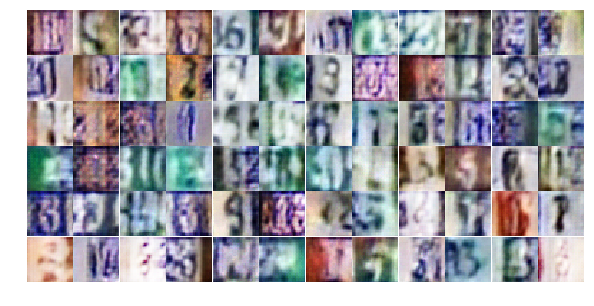

Epoch 7/25... Discriminator Loss: 0.5013... Generator Loss: 1.5707
Epoch 7/25... Discriminator Loss: 0.8259... Generator Loss: 0.8385
Epoch 7/25... Discriminator Loss: 0.7250... Generator Loss: 2.3282
Epoch 7/25... Discriminator Loss: 0.8115... Generator Loss: 1.3533
Epoch 7/25... Discriminator Loss: 0.6118... Generator Loss: 1.0903
Epoch 7/25... Discriminator Loss: 0.6575... Generator Loss: 0.9860
Epoch 7/25... Discriminator Loss: 0.6067... Generator Loss: 1.0947
Epoch 7/25... Discriminator Loss: 0.8122... Generator Loss: 0.8501
Epoch 7/25... Discriminator Loss: 0.3916... Generator Loss: 1.7975
Epoch 7/25... Discriminator Loss: 0.4825... Generator Loss: 2.6229


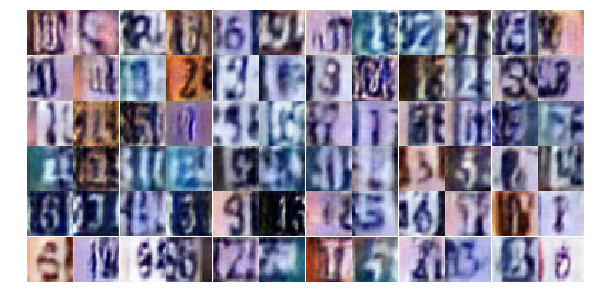

Epoch 7/25... Discriminator Loss: 1.0479... Generator Loss: 0.6238
Epoch 7/25... Discriminator Loss: 1.2035... Generator Loss: 0.5493
Epoch 7/25... Discriminator Loss: 1.3308... Generator Loss: 0.7273
Epoch 7/25... Discriminator Loss: 1.1497... Generator Loss: 0.5361
Epoch 7/25... Discriminator Loss: 0.9626... Generator Loss: 0.7515
Epoch 7/25... Discriminator Loss: 0.9927... Generator Loss: 0.6862
Epoch 7/25... Discriminator Loss: 0.7589... Generator Loss: 0.9425
Epoch 7/25... Discriminator Loss: 0.6335... Generator Loss: 1.2793
Epoch 7/25... Discriminator Loss: 1.1095... Generator Loss: 0.5680
Epoch 7/25... Discriminator Loss: 0.7214... Generator Loss: 1.9814


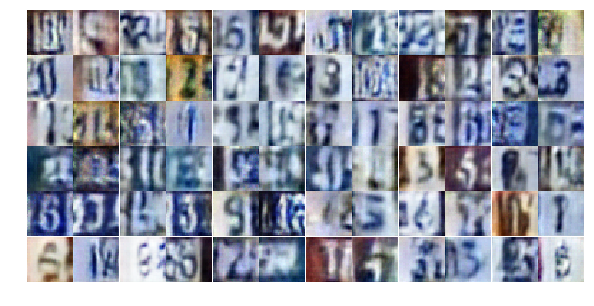

Epoch 7/25... Discriminator Loss: 0.8648... Generator Loss: 1.2528
Epoch 7/25... Discriminator Loss: 0.8043... Generator Loss: 0.9242
Epoch 7/25... Discriminator Loss: 0.4362... Generator Loss: 1.4897
Epoch 7/25... Discriminator Loss: 0.4792... Generator Loss: 1.4085
Epoch 7/25... Discriminator Loss: 0.9556... Generator Loss: 0.7737
Epoch 7/25... Discriminator Loss: 0.4434... Generator Loss: 1.6849
Epoch 7/25... Discriminator Loss: 0.6936... Generator Loss: 1.0362
Epoch 7/25... Discriminator Loss: 0.9244... Generator Loss: 0.9590
Epoch 7/25... Discriminator Loss: 0.5829... Generator Loss: 3.3917
Epoch 7/25... Discriminator Loss: 0.9728... Generator Loss: 0.9488


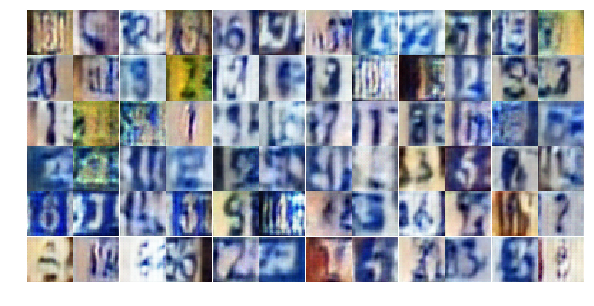

Epoch 7/25... Discriminator Loss: 0.3374... Generator Loss: 2.2045
Epoch 7/25... Discriminator Loss: 0.4957... Generator Loss: 1.5985
Epoch 7/25... Discriminator Loss: 0.6845... Generator Loss: 1.0274
Epoch 7/25... Discriminator Loss: 0.5793... Generator Loss: 1.1590
Epoch 7/25... Discriminator Loss: 0.5360... Generator Loss: 1.7190
Epoch 7/25... Discriminator Loss: 0.5048... Generator Loss: 1.7273
Epoch 7/25... Discriminator Loss: 1.3420... Generator Loss: 0.3831
Epoch 7/25... Discriminator Loss: 0.7808... Generator Loss: 1.3499
Epoch 7/25... Discriminator Loss: 0.8603... Generator Loss: 0.8226
Epoch 7/25... Discriminator Loss: 0.4661... Generator Loss: 1.7901


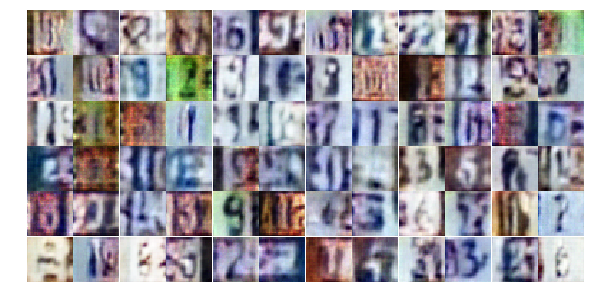

Epoch 7/25... Discriminator Loss: 0.6801... Generator Loss: 1.1568
Epoch 8/25... Discriminator Loss: 0.6005... Generator Loss: 1.3075
Epoch 8/25... Discriminator Loss: 0.8456... Generator Loss: 0.8060
Epoch 8/25... Discriminator Loss: 0.7966... Generator Loss: 0.8232
Epoch 8/25... Discriminator Loss: 0.6893... Generator Loss: 0.9876
Epoch 8/25... Discriminator Loss: 0.7736... Generator Loss: 0.9106
Epoch 8/25... Discriminator Loss: 0.7500... Generator Loss: 1.0124
Epoch 8/25... Discriminator Loss: 0.4374... Generator Loss: 1.7207
Epoch 8/25... Discriminator Loss: 0.8721... Generator Loss: 0.7145
Epoch 8/25... Discriminator Loss: 0.5928... Generator Loss: 1.2531


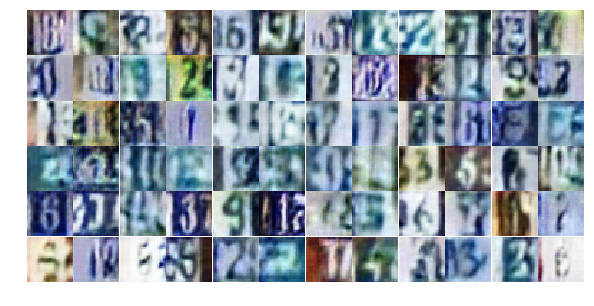

Epoch 8/25... Discriminator Loss: 0.4868... Generator Loss: 1.4317
Epoch 8/25... Discriminator Loss: 0.5021... Generator Loss: 1.6074
Epoch 8/25... Discriminator Loss: 0.9363... Generator Loss: 0.6620
Epoch 8/25... Discriminator Loss: 0.4661... Generator Loss: 2.2345
Epoch 8/25... Discriminator Loss: 0.9029... Generator Loss: 0.7181
Epoch 8/25... Discriminator Loss: 0.8806... Generator Loss: 2.8514
Epoch 8/25... Discriminator Loss: 0.6937... Generator Loss: 1.2223
Epoch 8/25... Discriminator Loss: 0.7134... Generator Loss: 1.1574
Epoch 8/25... Discriminator Loss: 0.6113... Generator Loss: 1.1967
Epoch 8/25... Discriminator Loss: 1.4606... Generator Loss: 0.3683


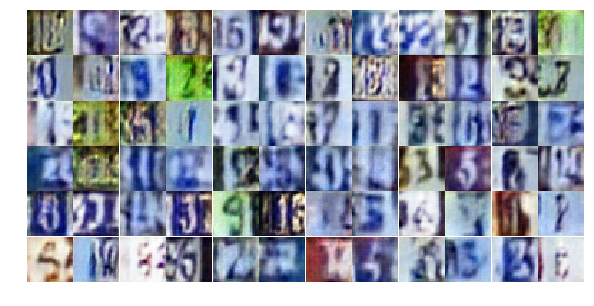

Epoch 8/25... Discriminator Loss: 0.5166... Generator Loss: 1.5791
Epoch 8/25... Discriminator Loss: 0.7455... Generator Loss: 0.9130
Epoch 8/25... Discriminator Loss: 0.7229... Generator Loss: 1.1561
Epoch 8/25... Discriminator Loss: 0.8515... Generator Loss: 2.1557
Epoch 8/25... Discriminator Loss: 0.3384... Generator Loss: 2.1205
Epoch 8/25... Discriminator Loss: 0.5960... Generator Loss: 1.0585
Epoch 8/25... Discriminator Loss: 0.7529... Generator Loss: 1.8079
Epoch 8/25... Discriminator Loss: 0.5557... Generator Loss: 1.2942
Epoch 8/25... Discriminator Loss: 0.7381... Generator Loss: 0.9846
Epoch 8/25... Discriminator Loss: 0.5397... Generator Loss: 1.6394


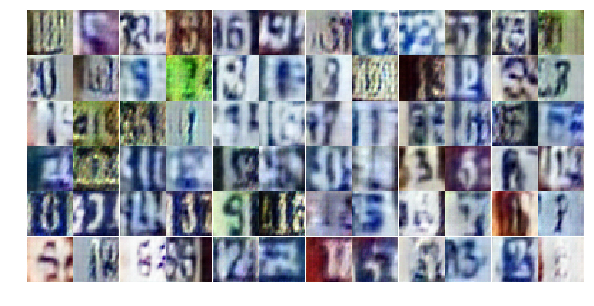

Epoch 8/25... Discriminator Loss: 0.6781... Generator Loss: 1.5477
Epoch 8/25... Discriminator Loss: 0.8270... Generator Loss: 0.8376
Epoch 8/25... Discriminator Loss: 0.5056... Generator Loss: 1.3889
Epoch 8/25... Discriminator Loss: 1.3833... Generator Loss: 0.4416
Epoch 8/25... Discriminator Loss: 0.6889... Generator Loss: 0.9990
Epoch 8/25... Discriminator Loss: 1.0285... Generator Loss: 0.6103
Epoch 8/25... Discriminator Loss: 0.5394... Generator Loss: 1.3263
Epoch 8/25... Discriminator Loss: 0.6191... Generator Loss: 1.1213
Epoch 8/25... Discriminator Loss: 0.5935... Generator Loss: 1.1612
Epoch 8/25... Discriminator Loss: 0.7409... Generator Loss: 0.9264


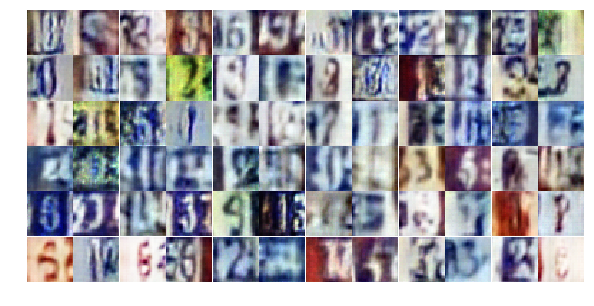

Epoch 8/25... Discriminator Loss: 0.5310... Generator Loss: 2.9474
Epoch 8/25... Discriminator Loss: 1.0723... Generator Loss: 0.5828
Epoch 8/25... Discriminator Loss: 0.7524... Generator Loss: 0.8292
Epoch 8/25... Discriminator Loss: 0.5928... Generator Loss: 1.1311
Epoch 8/25... Discriminator Loss: 2.3257... Generator Loss: 4.1056
Epoch 8/25... Discriminator Loss: 1.1737... Generator Loss: 0.5480
Epoch 8/25... Discriminator Loss: 0.5524... Generator Loss: 1.3907
Epoch 8/25... Discriminator Loss: 0.5589... Generator Loss: 1.1982
Epoch 8/25... Discriminator Loss: 0.4734... Generator Loss: 1.9484
Epoch 8/25... Discriminator Loss: 0.6139... Generator Loss: 1.3683


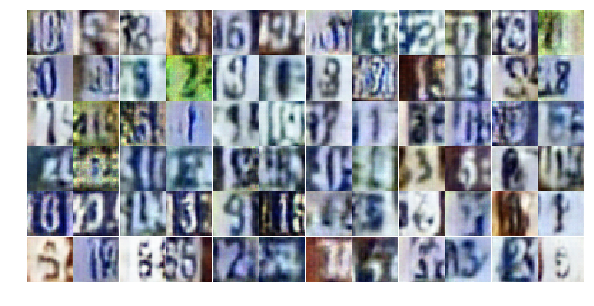

Epoch 8/25... Discriminator Loss: 0.3804... Generator Loss: 1.8937
Epoch 8/25... Discriminator Loss: 0.4444... Generator Loss: 1.6797
Epoch 8/25... Discriminator Loss: 0.3275... Generator Loss: 2.9970
Epoch 8/25... Discriminator Loss: 0.8141... Generator Loss: 0.7728
Epoch 8/25... Discriminator Loss: 0.4672... Generator Loss: 2.6532
Epoch 8/25... Discriminator Loss: 1.1381... Generator Loss: 0.5366
Epoch 8/25... Discriminator Loss: 0.6629... Generator Loss: 1.0776
Epoch 8/25... Discriminator Loss: 0.4643... Generator Loss: 1.5459
Epoch 9/25... Discriminator Loss: 0.9598... Generator Loss: 0.6698
Epoch 9/25... Discriminator Loss: 0.4763... Generator Loss: 1.9226


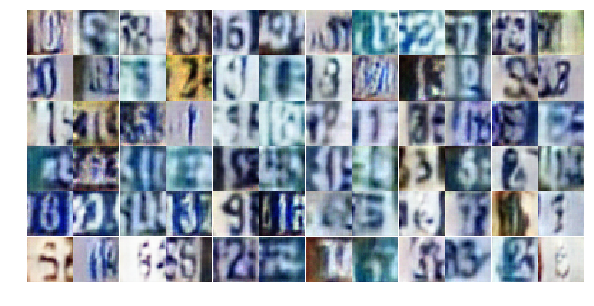

Epoch 9/25... Discriminator Loss: 0.7190... Generator Loss: 1.0504
Epoch 9/25... Discriminator Loss: 0.7793... Generator Loss: 0.8444
Epoch 9/25... Discriminator Loss: 0.7700... Generator Loss: 0.8636
Epoch 9/25... Discriminator Loss: 0.4146... Generator Loss: 1.6660
Epoch 9/25... Discriminator Loss: 2.0785... Generator Loss: 0.2357
Epoch 9/25... Discriminator Loss: 0.6477... Generator Loss: 1.5685
Epoch 9/25... Discriminator Loss: 0.6500... Generator Loss: 1.7500
Epoch 9/25... Discriminator Loss: 0.5822... Generator Loss: 1.2520
Epoch 9/25... Discriminator Loss: 1.2812... Generator Loss: 0.4545
Epoch 9/25... Discriminator Loss: 0.7546... Generator Loss: 0.9247


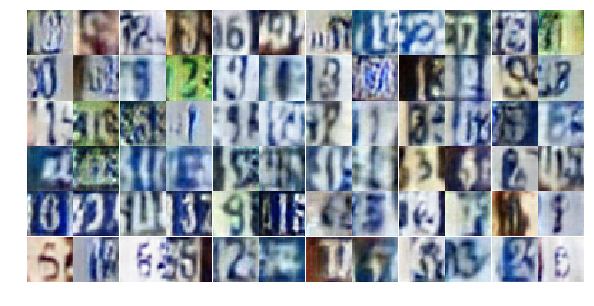

Epoch 9/25... Discriminator Loss: 0.8357... Generator Loss: 0.8090
Epoch 9/25... Discriminator Loss: 0.8295... Generator Loss: 0.8287
Epoch 9/25... Discriminator Loss: 0.6522... Generator Loss: 1.2467
Epoch 9/25... Discriminator Loss: 1.2397... Generator Loss: 0.5104
Epoch 9/25... Discriminator Loss: 0.5276... Generator Loss: 1.3721
Epoch 9/25... Discriminator Loss: 0.6664... Generator Loss: 1.1734
Epoch 9/25... Discriminator Loss: 1.1356... Generator Loss: 0.5611
Epoch 9/25... Discriminator Loss: 0.4291... Generator Loss: 1.4835
Epoch 9/25... Discriminator Loss: 1.1836... Generator Loss: 0.4667
Epoch 9/25... Discriminator Loss: 0.8061... Generator Loss: 0.8587


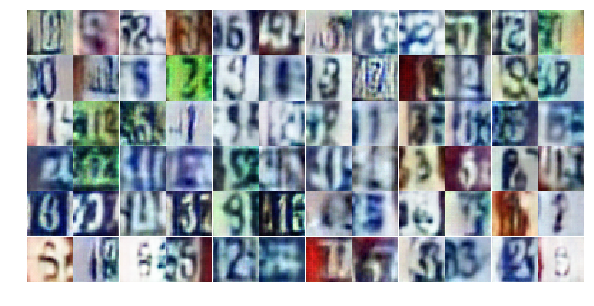

Epoch 9/25... Discriminator Loss: 1.0756... Generator Loss: 0.5631
Epoch 9/25... Discriminator Loss: 0.6058... Generator Loss: 1.1723
Epoch 9/25... Discriminator Loss: 0.6668... Generator Loss: 1.0589
Epoch 9/25... Discriminator Loss: 0.6021... Generator Loss: 1.5199
Epoch 9/25... Discriminator Loss: 0.7267... Generator Loss: 2.6302
Epoch 9/25... Discriminator Loss: 0.5442... Generator Loss: 1.8206
Epoch 9/25... Discriminator Loss: 0.9770... Generator Loss: 0.6894
Epoch 9/25... Discriminator Loss: 0.4605... Generator Loss: 1.8203
Epoch 9/25... Discriminator Loss: 0.5792... Generator Loss: 1.3184
Epoch 9/25... Discriminator Loss: 0.6196... Generator Loss: 1.0495


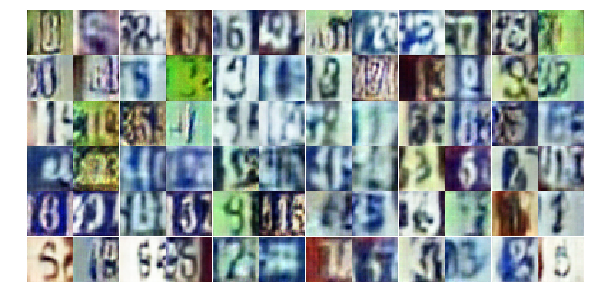

Epoch 9/25... Discriminator Loss: 0.6098... Generator Loss: 1.1176
Epoch 9/25... Discriminator Loss: 0.9564... Generator Loss: 0.6997
Epoch 9/25... Discriminator Loss: 0.7640... Generator Loss: 0.9902
Epoch 9/25... Discriminator Loss: 0.6931... Generator Loss: 1.5844
Epoch 9/25... Discriminator Loss: 0.5615... Generator Loss: 1.4453
Epoch 9/25... Discriminator Loss: 0.6414... Generator Loss: 1.2029
Epoch 9/25... Discriminator Loss: 0.6429... Generator Loss: 1.1781
Epoch 9/25... Discriminator Loss: 0.5439... Generator Loss: 1.3276
Epoch 9/25... Discriminator Loss: 0.7014... Generator Loss: 1.2357
Epoch 9/25... Discriminator Loss: 1.1013... Generator Loss: 0.5566


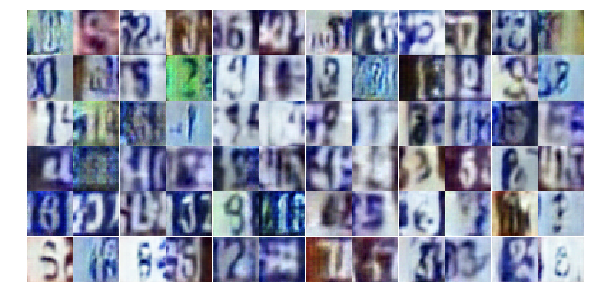

Epoch 9/25... Discriminator Loss: 0.6991... Generator Loss: 0.9565
Epoch 9/25... Discriminator Loss: 0.5530... Generator Loss: 1.1670
Epoch 9/25... Discriminator Loss: 0.6055... Generator Loss: 2.8402
Epoch 9/25... Discriminator Loss: 0.8018... Generator Loss: 0.9890
Epoch 9/25... Discriminator Loss: 0.4732... Generator Loss: 1.7265
Epoch 9/25... Discriminator Loss: 0.7115... Generator Loss: 0.9560
Epoch 9/25... Discriminator Loss: 0.7942... Generator Loss: 0.9133
Epoch 9/25... Discriminator Loss: 1.2407... Generator Loss: 0.4347
Epoch 9/25... Discriminator Loss: 0.4686... Generator Loss: 1.4362
Epoch 9/25... Discriminator Loss: 0.6032... Generator Loss: 1.9915


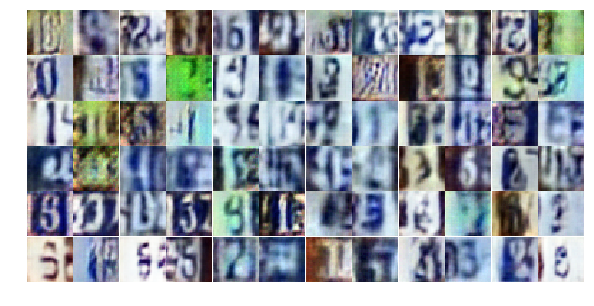

Epoch 9/25... Discriminator Loss: 0.7950... Generator Loss: 0.9824
Epoch 9/25... Discriminator Loss: 1.3746... Generator Loss: 3.3439
Epoch 9/25... Discriminator Loss: 0.9342... Generator Loss: 0.7172
Epoch 9/25... Discriminator Loss: 0.5852... Generator Loss: 1.4185
Epoch 9/25... Discriminator Loss: 0.6192... Generator Loss: 1.1309
Epoch 10/25... Discriminator Loss: 0.5787... Generator Loss: 1.4827
Epoch 10/25... Discriminator Loss: 0.6444... Generator Loss: 1.2987
Epoch 10/25... Discriminator Loss: 0.7672... Generator Loss: 1.0815
Epoch 10/25... Discriminator Loss: 0.7635... Generator Loss: 0.8772
Epoch 10/25... Discriminator Loss: 1.3549... Generator Loss: 0.4133


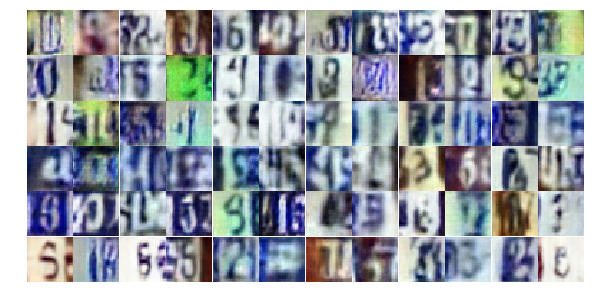

Epoch 10/25... Discriminator Loss: 1.1786... Generator Loss: 0.5153
Epoch 10/25... Discriminator Loss: 0.4528... Generator Loss: 1.6896
Epoch 10/25... Discriminator Loss: 0.4777... Generator Loss: 1.3977
Epoch 10/25... Discriminator Loss: 0.6427... Generator Loss: 1.0984
Epoch 10/25... Discriminator Loss: 0.5200... Generator Loss: 2.0699
Epoch 10/25... Discriminator Loss: 0.5919... Generator Loss: 1.2179
Epoch 10/25... Discriminator Loss: 0.3917... Generator Loss: 1.5563
Epoch 10/25... Discriminator Loss: 1.3918... Generator Loss: 0.4124
Epoch 10/25... Discriminator Loss: 2.8127... Generator Loss: 0.1118
Epoch 10/25... Discriminator Loss: 0.6203... Generator Loss: 1.6090


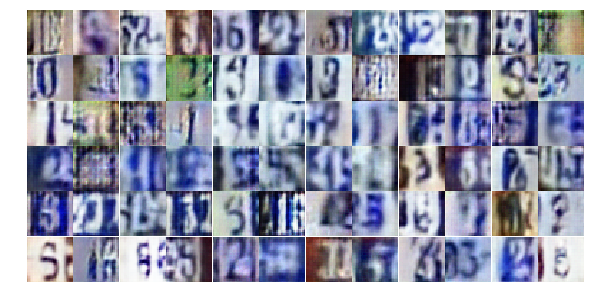

Epoch 10/25... Discriminator Loss: 0.8750... Generator Loss: 0.9979
Epoch 10/25... Discriminator Loss: 1.1372... Generator Loss: 0.5351
Epoch 10/25... Discriminator Loss: 0.6318... Generator Loss: 1.1013
Epoch 10/25... Discriminator Loss: 0.8988... Generator Loss: 0.7224
Epoch 10/25... Discriminator Loss: 0.6071... Generator Loss: 1.2872
Epoch 10/25... Discriminator Loss: 0.5510... Generator Loss: 1.2275
Epoch 10/25... Discriminator Loss: 0.7229... Generator Loss: 1.0548
Epoch 10/25... Discriminator Loss: 0.6097... Generator Loss: 2.0418
Epoch 10/25... Discriminator Loss: 0.6111... Generator Loss: 1.1262
Epoch 10/25... Discriminator Loss: 0.4303... Generator Loss: 3.0025


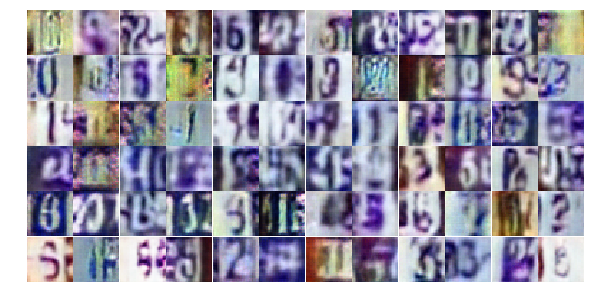

Epoch 10/25... Discriminator Loss: 1.1420... Generator Loss: 0.5227
Epoch 10/25... Discriminator Loss: 0.7137... Generator Loss: 0.9699
Epoch 10/25... Discriminator Loss: 0.3986... Generator Loss: 2.1175
Epoch 10/25... Discriminator Loss: 0.4082... Generator Loss: 2.6375
Epoch 10/25... Discriminator Loss: 1.5326... Generator Loss: 0.3082
Epoch 10/25... Discriminator Loss: 0.5638... Generator Loss: 1.2093
Epoch 10/25... Discriminator Loss: 0.3055... Generator Loss: 2.2804
Epoch 10/25... Discriminator Loss: 1.1268... Generator Loss: 0.5535
Epoch 10/25... Discriminator Loss: 0.6888... Generator Loss: 0.9227
Epoch 10/25... Discriminator Loss: 1.5211... Generator Loss: 2.9925


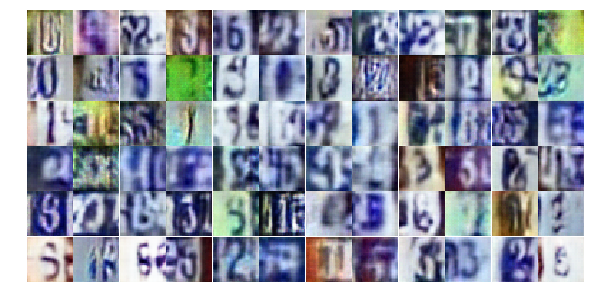

Epoch 10/25... Discriminator Loss: 0.9108... Generator Loss: 2.8284
Epoch 10/25... Discriminator Loss: 0.9228... Generator Loss: 1.3483
Epoch 10/25... Discriminator Loss: 0.7882... Generator Loss: 1.2230
Epoch 10/25... Discriminator Loss: 0.6503... Generator Loss: 1.2869
Epoch 10/25... Discriminator Loss: 0.7156... Generator Loss: 1.0719
Epoch 10/25... Discriminator Loss: 0.8193... Generator Loss: 0.8685
Epoch 10/25... Discriminator Loss: 0.9630... Generator Loss: 0.7436
Epoch 10/25... Discriminator Loss: 0.8056... Generator Loss: 0.8839
Epoch 10/25... Discriminator Loss: 0.6272... Generator Loss: 1.0039
Epoch 10/25... Discriminator Loss: 0.7080... Generator Loss: 1.2127


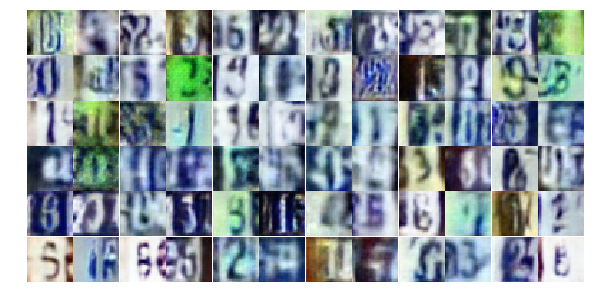

Epoch 10/25... Discriminator Loss: 0.6063... Generator Loss: 1.2294
Epoch 10/25... Discriminator Loss: 0.8601... Generator Loss: 0.9716
Epoch 10/25... Discriminator Loss: 0.5672... Generator Loss: 1.3108
Epoch 10/25... Discriminator Loss: 0.9067... Generator Loss: 0.7395
Epoch 10/25... Discriminator Loss: 0.5712... Generator Loss: 1.3286
Epoch 10/25... Discriminator Loss: 0.6218... Generator Loss: 1.5972
Epoch 10/25... Discriminator Loss: 0.5437... Generator Loss: 1.2417
Epoch 10/25... Discriminator Loss: 0.4503... Generator Loss: 1.9630
Epoch 10/25... Discriminator Loss: 0.8843... Generator Loss: 1.3664
Epoch 10/25... Discriminator Loss: 0.5209... Generator Loss: 1.4009


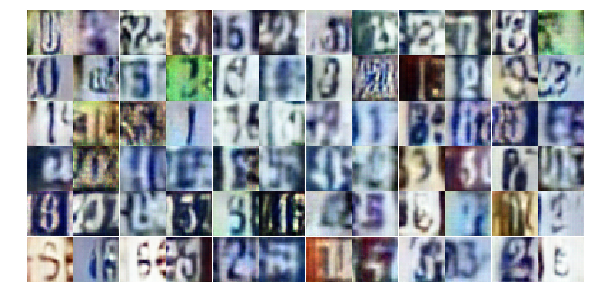

Epoch 10/25... Discriminator Loss: 0.7268... Generator Loss: 1.8071
Epoch 10/25... Discriminator Loss: 0.4948... Generator Loss: 1.3268
Epoch 10/25... Discriminator Loss: 0.3791... Generator Loss: 1.6329
Epoch 11/25... Discriminator Loss: 0.7916... Generator Loss: 0.8671
Epoch 11/25... Discriminator Loss: 0.6627... Generator Loss: 1.0150
Epoch 11/25... Discriminator Loss: 1.5637... Generator Loss: 0.3233
Epoch 11/25... Discriminator Loss: 0.8786... Generator Loss: 0.7436
Epoch 11/25... Discriminator Loss: 0.6738... Generator Loss: 0.9982
Epoch 11/25... Discriminator Loss: 1.9803... Generator Loss: 0.2285
Epoch 11/25... Discriminator Loss: 0.6206... Generator Loss: 1.7091


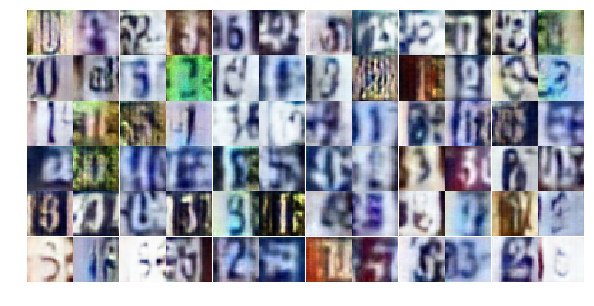

Epoch 11/25... Discriminator Loss: 0.5841... Generator Loss: 1.0478
Epoch 11/25... Discriminator Loss: 0.5715... Generator Loss: 1.2712
Epoch 11/25... Discriminator Loss: 0.5107... Generator Loss: 1.3918
Epoch 11/25... Discriminator Loss: 0.6369... Generator Loss: 1.2155
Epoch 11/25... Discriminator Loss: 0.9651... Generator Loss: 0.6833
Epoch 11/25... Discriminator Loss: 0.5235... Generator Loss: 1.6394
Epoch 11/25... Discriminator Loss: 0.5442... Generator Loss: 1.5610
Epoch 11/25... Discriminator Loss: 0.5965... Generator Loss: 1.2545
Epoch 11/25... Discriminator Loss: 0.6291... Generator Loss: 1.1342
Epoch 11/25... Discriminator Loss: 1.5221... Generator Loss: 0.3755


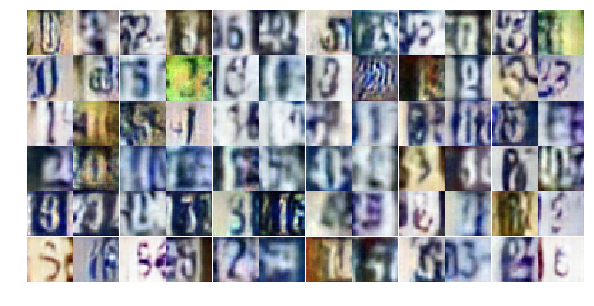

Epoch 11/25... Discriminator Loss: 0.7920... Generator Loss: 0.9227
Epoch 11/25... Discriminator Loss: 0.3157... Generator Loss: 1.8156
Epoch 11/25... Discriminator Loss: 1.0130... Generator Loss: 0.6453
Epoch 11/25... Discriminator Loss: 0.5322... Generator Loss: 1.2492
Epoch 11/25... Discriminator Loss: 0.3794... Generator Loss: 2.2424
Epoch 11/25... Discriminator Loss: 0.6873... Generator Loss: 1.2712
Epoch 11/25... Discriminator Loss: 0.4189... Generator Loss: 1.4772
Epoch 11/25... Discriminator Loss: 0.8267... Generator Loss: 0.8778
Epoch 11/25... Discriminator Loss: 0.3316... Generator Loss: 2.0142
Epoch 11/25... Discriminator Loss: 1.0215... Generator Loss: 0.6469


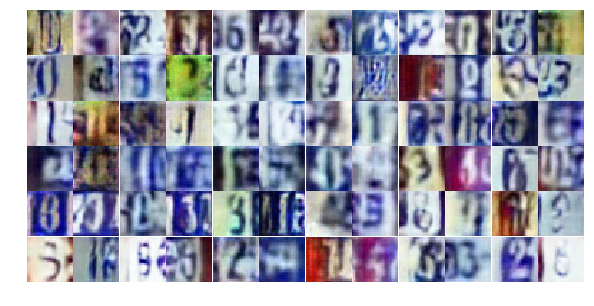

Epoch 11/25... Discriminator Loss: 0.9517... Generator Loss: 0.8739
Epoch 11/25... Discriminator Loss: 0.7025... Generator Loss: 0.9590
Epoch 11/25... Discriminator Loss: 0.8604... Generator Loss: 0.8643
Epoch 11/25... Discriminator Loss: 0.3452... Generator Loss: 1.7174
Epoch 11/25... Discriminator Loss: 0.7516... Generator Loss: 0.9573
Epoch 11/25... Discriminator Loss: 1.1165... Generator Loss: 0.5698
Epoch 11/25... Discriminator Loss: 0.9145... Generator Loss: 1.0703
Epoch 11/25... Discriminator Loss: 1.2925... Generator Loss: 0.4534
Epoch 11/25... Discriminator Loss: 0.7579... Generator Loss: 0.8670
Epoch 11/25... Discriminator Loss: 1.1003... Generator Loss: 0.5452


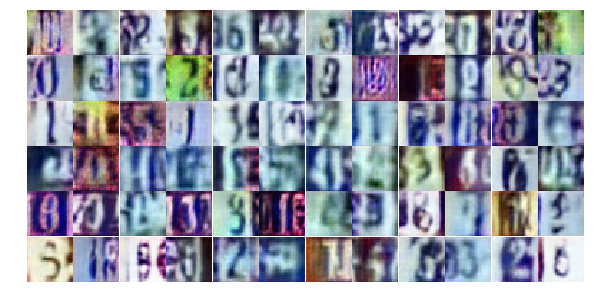

Epoch 11/25... Discriminator Loss: 0.4352... Generator Loss: 1.5469
Epoch 11/25... Discriminator Loss: 0.7124... Generator Loss: 1.0155
Epoch 11/25... Discriminator Loss: 0.6238... Generator Loss: 1.3001
Epoch 11/25... Discriminator Loss: 0.9837... Generator Loss: 0.6910
Epoch 11/25... Discriminator Loss: 0.9721... Generator Loss: 0.6584
Epoch 11/25... Discriminator Loss: 0.6369... Generator Loss: 1.1453
Epoch 11/25... Discriminator Loss: 0.5679... Generator Loss: 1.2478
Epoch 11/25... Discriminator Loss: 0.9532... Generator Loss: 2.9537
Epoch 11/25... Discriminator Loss: 1.0378... Generator Loss: 1.0782
Epoch 11/25... Discriminator Loss: 0.5683... Generator Loss: 1.1967


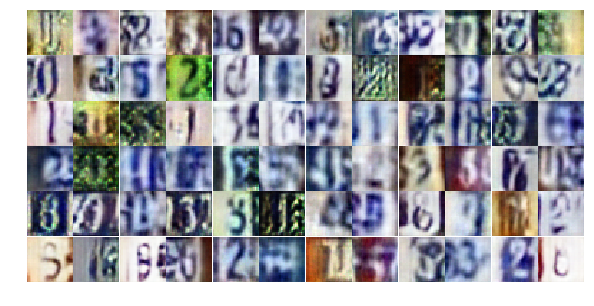

Epoch 11/25... Discriminator Loss: 0.4965... Generator Loss: 1.6648
Epoch 11/25... Discriminator Loss: 0.4231... Generator Loss: 1.6848
Epoch 11/25... Discriminator Loss: 0.5788... Generator Loss: 1.4337
Epoch 11/25... Discriminator Loss: 0.7035... Generator Loss: 0.9304
Epoch 11/25... Discriminator Loss: 1.0119... Generator Loss: 0.6713
Epoch 11/25... Discriminator Loss: 0.8948... Generator Loss: 0.7099
Epoch 11/25... Discriminator Loss: 0.8502... Generator Loss: 0.7906
Epoch 11/25... Discriminator Loss: 0.6036... Generator Loss: 2.1920
Epoch 11/25... Discriminator Loss: 0.9892... Generator Loss: 0.7113
Epoch 11/25... Discriminator Loss: 0.7423... Generator Loss: 1.0024


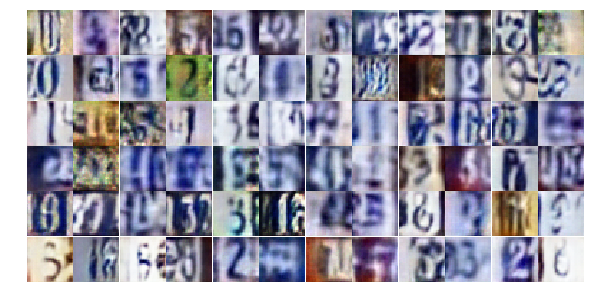

Epoch 12/25... Discriminator Loss: 0.5955... Generator Loss: 1.4392
Epoch 12/25... Discriminator Loss: 0.8206... Generator Loss: 0.9232
Epoch 12/25... Discriminator Loss: 0.6579... Generator Loss: 1.1535
Epoch 12/25... Discriminator Loss: 0.5430... Generator Loss: 1.3886
Epoch 12/25... Discriminator Loss: 0.4060... Generator Loss: 2.1673
Epoch 12/25... Discriminator Loss: 0.7835... Generator Loss: 1.0035
Epoch 12/25... Discriminator Loss: 0.6727... Generator Loss: 1.1765
Epoch 12/25... Discriminator Loss: 0.7247... Generator Loss: 1.0002
Epoch 12/25... Discriminator Loss: 0.6056... Generator Loss: 1.8957
Epoch 12/25... Discriminator Loss: 1.3600... Generator Loss: 0.4081


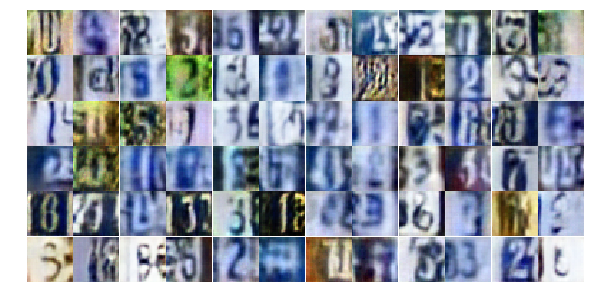

Epoch 12/25... Discriminator Loss: 0.6029... Generator Loss: 1.0674
Epoch 12/25... Discriminator Loss: 0.7653... Generator Loss: 1.3107
Epoch 12/25... Discriminator Loss: 0.4157... Generator Loss: 1.4710
Epoch 12/25... Discriminator Loss: 0.6624... Generator Loss: 2.2820
Epoch 12/25... Discriminator Loss: 1.4616... Generator Loss: 0.4394
Epoch 12/25... Discriminator Loss: 0.9862... Generator Loss: 1.6170
Epoch 12/25... Discriminator Loss: 1.4070... Generator Loss: 0.4142
Epoch 12/25... Discriminator Loss: 0.4699... Generator Loss: 1.5908
Epoch 12/25... Discriminator Loss: 0.7313... Generator Loss: 0.9266
Epoch 12/25... Discriminator Loss: 0.5806... Generator Loss: 1.2004


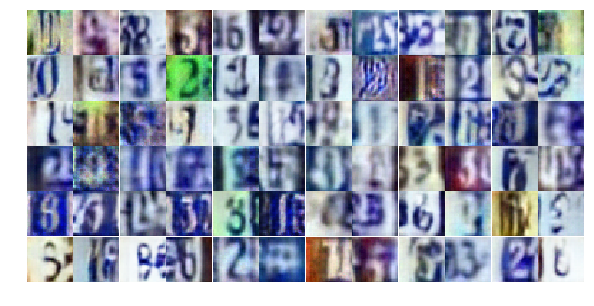

Epoch 12/25... Discriminator Loss: 0.4093... Generator Loss: 1.6853
Epoch 12/25... Discriminator Loss: 0.5044... Generator Loss: 1.3837
Epoch 12/25... Discriminator Loss: 0.6096... Generator Loss: 1.0607
Epoch 12/25... Discriminator Loss: 0.4771... Generator Loss: 1.5342
Epoch 12/25... Discriminator Loss: 0.5279... Generator Loss: 1.2694
Epoch 12/25... Discriminator Loss: 0.4923... Generator Loss: 1.3584
Epoch 12/25... Discriminator Loss: 0.8260... Generator Loss: 0.7974
Epoch 12/25... Discriminator Loss: 0.3443... Generator Loss: 1.8684
Epoch 12/25... Discriminator Loss: 0.7212... Generator Loss: 0.9773
Epoch 12/25... Discriminator Loss: 0.9061... Generator Loss: 0.7208


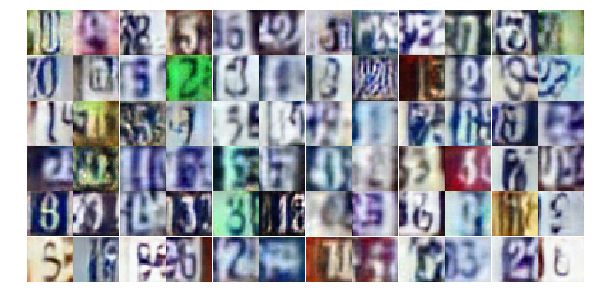

Epoch 12/25... Discriminator Loss: 0.6117... Generator Loss: 1.0664
Epoch 12/25... Discriminator Loss: 0.9645... Generator Loss: 0.6708
Epoch 12/25... Discriminator Loss: 0.8480... Generator Loss: 0.8005
Epoch 12/25... Discriminator Loss: 1.8350... Generator Loss: 0.2279
Epoch 12/25... Discriminator Loss: 0.5548... Generator Loss: 1.7647
Epoch 12/25... Discriminator Loss: 0.8202... Generator Loss: 0.9180
Epoch 12/25... Discriminator Loss: 1.4097... Generator Loss: 0.4547
Epoch 12/25... Discriminator Loss: 0.6224... Generator Loss: 1.1627
Epoch 12/25... Discriminator Loss: 0.5085... Generator Loss: 1.5766
Epoch 12/25... Discriminator Loss: 0.3174... Generator Loss: 2.1070


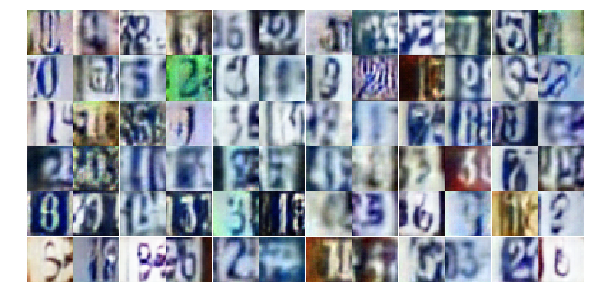

Epoch 12/25... Discriminator Loss: 0.6481... Generator Loss: 1.5256
Epoch 12/25... Discriminator Loss: 0.3821... Generator Loss: 1.9243
Epoch 12/25... Discriminator Loss: 0.4052... Generator Loss: 1.8039
Epoch 12/25... Discriminator Loss: 0.9268... Generator Loss: 0.7647
Epoch 12/25... Discriminator Loss: 0.7270... Generator Loss: 0.8991
Epoch 12/25... Discriminator Loss: 0.8301... Generator Loss: 0.8196
Epoch 12/25... Discriminator Loss: 0.7680... Generator Loss: 0.8627
Epoch 12/25... Discriminator Loss: 1.0141... Generator Loss: 0.6587
Epoch 12/25... Discriminator Loss: 0.4029... Generator Loss: 1.6948
Epoch 12/25... Discriminator Loss: 0.6778... Generator Loss: 1.0084


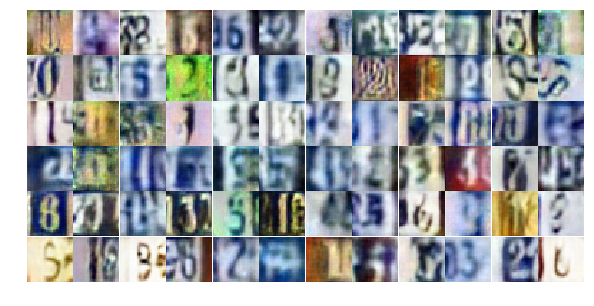

Epoch 12/25... Discriminator Loss: 1.1050... Generator Loss: 0.6596
Epoch 12/25... Discriminator Loss: 1.1108... Generator Loss: 0.7093
Epoch 12/25... Discriminator Loss: 1.7688... Generator Loss: 3.5762
Epoch 12/25... Discriminator Loss: 1.8637... Generator Loss: 1.4896
Epoch 12/25... Discriminator Loss: 0.8103... Generator Loss: 1.1438
Epoch 12/25... Discriminator Loss: 0.7354... Generator Loss: 1.5457
Epoch 12/25... Discriminator Loss: 1.0484... Generator Loss: 1.0652
Epoch 13/25... Discriminator Loss: 0.4995... Generator Loss: 1.4615
Epoch 13/25... Discriminator Loss: 0.5920... Generator Loss: 1.3282
Epoch 13/25... Discriminator Loss: 0.8209... Generator Loss: 0.8860


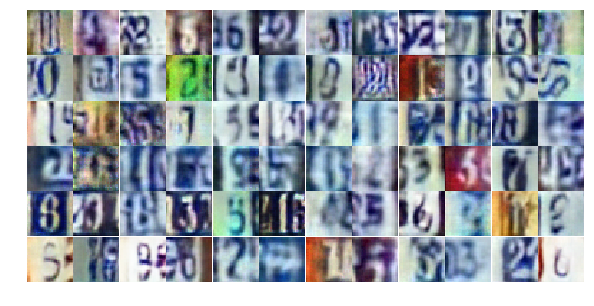

Epoch 13/25... Discriminator Loss: 0.7633... Generator Loss: 1.0444
Epoch 13/25... Discriminator Loss: 0.7571... Generator Loss: 1.2872
Epoch 13/25... Discriminator Loss: 1.3802... Generator Loss: 0.3895
Epoch 13/25... Discriminator Loss: 1.4960... Generator Loss: 0.3910
Epoch 13/25... Discriminator Loss: 0.6741... Generator Loss: 1.0553
Epoch 13/25... Discriminator Loss: 0.7113... Generator Loss: 1.1920
Epoch 13/25... Discriminator Loss: 0.4258... Generator Loss: 1.7663
Epoch 13/25... Discriminator Loss: 0.7162... Generator Loss: 0.8858
Epoch 13/25... Discriminator Loss: 0.6110... Generator Loss: 1.0196
Epoch 13/25... Discriminator Loss: 0.8583... Generator Loss: 0.7251


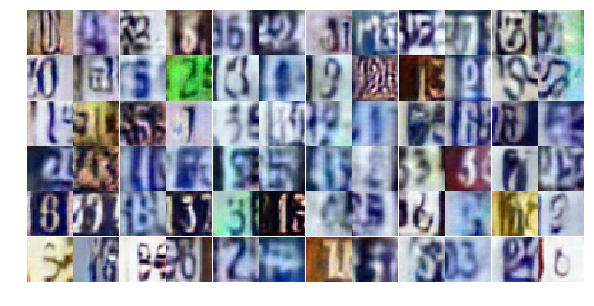

Epoch 13/25... Discriminator Loss: 0.6614... Generator Loss: 1.0588
Epoch 13/25... Discriminator Loss: 0.5517... Generator Loss: 1.3072
Epoch 13/25... Discriminator Loss: 0.9194... Generator Loss: 0.7870
Epoch 13/25... Discriminator Loss: 0.6687... Generator Loss: 1.0801
Epoch 13/25... Discriminator Loss: 0.5936... Generator Loss: 1.8261
Epoch 13/25... Discriminator Loss: 1.0783... Generator Loss: 0.5985
Epoch 13/25... Discriminator Loss: 0.6615... Generator Loss: 1.0869
Epoch 13/25... Discriminator Loss: 1.2552... Generator Loss: 0.5134
Epoch 13/25... Discriminator Loss: 0.7180... Generator Loss: 1.0115
Epoch 13/25... Discriminator Loss: 0.9462... Generator Loss: 0.6310


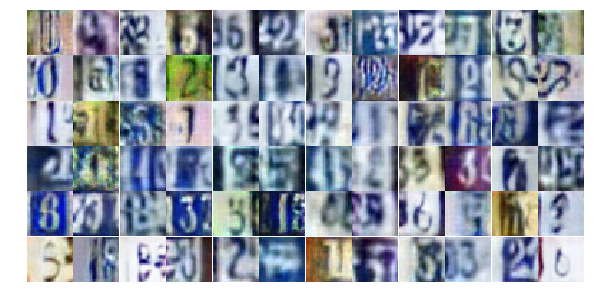

Epoch 13/25... Discriminator Loss: 0.7175... Generator Loss: 0.9609
Epoch 13/25... Discriminator Loss: 0.5913... Generator Loss: 1.4755
Epoch 13/25... Discriminator Loss: 0.7525... Generator Loss: 2.1431
Epoch 13/25... Discriminator Loss: 0.7247... Generator Loss: 0.9454
Epoch 13/25... Discriminator Loss: 0.6802... Generator Loss: 1.1778
Epoch 13/25... Discriminator Loss: 0.8291... Generator Loss: 0.8650
Epoch 13/25... Discriminator Loss: 0.6862... Generator Loss: 1.1980
Epoch 13/25... Discriminator Loss: 0.5295... Generator Loss: 1.2734
Epoch 13/25... Discriminator Loss: 0.6345... Generator Loss: 1.0775
Epoch 13/25... Discriminator Loss: 0.5503... Generator Loss: 1.3706


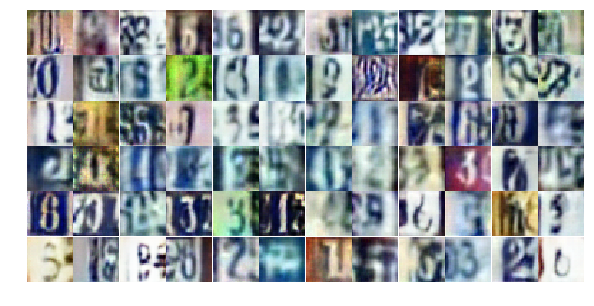

Epoch 13/25... Discriminator Loss: 0.8869... Generator Loss: 0.7630
Epoch 13/25... Discriminator Loss: 1.4743... Generator Loss: 0.3991
Epoch 13/25... Discriminator Loss: 0.9849... Generator Loss: 0.7301
Epoch 13/25... Discriminator Loss: 1.1623... Generator Loss: 0.5715
Epoch 13/25... Discriminator Loss: 0.6228... Generator Loss: 1.3503
Epoch 13/25... Discriminator Loss: 0.6232... Generator Loss: 1.1967
Epoch 13/25... Discriminator Loss: 0.5002... Generator Loss: 1.4476
Epoch 13/25... Discriminator Loss: 1.2353... Generator Loss: 0.5125
Epoch 13/25... Discriminator Loss: 0.6001... Generator Loss: 1.4727
Epoch 13/25... Discriminator Loss: 0.9092... Generator Loss: 0.7027


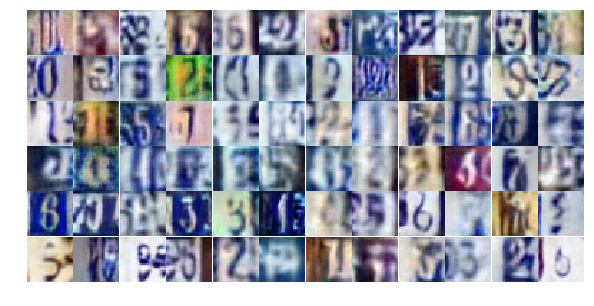

Epoch 13/25... Discriminator Loss: 0.5390... Generator Loss: 1.3434
Epoch 13/25... Discriminator Loss: 1.1399... Generator Loss: 0.6365
Epoch 13/25... Discriminator Loss: 0.7731... Generator Loss: 0.9642
Epoch 13/25... Discriminator Loss: 0.7426... Generator Loss: 0.9403
Epoch 13/25... Discriminator Loss: 1.1391... Generator Loss: 0.5354
Epoch 13/25... Discriminator Loss: 0.6611... Generator Loss: 1.3209
Epoch 13/25... Discriminator Loss: 0.8694... Generator Loss: 0.8826
Epoch 13/25... Discriminator Loss: 0.6367... Generator Loss: 1.3056
Epoch 13/25... Discriminator Loss: 0.8208... Generator Loss: 0.7895
Epoch 13/25... Discriminator Loss: 1.1293... Generator Loss: 0.5582


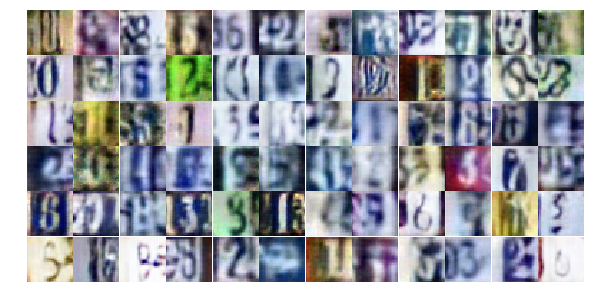

Epoch 13/25... Discriminator Loss: 0.3935... Generator Loss: 1.8492
Epoch 13/25... Discriminator Loss: 1.4076... Generator Loss: 0.4059
Epoch 13/25... Discriminator Loss: 0.6144... Generator Loss: 1.2604
Epoch 13/25... Discriminator Loss: 0.9856... Generator Loss: 0.6472
Epoch 14/25... Discriminator Loss: 0.9262... Generator Loss: 0.7414
Epoch 14/25... Discriminator Loss: 0.8837... Generator Loss: 0.9913
Epoch 14/25... Discriminator Loss: 1.0510... Generator Loss: 0.6472
Epoch 14/25... Discriminator Loss: 0.6375... Generator Loss: 1.1329
Epoch 14/25... Discriminator Loss: 0.6810... Generator Loss: 1.0666
Epoch 14/25... Discriminator Loss: 1.0291... Generator Loss: 0.6456


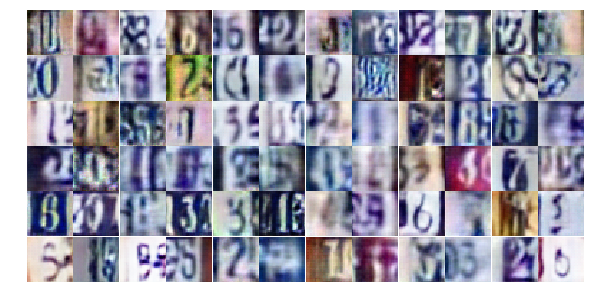

Epoch 14/25... Discriminator Loss: 0.7757... Generator Loss: 1.9154
Epoch 14/25... Discriminator Loss: 1.2999... Generator Loss: 0.4253
Epoch 14/25... Discriminator Loss: 0.5029... Generator Loss: 1.5415
Epoch 14/25... Discriminator Loss: 0.5999... Generator Loss: 1.0856
Epoch 14/25... Discriminator Loss: 1.4146... Generator Loss: 0.3944
Epoch 14/25... Discriminator Loss: 0.3898... Generator Loss: 1.5704
Epoch 14/25... Discriminator Loss: 0.3795... Generator Loss: 1.8354
Epoch 14/25... Discriminator Loss: 1.4142... Generator Loss: 0.3664
Epoch 14/25... Discriminator Loss: 2.0574... Generator Loss: 0.1957
Epoch 14/25... Discriminator Loss: 2.0990... Generator Loss: 0.2531


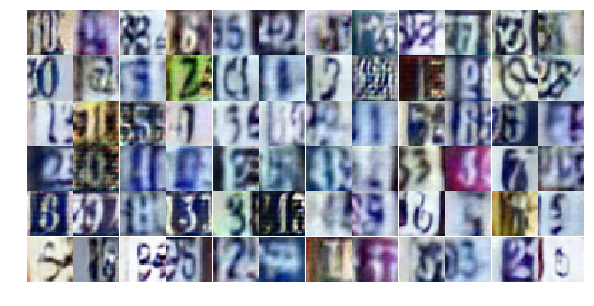

Epoch 14/25... Discriminator Loss: 0.6535... Generator Loss: 1.0563
Epoch 14/25... Discriminator Loss: 0.6393... Generator Loss: 2.2219
Epoch 14/25... Discriminator Loss: 0.7141... Generator Loss: 1.0996
Epoch 14/25... Discriminator Loss: 0.5871... Generator Loss: 1.2982
Epoch 14/25... Discriminator Loss: 0.8352... Generator Loss: 0.8275
Epoch 14/25... Discriminator Loss: 0.9753... Generator Loss: 0.6598
Epoch 14/25... Discriminator Loss: 0.7150... Generator Loss: 1.0612
Epoch 14/25... Discriminator Loss: 0.6578... Generator Loss: 1.0967
Epoch 14/25... Discriminator Loss: 0.7892... Generator Loss: 0.8777
Epoch 14/25... Discriminator Loss: 0.5766... Generator Loss: 1.2789


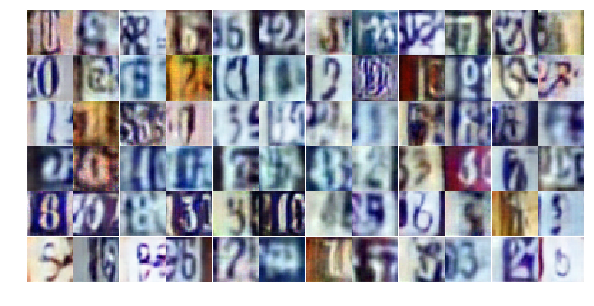

Epoch 14/25... Discriminator Loss: 1.6067... Generator Loss: 0.3228
Epoch 14/25... Discriminator Loss: 0.5330... Generator Loss: 1.1454
Epoch 14/25... Discriminator Loss: 0.5456... Generator Loss: 1.2581
Epoch 14/25... Discriminator Loss: 0.4119... Generator Loss: 1.5358
Epoch 14/25... Discriminator Loss: 0.4894... Generator Loss: 1.3764
Epoch 14/25... Discriminator Loss: 0.6162... Generator Loss: 1.0582
Epoch 14/25... Discriminator Loss: 0.9176... Generator Loss: 0.7464
Epoch 14/25... Discriminator Loss: 0.5256... Generator Loss: 1.9275
Epoch 14/25... Discriminator Loss: 0.3711... Generator Loss: 2.1487
Epoch 14/25... Discriminator Loss: 0.9414... Generator Loss: 0.7574


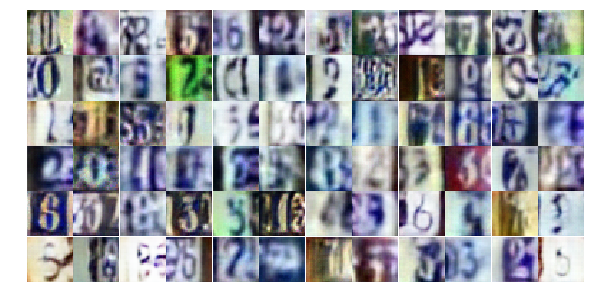

Epoch 14/25... Discriminator Loss: 0.8905... Generator Loss: 0.7499
Epoch 14/25... Discriminator Loss: 0.7359... Generator Loss: 1.3018
Epoch 14/25... Discriminator Loss: 1.0611... Generator Loss: 0.6420
Epoch 14/25... Discriminator Loss: 0.8367... Generator Loss: 0.8220
Epoch 14/25... Discriminator Loss: 1.2320... Generator Loss: 0.5289
Epoch 14/25... Discriminator Loss: 0.6678... Generator Loss: 1.0971
Epoch 14/25... Discriminator Loss: 0.6867... Generator Loss: 1.0275
Epoch 14/25... Discriminator Loss: 0.6190... Generator Loss: 1.1059
Epoch 14/25... Discriminator Loss: 1.3285... Generator Loss: 0.4395
Epoch 14/25... Discriminator Loss: 1.5528... Generator Loss: 0.3819


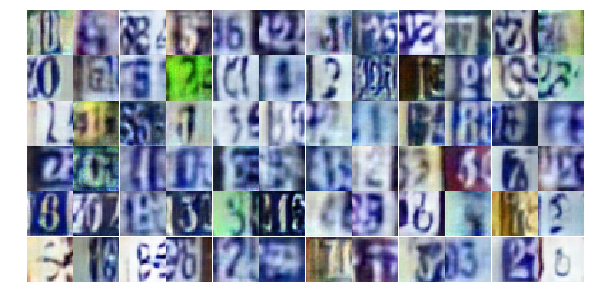

Epoch 14/25... Discriminator Loss: 0.7966... Generator Loss: 1.3322
Epoch 14/25... Discriminator Loss: 1.2289... Generator Loss: 0.4587
Epoch 14/25... Discriminator Loss: 0.6404... Generator Loss: 1.0871
Epoch 14/25... Discriminator Loss: 1.0080... Generator Loss: 0.6641
Epoch 14/25... Discriminator Loss: 0.8241... Generator Loss: 0.9552
Epoch 14/25... Discriminator Loss: 0.6064... Generator Loss: 1.1735
Epoch 14/25... Discriminator Loss: 3.3557... Generator Loss: 4.7093
Epoch 14/25... Discriminator Loss: 1.1937... Generator Loss: 1.2199
Epoch 14/25... Discriminator Loss: 1.1084... Generator Loss: 0.7343
Epoch 14/25... Discriminator Loss: 0.6797... Generator Loss: 1.0180


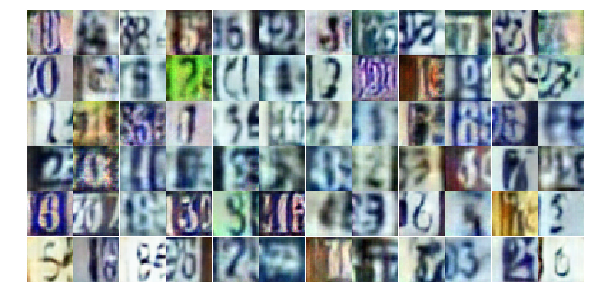

Epoch 14/25... Discriminator Loss: 0.7749... Generator Loss: 1.3121
Epoch 14/25... Discriminator Loss: 0.8698... Generator Loss: 0.9003
Epoch 15/25... Discriminator Loss: 0.9156... Generator Loss: 0.7806
Epoch 15/25... Discriminator Loss: 0.6648... Generator Loss: 1.1776
Epoch 15/25... Discriminator Loss: 0.6212... Generator Loss: 1.0900
Epoch 15/25... Discriminator Loss: 0.9047... Generator Loss: 0.7731
Epoch 15/25... Discriminator Loss: 1.0431... Generator Loss: 0.5991
Epoch 15/25... Discriminator Loss: 0.6831... Generator Loss: 0.9663
Epoch 15/25... Discriminator Loss: 0.9499... Generator Loss: 0.7479
Epoch 15/25... Discriminator Loss: 0.6150... Generator Loss: 1.1667


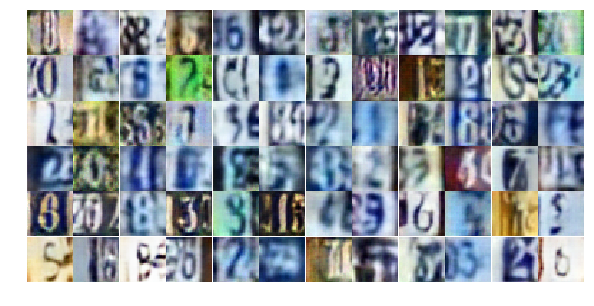

Epoch 15/25... Discriminator Loss: 0.8656... Generator Loss: 0.8247
Epoch 15/25... Discriminator Loss: 0.7641... Generator Loss: 1.0816
Epoch 15/25... Discriminator Loss: 0.9895... Generator Loss: 0.6872
Epoch 15/25... Discriminator Loss: 1.0157... Generator Loss: 0.6581
Epoch 15/25... Discriminator Loss: 0.9044... Generator Loss: 0.8037
Epoch 15/25... Discriminator Loss: 0.3713... Generator Loss: 1.8958
Epoch 15/25... Discriminator Loss: 2.1603... Generator Loss: 0.1999
Epoch 15/25... Discriminator Loss: 0.9613... Generator Loss: 0.7216
Epoch 15/25... Discriminator Loss: 0.7245... Generator Loss: 1.4543
Epoch 15/25... Discriminator Loss: 1.2199... Generator Loss: 0.5383


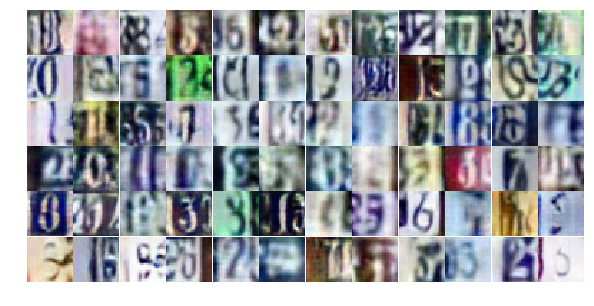

Epoch 15/25... Discriminator Loss: 1.0425... Generator Loss: 0.6325
Epoch 15/25... Discriminator Loss: 0.5678... Generator Loss: 1.2487
Epoch 15/25... Discriminator Loss: 0.7887... Generator Loss: 0.8800
Epoch 15/25... Discriminator Loss: 1.0537... Generator Loss: 0.6208
Epoch 15/25... Discriminator Loss: 0.9585... Generator Loss: 0.7536
Epoch 15/25... Discriminator Loss: 0.8397... Generator Loss: 0.8697
Epoch 15/25... Discriminator Loss: 1.5009... Generator Loss: 0.4064
Epoch 15/25... Discriminator Loss: 0.9733... Generator Loss: 0.6723
Epoch 15/25... Discriminator Loss: 0.5360... Generator Loss: 1.2698
Epoch 15/25... Discriminator Loss: 1.2352... Generator Loss: 0.4868


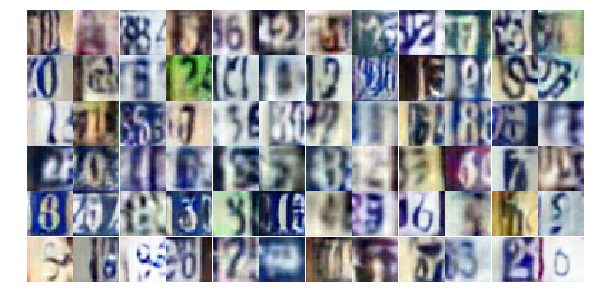

Epoch 15/25... Discriminator Loss: 0.6774... Generator Loss: 1.1107
Epoch 15/25... Discriminator Loss: 0.8376... Generator Loss: 0.8610
Epoch 15/25... Discriminator Loss: 0.5329... Generator Loss: 1.2591
Epoch 15/25... Discriminator Loss: 0.7002... Generator Loss: 1.0901
Epoch 15/25... Discriminator Loss: 0.6553... Generator Loss: 1.1251
Epoch 15/25... Discriminator Loss: 1.6581... Generator Loss: 2.9825
Epoch 15/25... Discriminator Loss: 1.0901... Generator Loss: 0.6011
Epoch 15/25... Discriminator Loss: 0.5893... Generator Loss: 1.2303
Epoch 15/25... Discriminator Loss: 0.6071... Generator Loss: 1.1630
Epoch 15/25... Discriminator Loss: 0.8083... Generator Loss: 0.8978


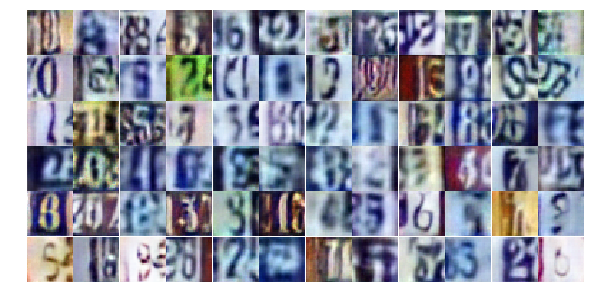

Epoch 15/25... Discriminator Loss: 0.7873... Generator Loss: 0.8894
Epoch 15/25... Discriminator Loss: 1.5312... Generator Loss: 0.3407
Epoch 15/25... Discriminator Loss: 0.9323... Generator Loss: 0.7234
Epoch 15/25... Discriminator Loss: 0.5772... Generator Loss: 1.3365
Epoch 15/25... Discriminator Loss: 0.5356... Generator Loss: 1.2681
Epoch 15/25... Discriminator Loss: 1.5540... Generator Loss: 0.4761
Epoch 15/25... Discriminator Loss: 0.5588... Generator Loss: 1.2307
Epoch 15/25... Discriminator Loss: 0.7917... Generator Loss: 0.9688
Epoch 15/25... Discriminator Loss: 0.8452... Generator Loss: 0.7628
Epoch 15/25... Discriminator Loss: 0.8083... Generator Loss: 1.5754


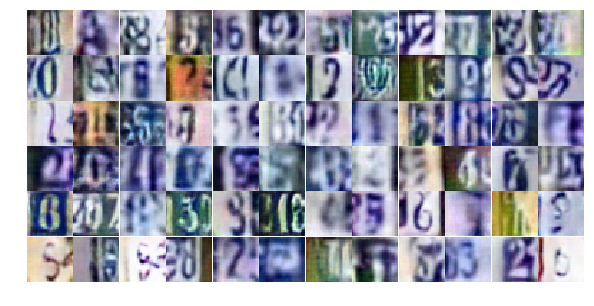

Epoch 15/25... Discriminator Loss: 1.4423... Generator Loss: 0.3872
Epoch 15/25... Discriminator Loss: 0.9220... Generator Loss: 0.8376
Epoch 15/25... Discriminator Loss: 0.6967... Generator Loss: 0.9534
Epoch 15/25... Discriminator Loss: 1.0011... Generator Loss: 2.3252
Epoch 15/25... Discriminator Loss: 0.6561... Generator Loss: 1.0376
Epoch 15/25... Discriminator Loss: 0.8094... Generator Loss: 1.2092
Epoch 15/25... Discriminator Loss: 1.1350... Generator Loss: 0.5647
Epoch 15/25... Discriminator Loss: 1.1756... Generator Loss: 0.5243
Epoch 15/25... Discriminator Loss: 1.5773... Generator Loss: 1.9713
Epoch 16/25... Discriminator Loss: 1.0461... Generator Loss: 0.6454


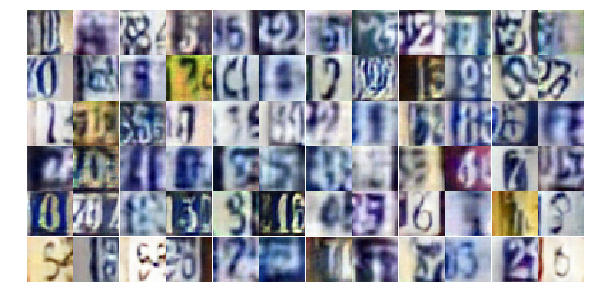

Epoch 16/25... Discriminator Loss: 0.9056... Generator Loss: 0.7200
Epoch 16/25... Discriminator Loss: 0.7753... Generator Loss: 1.0153
Epoch 16/25... Discriminator Loss: 1.2921... Generator Loss: 0.4559
Epoch 16/25... Discriminator Loss: 0.7611... Generator Loss: 0.9393
Epoch 16/25... Discriminator Loss: 0.7316... Generator Loss: 1.1298
Epoch 16/25... Discriminator Loss: 0.5764... Generator Loss: 2.0378
Epoch 16/25... Discriminator Loss: 1.3271... Generator Loss: 0.4626
Epoch 16/25... Discriminator Loss: 0.9960... Generator Loss: 0.6968
Epoch 16/25... Discriminator Loss: 0.6526... Generator Loss: 1.0198
Epoch 16/25... Discriminator Loss: 0.5371... Generator Loss: 1.2314


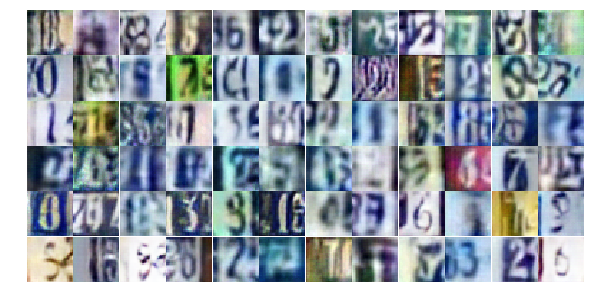

Epoch 16/25... Discriminator Loss: 1.3921... Generator Loss: 0.4524
Epoch 16/25... Discriminator Loss: 0.5785... Generator Loss: 1.2240
Epoch 16/25... Discriminator Loss: 0.9522... Generator Loss: 0.7294
Epoch 16/25... Discriminator Loss: 1.2887... Generator Loss: 0.4330
Epoch 16/25... Discriminator Loss: 0.5318... Generator Loss: 1.6325
Epoch 16/25... Discriminator Loss: 0.7755... Generator Loss: 0.8657
Epoch 16/25... Discriminator Loss: 0.9430... Generator Loss: 1.8600
Epoch 16/25... Discriminator Loss: 0.6916... Generator Loss: 1.0753
Epoch 16/25... Discriminator Loss: 0.6295... Generator Loss: 1.0360
Epoch 16/25... Discriminator Loss: 0.6075... Generator Loss: 1.2671


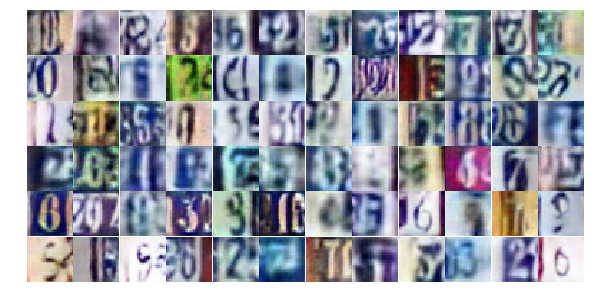

Epoch 16/25... Discriminator Loss: 0.6619... Generator Loss: 1.1086
Epoch 16/25... Discriminator Loss: 0.7558... Generator Loss: 1.0559
Epoch 16/25... Discriminator Loss: 0.9962... Generator Loss: 0.6423
Epoch 16/25... Discriminator Loss: 1.0959... Generator Loss: 0.5324
Epoch 16/25... Discriminator Loss: 0.7865... Generator Loss: 0.9816
Epoch 16/25... Discriminator Loss: 0.8620... Generator Loss: 0.9864
Epoch 16/25... Discriminator Loss: 0.8241... Generator Loss: 0.9422
Epoch 16/25... Discriminator Loss: 0.6479... Generator Loss: 1.1967
Epoch 16/25... Discriminator Loss: 0.9179... Generator Loss: 0.7459
Epoch 16/25... Discriminator Loss: 0.6824... Generator Loss: 0.9979


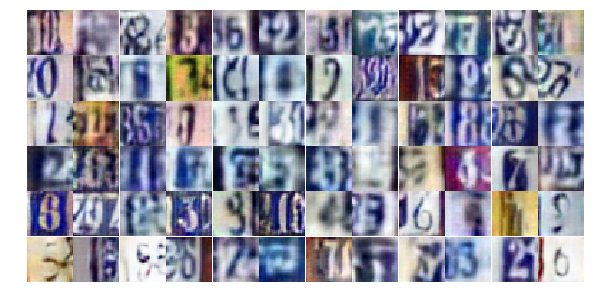

Epoch 16/25... Discriminator Loss: 0.9465... Generator Loss: 0.6834
Epoch 16/25... Discriminator Loss: 0.6304... Generator Loss: 1.0259
Epoch 16/25... Discriminator Loss: 0.6659... Generator Loss: 1.1502
Epoch 16/25... Discriminator Loss: 1.2264... Generator Loss: 2.2522
Epoch 16/25... Discriminator Loss: 0.8445... Generator Loss: 1.1056
Epoch 16/25... Discriminator Loss: 1.1339... Generator Loss: 0.5516
Epoch 16/25... Discriminator Loss: 1.2699... Generator Loss: 0.4662
Epoch 16/25... Discriminator Loss: 1.1324... Generator Loss: 0.5323
Epoch 16/25... Discriminator Loss: 1.1420... Generator Loss: 0.5480
Epoch 16/25... Discriminator Loss: 0.5172... Generator Loss: 1.3797


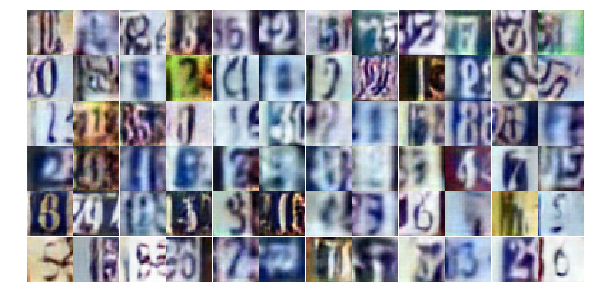

Epoch 16/25... Discriminator Loss: 0.5740... Generator Loss: 1.3770
Epoch 16/25... Discriminator Loss: 0.9040... Generator Loss: 0.8204
Epoch 16/25... Discriminator Loss: 1.1326... Generator Loss: 0.5648
Epoch 16/25... Discriminator Loss: 1.3599... Generator Loss: 0.4387
Epoch 16/25... Discriminator Loss: 0.8152... Generator Loss: 0.9959
Epoch 16/25... Discriminator Loss: 0.9276... Generator Loss: 0.7726
Epoch 16/25... Discriminator Loss: 0.4683... Generator Loss: 1.4546
Epoch 16/25... Discriminator Loss: 1.1375... Generator Loss: 0.5749
Epoch 16/25... Discriminator Loss: 0.6690... Generator Loss: 0.9866
Epoch 16/25... Discriminator Loss: 1.0490... Generator Loss: 0.6155


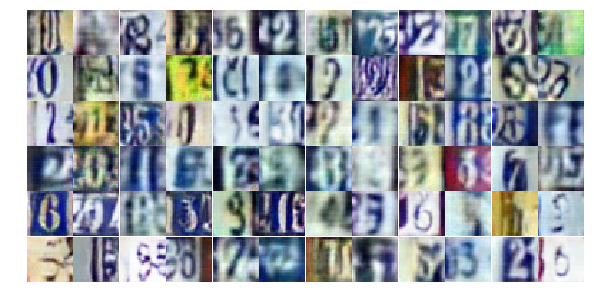

Epoch 16/25... Discriminator Loss: 0.9888... Generator Loss: 0.7626
Epoch 16/25... Discriminator Loss: 0.6148... Generator Loss: 1.2629
Epoch 16/25... Discriminator Loss: 2.4848... Generator Loss: 0.1413
Epoch 16/25... Discriminator Loss: 0.6646... Generator Loss: 2.7692
Epoch 16/25... Discriminator Loss: 0.6187... Generator Loss: 1.2896
Epoch 16/25... Discriminator Loss: 0.8555... Generator Loss: 0.8698
Epoch 17/25... Discriminator Loss: 0.7056... Generator Loss: 1.0660
Epoch 17/25... Discriminator Loss: 1.0071... Generator Loss: 0.6461
Epoch 17/25... Discriminator Loss: 0.7504... Generator Loss: 0.9554
Epoch 17/25... Discriminator Loss: 0.6473... Generator Loss: 1.1769


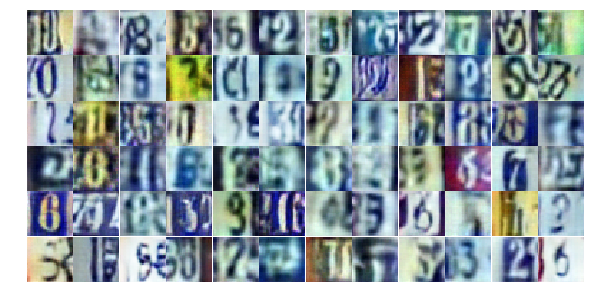

Epoch 17/25... Discriminator Loss: 0.4550... Generator Loss: 1.5732
Epoch 17/25... Discriminator Loss: 0.5364... Generator Loss: 1.2582
Epoch 17/25... Discriminator Loss: 0.8123... Generator Loss: 1.0511
Epoch 17/25... Discriminator Loss: 0.8273... Generator Loss: 0.7970
Epoch 17/25... Discriminator Loss: 0.9175... Generator Loss: 0.8070
Epoch 17/25... Discriminator Loss: 1.2802... Generator Loss: 0.4538
Epoch 17/25... Discriminator Loss: 0.9288... Generator Loss: 0.9068
Epoch 17/25... Discriminator Loss: 0.6835... Generator Loss: 0.9682
Epoch 17/25... Discriminator Loss: 0.4128... Generator Loss: 1.6606
Epoch 17/25... Discriminator Loss: 0.7344... Generator Loss: 0.9872


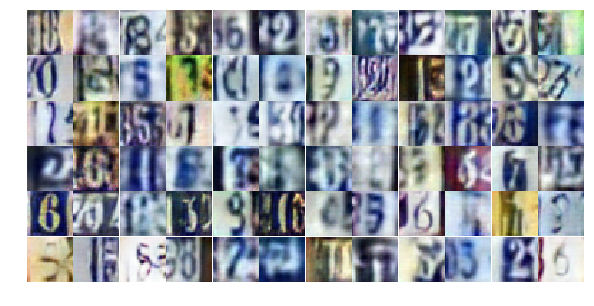

Epoch 17/25... Discriminator Loss: 0.9302... Generator Loss: 0.7585
Epoch 17/25... Discriminator Loss: 0.8480... Generator Loss: 0.9728
Epoch 17/25... Discriminator Loss: 0.8123... Generator Loss: 0.8290
Epoch 17/25... Discriminator Loss: 0.9889... Generator Loss: 0.9167
Epoch 17/25... Discriminator Loss: 0.5602... Generator Loss: 1.2612
Epoch 17/25... Discriminator Loss: 0.9783... Generator Loss: 0.6586
Epoch 17/25... Discriminator Loss: 0.6635... Generator Loss: 1.0541
Epoch 17/25... Discriminator Loss: 0.6253... Generator Loss: 1.0471
Epoch 17/25... Discriminator Loss: 0.6820... Generator Loss: 0.9716
Epoch 17/25... Discriminator Loss: 0.6302... Generator Loss: 1.0189


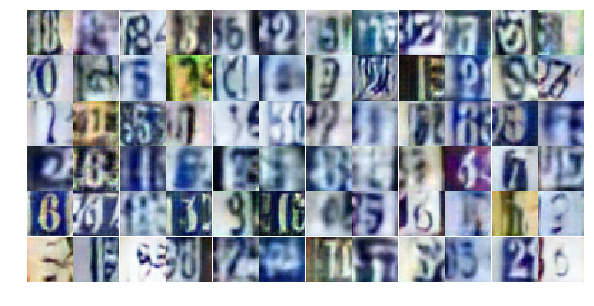

Epoch 17/25... Discriminator Loss: 1.6719... Generator Loss: 0.3437
Epoch 17/25... Discriminator Loss: 0.4789... Generator Loss: 1.5461
Epoch 17/25... Discriminator Loss: 0.4051... Generator Loss: 2.3134
Epoch 17/25... Discriminator Loss: 1.3147... Generator Loss: 0.4329
Epoch 17/25... Discriminator Loss: 1.4049... Generator Loss: 0.3983
Epoch 17/25... Discriminator Loss: 0.6659... Generator Loss: 1.0303
Epoch 17/25... Discriminator Loss: 0.7809... Generator Loss: 0.9295
Epoch 17/25... Discriminator Loss: 0.8985... Generator Loss: 0.7926
Epoch 17/25... Discriminator Loss: 0.9227... Generator Loss: 0.6876
Epoch 17/25... Discriminator Loss: 0.4747... Generator Loss: 1.6358


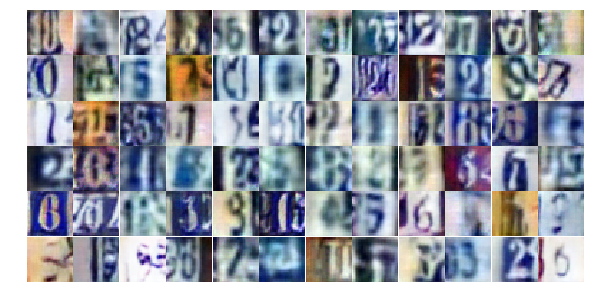

Epoch 17/25... Discriminator Loss: 0.5824... Generator Loss: 1.4528
Epoch 17/25... Discriminator Loss: 1.0050... Generator Loss: 0.6701
Epoch 17/25... Discriminator Loss: 0.6057... Generator Loss: 1.6004
Epoch 17/25... Discriminator Loss: 0.9993... Generator Loss: 0.8457
Epoch 17/25... Discriminator Loss: 0.9027... Generator Loss: 0.8320
Epoch 17/25... Discriminator Loss: 0.7907... Generator Loss: 0.9502
Epoch 17/25... Discriminator Loss: 0.8207... Generator Loss: 1.2862
Epoch 17/25... Discriminator Loss: 0.5018... Generator Loss: 1.3999
Epoch 17/25... Discriminator Loss: 0.3626... Generator Loss: 1.7648
Epoch 17/25... Discriminator Loss: 1.2071... Generator Loss: 0.5285


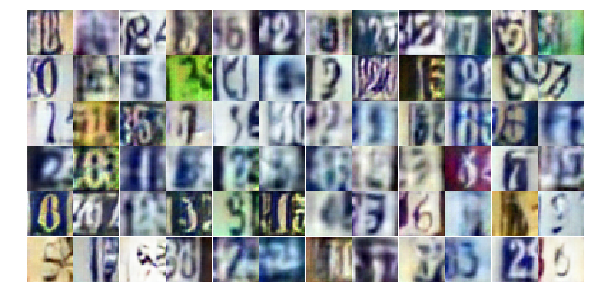

Epoch 17/25... Discriminator Loss: 1.6078... Generator Loss: 1.7785
Epoch 17/25... Discriminator Loss: 0.6085... Generator Loss: 1.1180
Epoch 17/25... Discriminator Loss: 0.7797... Generator Loss: 1.1549
Epoch 17/25... Discriminator Loss: 0.4299... Generator Loss: 1.4705
Epoch 17/25... Discriminator Loss: 0.9501... Generator Loss: 0.8143
Epoch 17/25... Discriminator Loss: 1.0042... Generator Loss: 0.6716
Epoch 17/25... Discriminator Loss: 1.2858... Generator Loss: 0.4528
Epoch 17/25... Discriminator Loss: 1.0494... Generator Loss: 0.5823
Epoch 17/25... Discriminator Loss: 0.6805... Generator Loss: 1.0952
Epoch 17/25... Discriminator Loss: 1.5120... Generator Loss: 0.3452


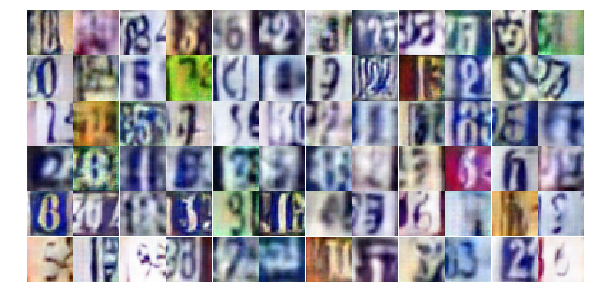

Epoch 17/25... Discriminator Loss: 0.7096... Generator Loss: 1.4086
Epoch 17/25... Discriminator Loss: 0.9720... Generator Loss: 2.2795
Epoch 17/25... Discriminator Loss: 0.7393... Generator Loss: 0.9594
Epoch 17/25... Discriminator Loss: 0.7991... Generator Loss: 0.9365
Epoch 18/25... Discriminator Loss: 0.8381... Generator Loss: 0.8312
Epoch 18/25... Discriminator Loss: 1.4837... Generator Loss: 0.3967
Epoch 18/25... Discriminator Loss: 0.9104... Generator Loss: 0.8004
Epoch 18/25... Discriminator Loss: 0.7878... Generator Loss: 0.8195
Epoch 18/25... Discriminator Loss: 0.7548... Generator Loss: 1.3878
Epoch 18/25... Discriminator Loss: 0.6476... Generator Loss: 1.4649


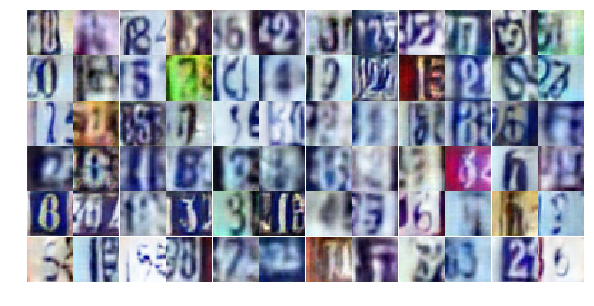

Epoch 18/25... Discriminator Loss: 0.6961... Generator Loss: 3.2704
Epoch 18/25... Discriminator Loss: 0.8989... Generator Loss: 0.9430
Epoch 18/25... Discriminator Loss: 0.9201... Generator Loss: 0.7778
Epoch 18/25... Discriminator Loss: 0.5276... Generator Loss: 1.5300
Epoch 18/25... Discriminator Loss: 0.8735... Generator Loss: 0.7529
Epoch 18/25... Discriminator Loss: 0.8910... Generator Loss: 0.7528
Epoch 18/25... Discriminator Loss: 0.5809... Generator Loss: 1.1398
Epoch 18/25... Discriminator Loss: 1.1455... Generator Loss: 0.5143
Epoch 18/25... Discriminator Loss: 1.0052... Generator Loss: 0.6561
Epoch 18/25... Discriminator Loss: 0.3416... Generator Loss: 1.7030


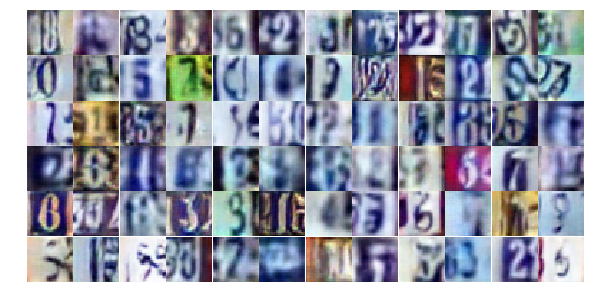

Epoch 18/25... Discriminator Loss: 0.5246... Generator Loss: 1.6747
Epoch 18/25... Discriminator Loss: 1.4387... Generator Loss: 2.7653
Epoch 18/25... Discriminator Loss: 0.9438... Generator Loss: 1.3289
Epoch 18/25... Discriminator Loss: 0.6806... Generator Loss: 1.0507
Epoch 18/25... Discriminator Loss: 1.0699... Generator Loss: 0.6413
Epoch 18/25... Discriminator Loss: 1.3580... Generator Loss: 0.4348
Epoch 18/25... Discriminator Loss: 0.9984... Generator Loss: 0.7838
Epoch 18/25... Discriminator Loss: 1.0163... Generator Loss: 0.6444
Epoch 18/25... Discriminator Loss: 0.8706... Generator Loss: 0.7286
Epoch 18/25... Discriminator Loss: 0.6758... Generator Loss: 1.1290


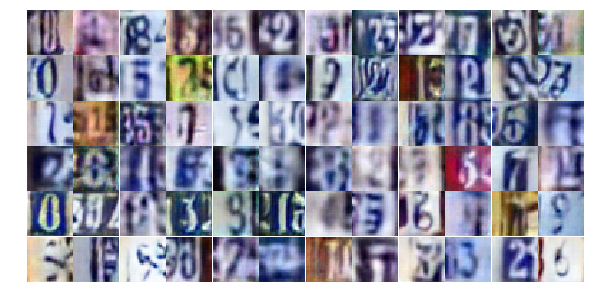

Epoch 18/25... Discriminator Loss: 0.4035... Generator Loss: 1.8188
Epoch 18/25... Discriminator Loss: 0.7919... Generator Loss: 1.1296
Epoch 18/25... Discriminator Loss: 0.9072... Generator Loss: 0.7225
Epoch 18/25... Discriminator Loss: 0.9736... Generator Loss: 0.7274
Epoch 18/25... Discriminator Loss: 0.9681... Generator Loss: 0.6488
Epoch 18/25... Discriminator Loss: 0.7839... Generator Loss: 1.0394
Epoch 18/25... Discriminator Loss: 1.0863... Generator Loss: 0.6110
Epoch 18/25... Discriminator Loss: 0.4849... Generator Loss: 1.6146
Epoch 18/25... Discriminator Loss: 0.7438... Generator Loss: 0.8470
Epoch 18/25... Discriminator Loss: 0.7638... Generator Loss: 0.9906


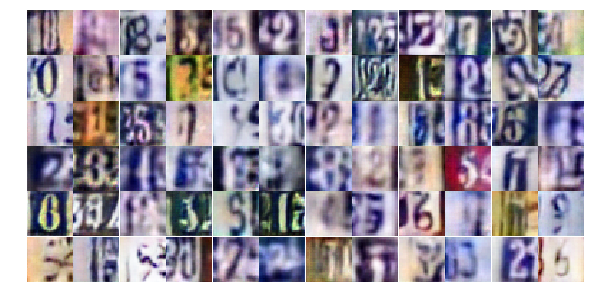

Epoch 18/25... Discriminator Loss: 0.8219... Generator Loss: 1.7673
Epoch 18/25... Discriminator Loss: 0.6879... Generator Loss: 0.9715
Epoch 18/25... Discriminator Loss: 0.7405... Generator Loss: 0.9263
Epoch 18/25... Discriminator Loss: 0.6961... Generator Loss: 1.0935
Epoch 18/25... Discriminator Loss: 0.9846... Generator Loss: 0.6676
Epoch 18/25... Discriminator Loss: 0.4069... Generator Loss: 1.5632
Epoch 18/25... Discriminator Loss: 1.0466... Generator Loss: 0.5781
Epoch 18/25... Discriminator Loss: 1.4345... Generator Loss: 2.4358
Epoch 18/25... Discriminator Loss: 1.5466... Generator Loss: 0.3707
Epoch 18/25... Discriminator Loss: 0.4569... Generator Loss: 2.0280


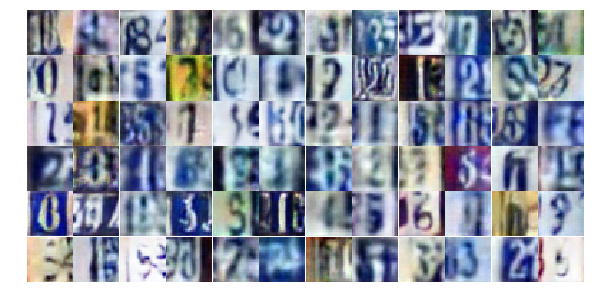

Epoch 18/25... Discriminator Loss: 0.7344... Generator Loss: 0.9824
Epoch 18/25... Discriminator Loss: 0.9026... Generator Loss: 0.7058
Epoch 18/25... Discriminator Loss: 1.0512... Generator Loss: 0.6046
Epoch 18/25... Discriminator Loss: 1.3743... Generator Loss: 0.4319
Epoch 18/25... Discriminator Loss: 0.7997... Generator Loss: 0.8713
Epoch 18/25... Discriminator Loss: 0.7679... Generator Loss: 1.1655
Epoch 18/25... Discriminator Loss: 0.5703... Generator Loss: 1.3739
Epoch 18/25... Discriminator Loss: 0.5423... Generator Loss: 1.2748
Epoch 18/25... Discriminator Loss: 0.9584... Generator Loss: 0.8165
Epoch 18/25... Discriminator Loss: 0.9154... Generator Loss: 0.6989


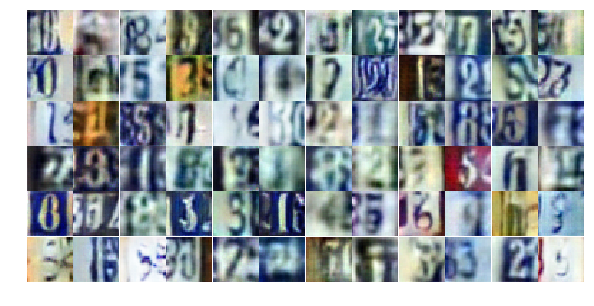

Epoch 18/25... Discriminator Loss: 0.5653... Generator Loss: 2.1810
Epoch 19/25... Discriminator Loss: 0.8361... Generator Loss: 0.9788
Epoch 19/25... Discriminator Loss: 1.1893... Generator Loss: 0.5537
Epoch 19/25... Discriminator Loss: 0.8552... Generator Loss: 1.1959
Epoch 19/25... Discriminator Loss: 0.6315... Generator Loss: 1.0973
Epoch 19/25... Discriminator Loss: 0.8744... Generator Loss: 0.7722
Epoch 19/25... Discriminator Loss: 0.7613... Generator Loss: 0.9253
Epoch 19/25... Discriminator Loss: 0.8039... Generator Loss: 0.9305
Epoch 19/25... Discriminator Loss: 0.6835... Generator Loss: 1.9024
Epoch 19/25... Discriminator Loss: 0.9272... Generator Loss: 0.8565


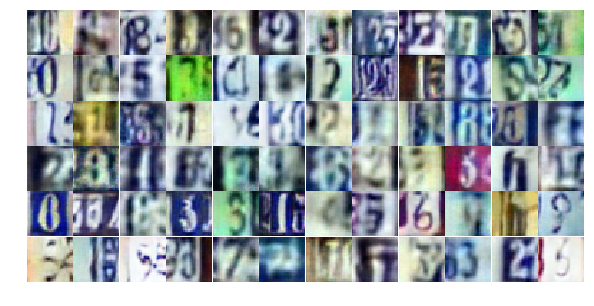

Epoch 19/25... Discriminator Loss: 0.6000... Generator Loss: 1.1152
Epoch 19/25... Discriminator Loss: 0.7007... Generator Loss: 0.9906
Epoch 19/25... Discriminator Loss: 0.8407... Generator Loss: 1.0752
Epoch 19/25... Discriminator Loss: 0.8713... Generator Loss: 0.7007
Epoch 19/25... Discriminator Loss: 0.8544... Generator Loss: 0.7252
Epoch 19/25... Discriminator Loss: 0.6138... Generator Loss: 1.2266
Epoch 19/25... Discriminator Loss: 1.7436... Generator Loss: 0.3786
Epoch 19/25... Discriminator Loss: 0.7721... Generator Loss: 0.9519
Epoch 19/25... Discriminator Loss: 0.9666... Generator Loss: 1.6579
Epoch 19/25... Discriminator Loss: 1.6616... Generator Loss: 0.3252


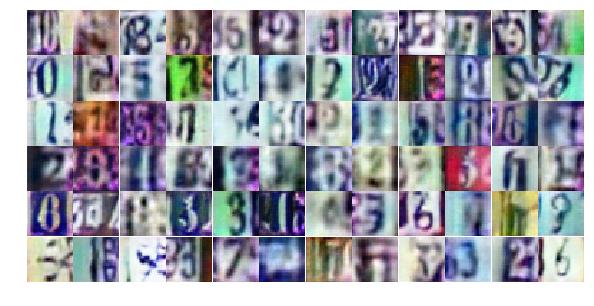

Epoch 19/25... Discriminator Loss: 1.4411... Generator Loss: 0.4019
Epoch 19/25... Discriminator Loss: 1.3620... Generator Loss: 0.4567
Epoch 19/25... Discriminator Loss: 1.2475... Generator Loss: 0.4709
Epoch 19/25... Discriminator Loss: 0.7585... Generator Loss: 1.0256
Epoch 19/25... Discriminator Loss: 1.2829... Generator Loss: 0.4972
Epoch 19/25... Discriminator Loss: 1.0422... Generator Loss: 0.6448
Epoch 19/25... Discriminator Loss: 0.6875... Generator Loss: 1.1215
Epoch 19/25... Discriminator Loss: 0.6094... Generator Loss: 1.1665
Epoch 19/25... Discriminator Loss: 0.9305... Generator Loss: 0.7425
Epoch 19/25... Discriminator Loss: 1.0818... Generator Loss: 0.6117


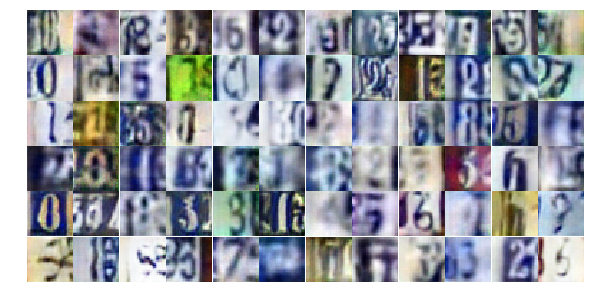

Epoch 19/25... Discriminator Loss: 0.9006... Generator Loss: 0.7831
Epoch 19/25... Discriminator Loss: 0.6974... Generator Loss: 1.0006
Epoch 19/25... Discriminator Loss: 0.9057... Generator Loss: 0.8001
Epoch 19/25... Discriminator Loss: 0.5919... Generator Loss: 1.1813
Epoch 19/25... Discriminator Loss: 0.6014... Generator Loss: 1.1227
Epoch 19/25... Discriminator Loss: 0.9193... Generator Loss: 0.7590
Epoch 19/25... Discriminator Loss: 0.9837... Generator Loss: 0.7513
Epoch 19/25... Discriminator Loss: 0.6182... Generator Loss: 1.2683
Epoch 19/25... Discriminator Loss: 0.8735... Generator Loss: 1.0208
Epoch 19/25... Discriminator Loss: 0.4925... Generator Loss: 2.0368


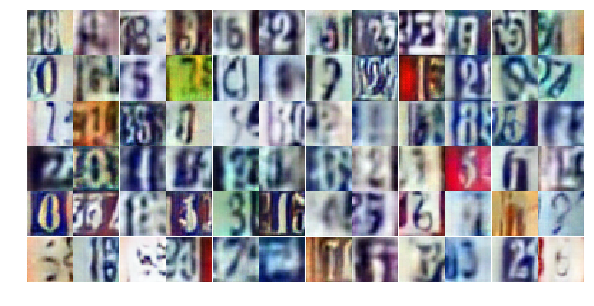

Epoch 19/25... Discriminator Loss: 0.7294... Generator Loss: 1.0005
Epoch 19/25... Discriminator Loss: 1.1725... Generator Loss: 0.5614
Epoch 19/25... Discriminator Loss: 0.8457... Generator Loss: 0.8310
Epoch 19/25... Discriminator Loss: 0.7135... Generator Loss: 0.9666
Epoch 19/25... Discriminator Loss: 0.6913... Generator Loss: 1.4741
Epoch 19/25... Discriminator Loss: 2.6126... Generator Loss: 3.8167
Epoch 19/25... Discriminator Loss: 0.7709... Generator Loss: 1.0447
Epoch 19/25... Discriminator Loss: 0.6266... Generator Loss: 1.4148
Epoch 19/25... Discriminator Loss: 0.6998... Generator Loss: 1.1960
Epoch 19/25... Discriminator Loss: 1.0329... Generator Loss: 0.6204


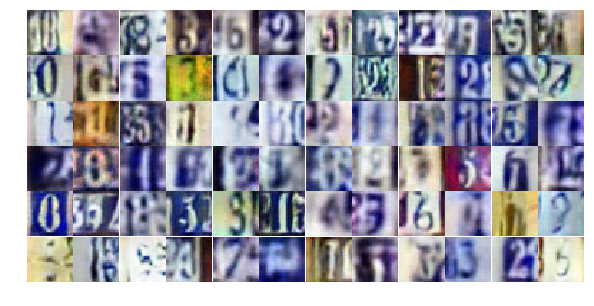

Epoch 19/25... Discriminator Loss: 1.2219... Generator Loss: 0.4846
Epoch 19/25... Discriminator Loss: 0.6543... Generator Loss: 1.2462
Epoch 19/25... Discriminator Loss: 0.7545... Generator Loss: 2.1207
Epoch 19/25... Discriminator Loss: 0.9261... Generator Loss: 0.7866
Epoch 19/25... Discriminator Loss: 1.0600... Generator Loss: 0.6561
Epoch 19/25... Discriminator Loss: 0.7371... Generator Loss: 1.1741
Epoch 19/25... Discriminator Loss: 2.0336... Generator Loss: 0.2276
Epoch 19/25... Discriminator Loss: 1.0327... Generator Loss: 0.6487
Epoch 20/25... Discriminator Loss: 0.8910... Generator Loss: 0.7834
Epoch 20/25... Discriminator Loss: 0.8862... Generator Loss: 0.7802


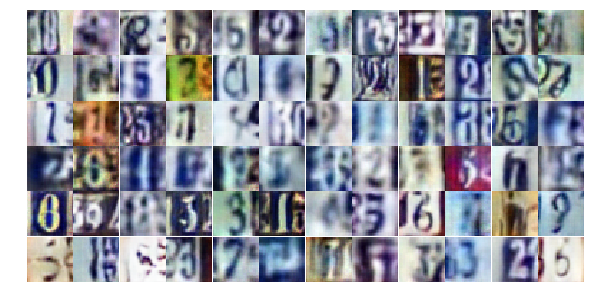

Epoch 20/25... Discriminator Loss: 0.5277... Generator Loss: 1.3415
Epoch 20/25... Discriminator Loss: 0.7223... Generator Loss: 0.9620
Epoch 20/25... Discriminator Loss: 1.2814... Generator Loss: 0.4966
Epoch 20/25... Discriminator Loss: 1.2178... Generator Loss: 0.4921
Epoch 20/25... Discriminator Loss: 0.5506... Generator Loss: 2.1425
Epoch 20/25... Discriminator Loss: 0.8150... Generator Loss: 0.8636
Epoch 20/25... Discriminator Loss: 0.7558... Generator Loss: 0.9081
Epoch 20/25... Discriminator Loss: 0.6898... Generator Loss: 1.2888
Epoch 20/25... Discriminator Loss: 1.0289... Generator Loss: 0.6136
Epoch 20/25... Discriminator Loss: 0.6030... Generator Loss: 1.0490


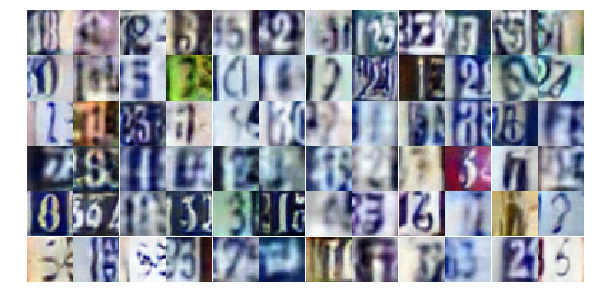

Epoch 20/25... Discriminator Loss: 1.3427... Generator Loss: 0.4640
Epoch 20/25... Discriminator Loss: 1.1258... Generator Loss: 0.5901
Epoch 20/25... Discriminator Loss: 0.7663... Generator Loss: 1.0873
Epoch 20/25... Discriminator Loss: 0.5976... Generator Loss: 1.3822
Epoch 20/25... Discriminator Loss: 1.1684... Generator Loss: 0.5246
Epoch 20/25... Discriminator Loss: 1.1009... Generator Loss: 0.6052
Epoch 20/25... Discriminator Loss: 1.2038... Generator Loss: 0.4764
Epoch 20/25... Discriminator Loss: 0.6448... Generator Loss: 1.3085
Epoch 20/25... Discriminator Loss: 1.0480... Generator Loss: 0.8262
Epoch 20/25... Discriminator Loss: 1.0979... Generator Loss: 0.5936


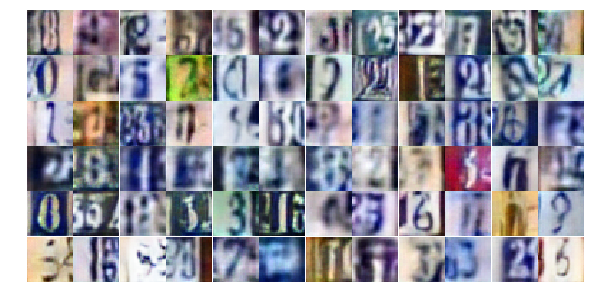

Epoch 20/25... Discriminator Loss: 0.5502... Generator Loss: 1.2673
Epoch 20/25... Discriminator Loss: 0.8277... Generator Loss: 0.8560
Epoch 20/25... Discriminator Loss: 0.6216... Generator Loss: 2.2045
Epoch 20/25... Discriminator Loss: 1.1777... Generator Loss: 0.6023
Epoch 20/25... Discriminator Loss: 0.9756... Generator Loss: 0.7192
Epoch 20/25... Discriminator Loss: 0.6450... Generator Loss: 1.0465
Epoch 20/25... Discriminator Loss: 0.7495... Generator Loss: 2.4046
Epoch 20/25... Discriminator Loss: 1.8967... Generator Loss: 0.2529
Epoch 20/25... Discriminator Loss: 1.1559... Generator Loss: 0.5238
Epoch 20/25... Discriminator Loss: 0.3703... Generator Loss: 1.5495


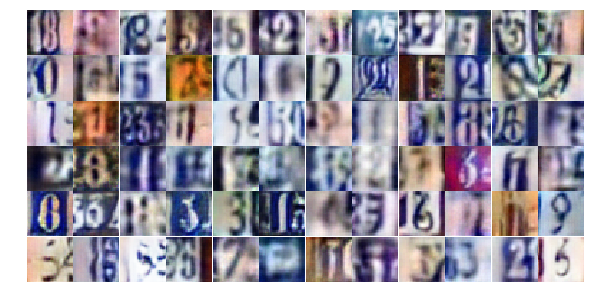

Epoch 20/25... Discriminator Loss: 0.9159... Generator Loss: 0.9622
Epoch 20/25... Discriminator Loss: 0.7909... Generator Loss: 0.8367
Epoch 20/25... Discriminator Loss: 1.4868... Generator Loss: 0.4437
Epoch 20/25... Discriminator Loss: 0.8758... Generator Loss: 0.9069
Epoch 20/25... Discriminator Loss: 0.6516... Generator Loss: 1.4023
Epoch 20/25... Discriminator Loss: 1.0544... Generator Loss: 0.6508
Epoch 20/25... Discriminator Loss: 0.9550... Generator Loss: 0.7157
Epoch 20/25... Discriminator Loss: 1.1329... Generator Loss: 2.4114
Epoch 20/25... Discriminator Loss: 1.2007... Generator Loss: 0.5327
Epoch 20/25... Discriminator Loss: 1.2661... Generator Loss: 0.5516


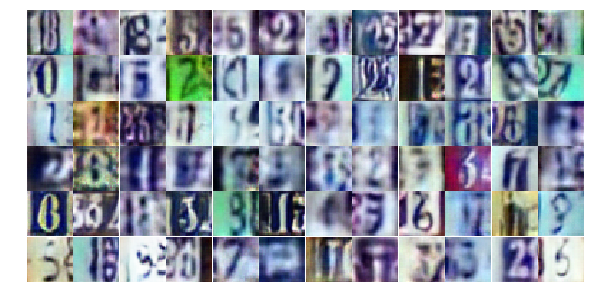

Epoch 20/25... Discriminator Loss: 0.6599... Generator Loss: 1.1000
Epoch 20/25... Discriminator Loss: 0.7954... Generator Loss: 1.1959
Epoch 20/25... Discriminator Loss: 2.2267... Generator Loss: 3.0920
Epoch 20/25... Discriminator Loss: 2.0979... Generator Loss: 0.2147
Epoch 20/25... Discriminator Loss: 0.9178... Generator Loss: 0.8704
Epoch 20/25... Discriminator Loss: 1.0973... Generator Loss: 0.6323
Epoch 20/25... Discriminator Loss: 1.2741... Generator Loss: 0.5220
Epoch 20/25... Discriminator Loss: 0.6762... Generator Loss: 1.2096
Epoch 20/25... Discriminator Loss: 0.7955... Generator Loss: 1.0325
Epoch 20/25... Discriminator Loss: 0.6929... Generator Loss: 1.1083


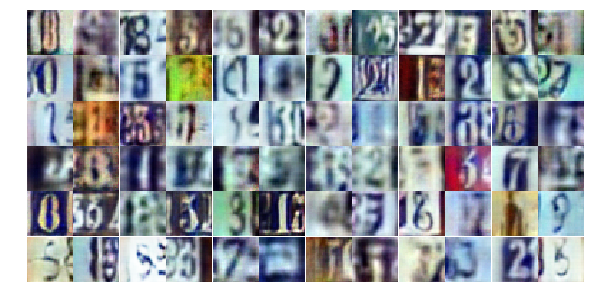

Epoch 20/25... Discriminator Loss: 0.5810... Generator Loss: 1.3146
Epoch 20/25... Discriminator Loss: 1.2628... Generator Loss: 0.4600
Epoch 20/25... Discriminator Loss: 0.5625... Generator Loss: 1.3015
Epoch 20/25... Discriminator Loss: 0.8655... Generator Loss: 1.8301
Epoch 20/25... Discriminator Loss: 0.6003... Generator Loss: 1.1353
Epoch 20/25... Discriminator Loss: 1.0783... Generator Loss: 0.5739
Epoch 21/25... Discriminator Loss: 0.8785... Generator Loss: 1.0139
Epoch 21/25... Discriminator Loss: 0.9534... Generator Loss: 0.6720
Epoch 21/25... Discriminator Loss: 0.9230... Generator Loss: 0.8405
Epoch 21/25... Discriminator Loss: 1.3956... Generator Loss: 0.4186


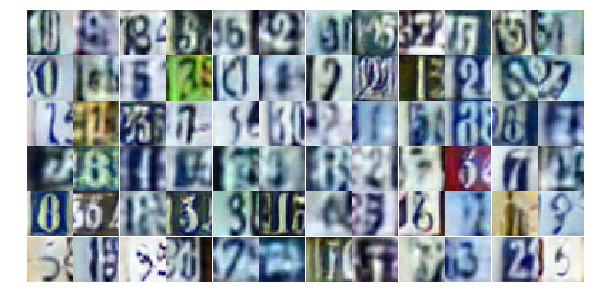

Epoch 21/25... Discriminator Loss: 0.8744... Generator Loss: 0.7486
Epoch 21/25... Discriminator Loss: 1.9659... Generator Loss: 0.2226
Epoch 21/25... Discriminator Loss: 0.6920... Generator Loss: 1.1270
Epoch 21/25... Discriminator Loss: 0.5064... Generator Loss: 1.6305
Epoch 21/25... Discriminator Loss: 0.8476... Generator Loss: 0.7781
Epoch 21/25... Discriminator Loss: 0.5192... Generator Loss: 1.3261
Epoch 21/25... Discriminator Loss: 0.6547... Generator Loss: 1.2414
Epoch 21/25... Discriminator Loss: 0.7374... Generator Loss: 1.3394
Epoch 21/25... Discriminator Loss: 0.7006... Generator Loss: 0.9842
Epoch 21/25... Discriminator Loss: 1.1165... Generator Loss: 0.5666


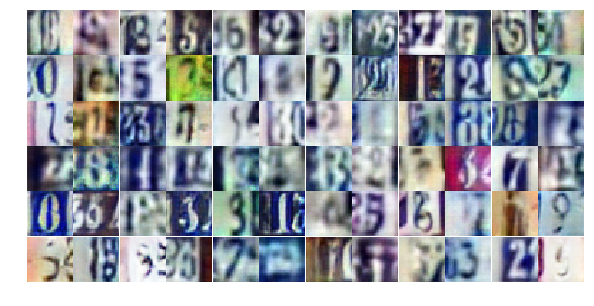

Epoch 21/25... Discriminator Loss: 0.3231... Generator Loss: 1.5638
Epoch 21/25... Discriminator Loss: 0.6662... Generator Loss: 1.1407
Epoch 21/25... Discriminator Loss: 2.0069... Generator Loss: 0.2857
Epoch 21/25... Discriminator Loss: 1.5393... Generator Loss: 0.5076
Epoch 21/25... Discriminator Loss: 0.7198... Generator Loss: 1.0969
Epoch 21/25... Discriminator Loss: 1.0989... Generator Loss: 0.6188
Epoch 21/25... Discriminator Loss: 0.6411... Generator Loss: 1.4292
Epoch 21/25... Discriminator Loss: 0.5855... Generator Loss: 1.2181
Epoch 21/25... Discriminator Loss: 0.4671... Generator Loss: 1.8839
Epoch 21/25... Discriminator Loss: 0.8002... Generator Loss: 0.8382


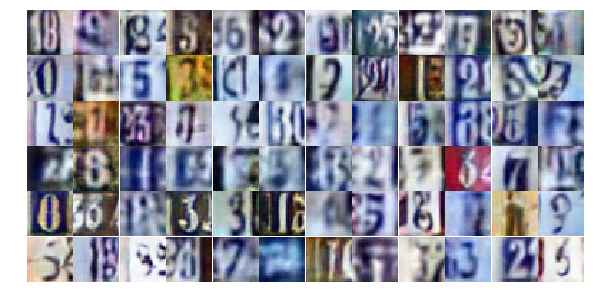

Epoch 21/25... Discriminator Loss: 1.0347... Generator Loss: 0.6532
Epoch 21/25... Discriminator Loss: 0.3703... Generator Loss: 1.8652
Epoch 21/25... Discriminator Loss: 1.2338... Generator Loss: 0.5371
Epoch 21/25... Discriminator Loss: 0.8158... Generator Loss: 0.8479
Epoch 21/25... Discriminator Loss: 0.7958... Generator Loss: 0.9086
Epoch 21/25... Discriminator Loss: 0.7928... Generator Loss: 0.9593
Epoch 21/25... Discriminator Loss: 0.6096... Generator Loss: 1.0227
Epoch 21/25... Discriminator Loss: 1.1249... Generator Loss: 0.5718
Epoch 21/25... Discriminator Loss: 1.5268... Generator Loss: 0.3822
Epoch 21/25... Discriminator Loss: 2.0325... Generator Loss: 0.2496


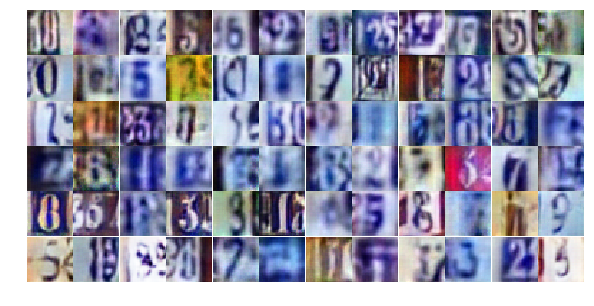

Epoch 21/25... Discriminator Loss: 1.3575... Generator Loss: 0.4828
Epoch 21/25... Discriminator Loss: 0.9131... Generator Loss: 0.8458
Epoch 21/25... Discriminator Loss: 0.9911... Generator Loss: 0.6962
Epoch 21/25... Discriminator Loss: 0.4110... Generator Loss: 2.7825
Epoch 21/25... Discriminator Loss: 0.5181... Generator Loss: 1.2883
Epoch 21/25... Discriminator Loss: 0.6200... Generator Loss: 1.0779
Epoch 21/25... Discriminator Loss: 1.2051... Generator Loss: 0.6435
Epoch 21/25... Discriminator Loss: 1.4957... Generator Loss: 0.3514
Epoch 21/25... Discriminator Loss: 0.9774... Generator Loss: 0.7058
Epoch 21/25... Discriminator Loss: 0.3348... Generator Loss: 2.3016


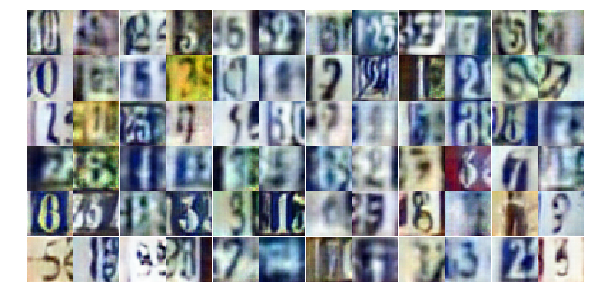

Epoch 21/25... Discriminator Loss: 0.8956... Generator Loss: 0.7607
Epoch 21/25... Discriminator Loss: 1.0841... Generator Loss: 0.5760
Epoch 21/25... Discriminator Loss: 0.7850... Generator Loss: 0.9591
Epoch 21/25... Discriminator Loss: 0.8511... Generator Loss: 0.8767
Epoch 21/25... Discriminator Loss: 0.4702... Generator Loss: 1.6216
Epoch 21/25... Discriminator Loss: 0.6631... Generator Loss: 1.0856
Epoch 21/25... Discriminator Loss: 0.9907... Generator Loss: 0.6144
Epoch 21/25... Discriminator Loss: 0.9011... Generator Loss: 0.7560
Epoch 21/25... Discriminator Loss: 1.4171... Generator Loss: 0.3987
Epoch 21/25... Discriminator Loss: 0.4680... Generator Loss: 1.3959


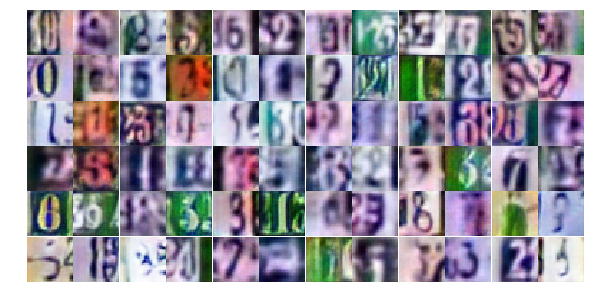

Epoch 21/25... Discriminator Loss: 0.7352... Generator Loss: 0.9100
Epoch 21/25... Discriminator Loss: 1.2907... Generator Loss: 0.4803
Epoch 21/25... Discriminator Loss: 1.2380... Generator Loss: 0.6454
Epoch 22/25... Discriminator Loss: 0.8691... Generator Loss: 0.9342
Epoch 22/25... Discriminator Loss: 1.0343... Generator Loss: 0.7147
Epoch 22/25... Discriminator Loss: 0.8260... Generator Loss: 1.0682
Epoch 22/25... Discriminator Loss: 0.4138... Generator Loss: 1.6487
Epoch 22/25... Discriminator Loss: 0.5184... Generator Loss: 1.3353
Epoch 22/25... Discriminator Loss: 1.8922... Generator Loss: 0.2570
Epoch 22/25... Discriminator Loss: 0.7599... Generator Loss: 1.3273


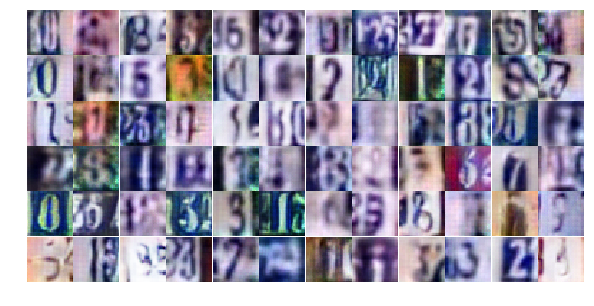

Epoch 22/25... Discriminator Loss: 0.5138... Generator Loss: 1.5746
Epoch 22/25... Discriminator Loss: 0.9072... Generator Loss: 0.8594
Epoch 22/25... Discriminator Loss: 1.1445... Generator Loss: 0.5979
Epoch 22/25... Discriminator Loss: 0.8184... Generator Loss: 0.8444
Epoch 22/25... Discriminator Loss: 0.8857... Generator Loss: 0.7887
Epoch 22/25... Discriminator Loss: 0.5825... Generator Loss: 1.4730
Epoch 22/25... Discriminator Loss: 0.9053... Generator Loss: 0.8025
Epoch 22/25... Discriminator Loss: 0.6753... Generator Loss: 1.2445
Epoch 22/25... Discriminator Loss: 0.9141... Generator Loss: 0.7626
Epoch 22/25... Discriminator Loss: 1.7201... Generator Loss: 0.3395


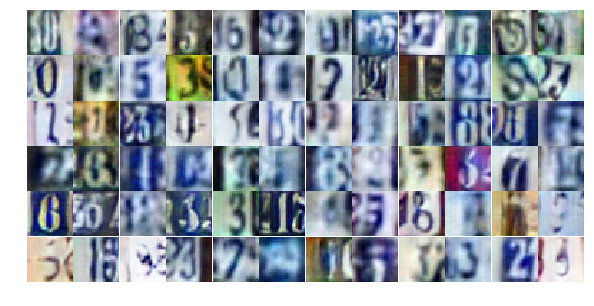

Epoch 22/25... Discriminator Loss: 0.4778... Generator Loss: 1.7217
Epoch 22/25... Discriminator Loss: 0.8773... Generator Loss: 0.7576
Epoch 22/25... Discriminator Loss: 0.7851... Generator Loss: 0.8283
Epoch 22/25... Discriminator Loss: 0.5014... Generator Loss: 1.8214
Epoch 22/25... Discriminator Loss: 0.6783... Generator Loss: 1.4274
Epoch 22/25... Discriminator Loss: 1.1465... Generator Loss: 0.6165
Epoch 22/25... Discriminator Loss: 0.7462... Generator Loss: 2.9632
Epoch 22/25... Discriminator Loss: 0.5045... Generator Loss: 1.4739
Epoch 22/25... Discriminator Loss: 0.6531... Generator Loss: 1.1020
Epoch 22/25... Discriminator Loss: 1.5118... Generator Loss: 0.3443


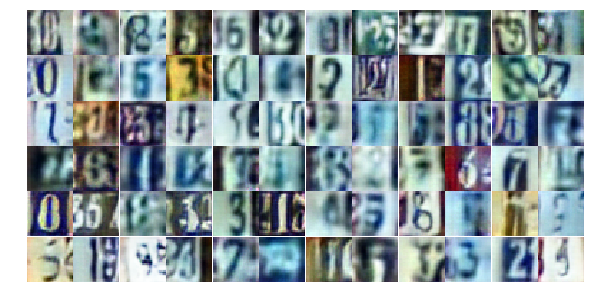

Epoch 22/25... Discriminator Loss: 0.5696... Generator Loss: 1.2049
Epoch 22/25... Discriminator Loss: 0.5440... Generator Loss: 1.3181
Epoch 22/25... Discriminator Loss: 0.7198... Generator Loss: 1.0012
Epoch 22/25... Discriminator Loss: 0.7301... Generator Loss: 0.9536
Epoch 22/25... Discriminator Loss: 0.8167... Generator Loss: 0.9026
Epoch 22/25... Discriminator Loss: 0.7093... Generator Loss: 1.0937
Epoch 22/25... Discriminator Loss: 1.8275... Generator Loss: 0.2466
Epoch 22/25... Discriminator Loss: 0.7549... Generator Loss: 2.9856
Epoch 22/25... Discriminator Loss: 1.2076... Generator Loss: 0.5948
Epoch 22/25... Discriminator Loss: 1.0090... Generator Loss: 0.6578


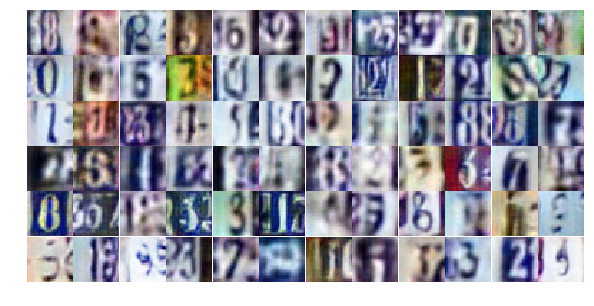

Epoch 22/25... Discriminator Loss: 1.3609... Generator Loss: 0.4699
Epoch 22/25... Discriminator Loss: 0.7438... Generator Loss: 1.0370
Epoch 22/25... Discriminator Loss: 0.4034... Generator Loss: 1.7693
Epoch 22/25... Discriminator Loss: 0.8057... Generator Loss: 0.9043
Epoch 22/25... Discriminator Loss: 0.6346... Generator Loss: 1.0413
Epoch 22/25... Discriminator Loss: 0.4800... Generator Loss: 1.3832
Epoch 22/25... Discriminator Loss: 0.5102... Generator Loss: 2.3034
Epoch 22/25... Discriminator Loss: 1.3279... Generator Loss: 0.4883
Epoch 22/25... Discriminator Loss: 1.0635... Generator Loss: 0.7065
Epoch 22/25... Discriminator Loss: 1.0507... Generator Loss: 0.6000


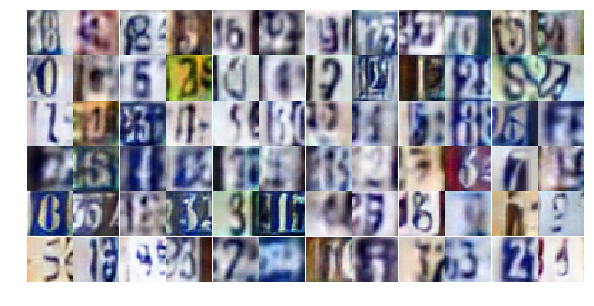

Epoch 22/25... Discriminator Loss: 1.1732... Generator Loss: 0.6198
Epoch 22/25... Discriminator Loss: 0.8306... Generator Loss: 0.7676
Epoch 22/25... Discriminator Loss: 0.9220... Generator Loss: 0.6810
Epoch 22/25... Discriminator Loss: 0.7280... Generator Loss: 0.9771
Epoch 22/25... Discriminator Loss: 0.6711... Generator Loss: 1.2199
Epoch 22/25... Discriminator Loss: 0.7408... Generator Loss: 1.1512
Epoch 22/25... Discriminator Loss: 1.1089... Generator Loss: 0.6319
Epoch 22/25... Discriminator Loss: 0.7858... Generator Loss: 0.9404
Epoch 22/25... Discriminator Loss: 1.0053... Generator Loss: 2.1936
Epoch 22/25... Discriminator Loss: 1.1640... Generator Loss: 0.5554


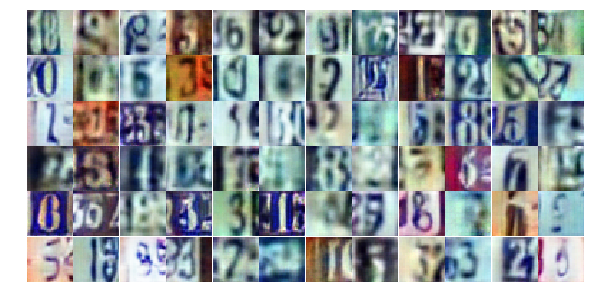

Epoch 23/25... Discriminator Loss: 0.6445... Generator Loss: 1.0769
Epoch 23/25... Discriminator Loss: 0.4714... Generator Loss: 1.4154
Epoch 23/25... Discriminator Loss: 0.8874... Generator Loss: 0.7894
Epoch 23/25... Discriminator Loss: 0.8387... Generator Loss: 0.7709
Epoch 23/25... Discriminator Loss: 0.9207... Generator Loss: 0.8850
Epoch 23/25... Discriminator Loss: 0.9807... Generator Loss: 0.7814
Epoch 23/25... Discriminator Loss: 1.1907... Generator Loss: 0.5754
Epoch 23/25... Discriminator Loss: 0.7164... Generator Loss: 0.9961
Epoch 23/25... Discriminator Loss: 0.5391... Generator Loss: 1.2503
Epoch 23/25... Discriminator Loss: 0.3728... Generator Loss: 1.6793


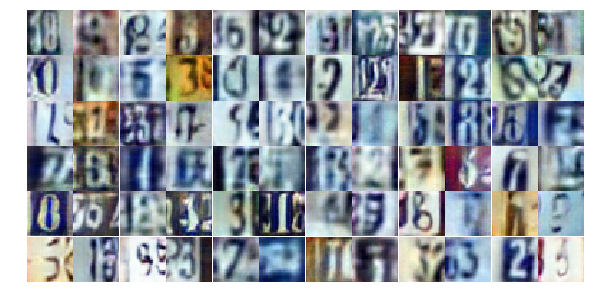

Epoch 23/25... Discriminator Loss: 0.5224... Generator Loss: 1.1983
Epoch 23/25... Discriminator Loss: 0.4947... Generator Loss: 1.9572
Epoch 23/25... Discriminator Loss: 0.7389... Generator Loss: 1.1638
Epoch 23/25... Discriminator Loss: 0.5907... Generator Loss: 1.2101
Epoch 23/25... Discriminator Loss: 0.5108... Generator Loss: 1.2678
Epoch 23/25... Discriminator Loss: 1.0138... Generator Loss: 0.7418
Epoch 23/25... Discriminator Loss: 0.9390... Generator Loss: 0.7238
Epoch 23/25... Discriminator Loss: 0.6790... Generator Loss: 1.0893
Epoch 23/25... Discriminator Loss: 1.1363... Generator Loss: 0.5518
Epoch 23/25... Discriminator Loss: 0.7283... Generator Loss: 1.0116


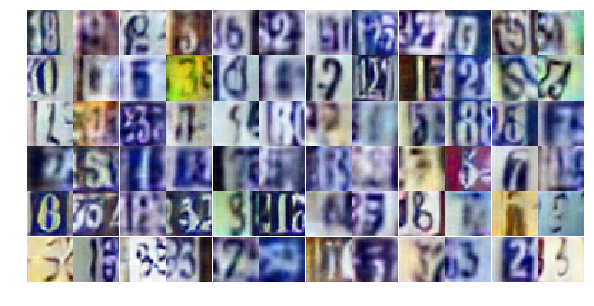

Epoch 23/25... Discriminator Loss: 1.0628... Generator Loss: 0.5986
Epoch 23/25... Discriminator Loss: 0.4972... Generator Loss: 1.4686
Epoch 23/25... Discriminator Loss: 0.9033... Generator Loss: 0.7293
Epoch 23/25... Discriminator Loss: 0.9410... Generator Loss: 0.6764
Epoch 23/25... Discriminator Loss: 0.5734... Generator Loss: 1.4262
Epoch 23/25... Discriminator Loss: 0.6936... Generator Loss: 1.0913
Epoch 23/25... Discriminator Loss: 0.7545... Generator Loss: 0.9185
Epoch 23/25... Discriminator Loss: 1.2500... Generator Loss: 0.4725
Epoch 23/25... Discriminator Loss: 0.8723... Generator Loss: 0.8532
Epoch 23/25... Discriminator Loss: 0.7196... Generator Loss: 1.7279


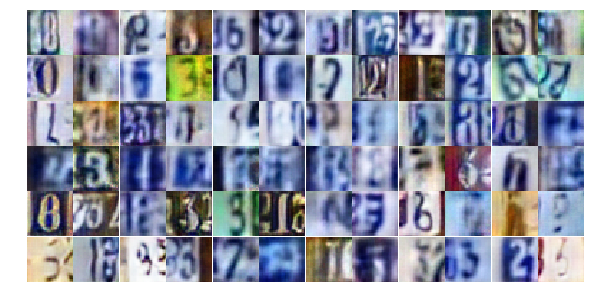

Epoch 23/25... Discriminator Loss: 0.5750... Generator Loss: 1.1958
Epoch 23/25... Discriminator Loss: 0.7120... Generator Loss: 1.0897
Epoch 23/25... Discriminator Loss: 0.8798... Generator Loss: 0.7558
Epoch 23/25... Discriminator Loss: 1.3369... Generator Loss: 0.4784
Epoch 23/25... Discriminator Loss: 1.0892... Generator Loss: 0.6447
Epoch 23/25... Discriminator Loss: 1.1658... Generator Loss: 0.5586
Epoch 23/25... Discriminator Loss: 1.2069... Generator Loss: 0.5113
Epoch 23/25... Discriminator Loss: 0.7622... Generator Loss: 0.9234
Epoch 23/25... Discriminator Loss: 0.4659... Generator Loss: 1.4739
Epoch 23/25... Discriminator Loss: 0.5114... Generator Loss: 1.3400


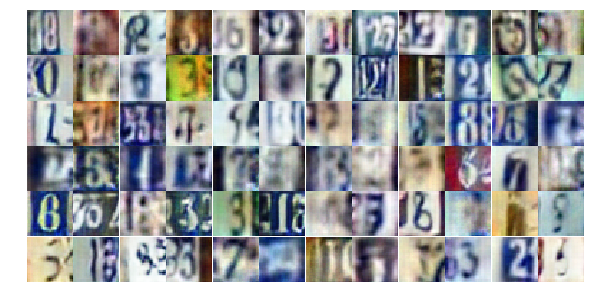

Epoch 23/25... Discriminator Loss: 0.7963... Generator Loss: 0.9947
Epoch 23/25... Discriminator Loss: 0.5962... Generator Loss: 1.5560
Epoch 23/25... Discriminator Loss: 0.7144... Generator Loss: 1.2956
Epoch 23/25... Discriminator Loss: 0.7253... Generator Loss: 1.2950
Epoch 23/25... Discriminator Loss: 2.0896... Generator Loss: 4.0328
Epoch 23/25... Discriminator Loss: 4.2051... Generator Loss: 2.6736
Epoch 23/25... Discriminator Loss: 0.7916... Generator Loss: 1.1895
Epoch 23/25... Discriminator Loss: 1.0778... Generator Loss: 0.7045
Epoch 23/25... Discriminator Loss: 0.9214... Generator Loss: 0.8667
Epoch 23/25... Discriminator Loss: 0.6957... Generator Loss: 1.3305


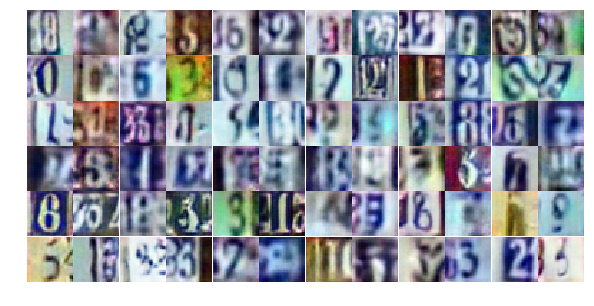

Epoch 23/25... Discriminator Loss: 0.6280... Generator Loss: 1.2247
Epoch 23/25... Discriminator Loss: 1.5007... Generator Loss: 0.4152
Epoch 23/25... Discriminator Loss: 1.1380... Generator Loss: 0.6038
Epoch 23/25... Discriminator Loss: 0.4440... Generator Loss: 1.6594
Epoch 23/25... Discriminator Loss: 0.9716... Generator Loss: 0.7318
Epoch 23/25... Discriminator Loss: 0.6053... Generator Loss: 1.3402
Epoch 23/25... Discriminator Loss: 0.7301... Generator Loss: 0.9198
Epoch 24/25... Discriminator Loss: 0.8250... Generator Loss: 0.8592
Epoch 24/25... Discriminator Loss: 0.9267... Generator Loss: 1.0258
Epoch 24/25... Discriminator Loss: 0.9768... Generator Loss: 0.8112


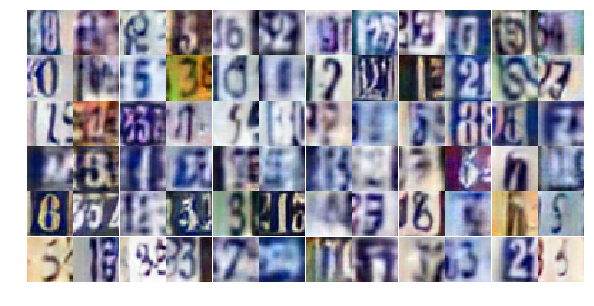

Epoch 24/25... Discriminator Loss: 0.8796... Generator Loss: 0.8688
Epoch 24/25... Discriminator Loss: 0.7734... Generator Loss: 0.8228
Epoch 24/25... Discriminator Loss: 0.8690... Generator Loss: 0.7739
Epoch 24/25... Discriminator Loss: 1.1137... Generator Loss: 0.6095
Epoch 24/25... Discriminator Loss: 0.5670... Generator Loss: 1.1688
Epoch 24/25... Discriminator Loss: 0.5826... Generator Loss: 1.2996
Epoch 24/25... Discriminator Loss: 0.7414... Generator Loss: 0.9231
Epoch 24/25... Discriminator Loss: 1.3010... Generator Loss: 0.4726
Epoch 24/25... Discriminator Loss: 0.3423... Generator Loss: 1.9105
Epoch 24/25... Discriminator Loss: 0.5103... Generator Loss: 1.6782


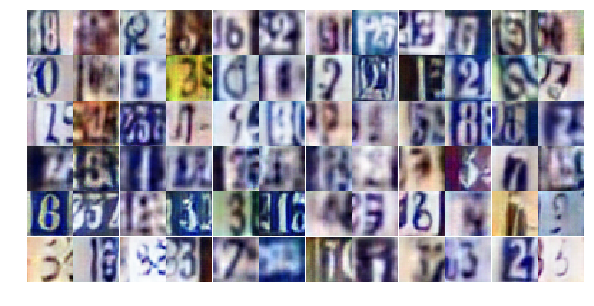

Epoch 24/25... Discriminator Loss: 1.3993... Generator Loss: 0.4184
Epoch 24/25... Discriminator Loss: 1.3136... Generator Loss: 0.5002
Epoch 24/25... Discriminator Loss: 1.0961... Generator Loss: 0.5886
Epoch 24/25... Discriminator Loss: 0.6346... Generator Loss: 1.0406
Epoch 24/25... Discriminator Loss: 0.6824... Generator Loss: 2.8763
Epoch 24/25... Discriminator Loss: 0.9101... Generator Loss: 0.7816
Epoch 24/25... Discriminator Loss: 0.6209... Generator Loss: 1.1768
Epoch 24/25... Discriminator Loss: 1.6326... Generator Loss: 0.3420
Epoch 24/25... Discriminator Loss: 0.9174... Generator Loss: 0.7160
Epoch 24/25... Discriminator Loss: 0.6757... Generator Loss: 1.0721


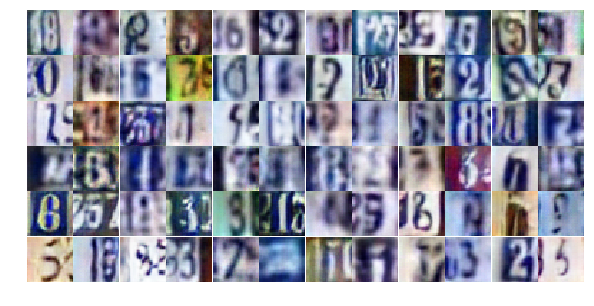

Epoch 24/25... Discriminator Loss: 1.2201... Generator Loss: 0.5430
Epoch 24/25... Discriminator Loss: 0.5446... Generator Loss: 1.3530
Epoch 24/25... Discriminator Loss: 0.6042... Generator Loss: 1.2303
Epoch 24/25... Discriminator Loss: 1.2843... Generator Loss: 0.5490
Epoch 24/25... Discriminator Loss: 0.6388... Generator Loss: 1.0283
Epoch 24/25... Discriminator Loss: 0.7205... Generator Loss: 1.1883
Epoch 24/25... Discriminator Loss: 0.5996... Generator Loss: 1.1406
Epoch 24/25... Discriminator Loss: 0.7922... Generator Loss: 0.9353
Epoch 24/25... Discriminator Loss: 0.8269... Generator Loss: 0.8599
Epoch 24/25... Discriminator Loss: 0.8969... Generator Loss: 0.8026


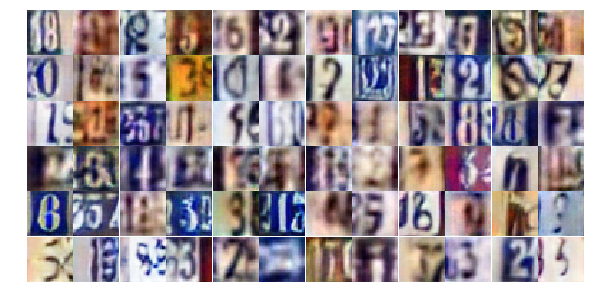

Epoch 24/25... Discriminator Loss: 0.7162... Generator Loss: 0.9317
Epoch 24/25... Discriminator Loss: 1.2285... Generator Loss: 0.5274
Epoch 24/25... Discriminator Loss: 0.7654... Generator Loss: 0.9403
Epoch 24/25... Discriminator Loss: 1.5869... Generator Loss: 0.3525
Epoch 24/25... Discriminator Loss: 1.4353... Generator Loss: 0.3951
Epoch 24/25... Discriminator Loss: 1.5216... Generator Loss: 0.3592
Epoch 24/25... Discriminator Loss: 1.1084... Generator Loss: 0.6073
Epoch 24/25... Discriminator Loss: 1.1649... Generator Loss: 0.5498
Epoch 24/25... Discriminator Loss: 0.6364... Generator Loss: 1.3608
Epoch 24/25... Discriminator Loss: 0.6764... Generator Loss: 1.1526


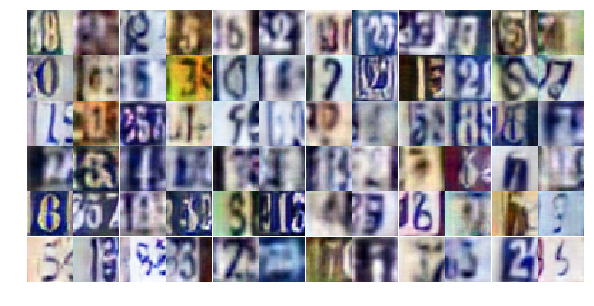

Epoch 24/25... Discriminator Loss: 0.7527... Generator Loss: 0.9845
Epoch 24/25... Discriminator Loss: 0.8642... Generator Loss: 0.8013
Epoch 24/25... Discriminator Loss: 3.9999... Generator Loss: 3.8296
Epoch 24/25... Discriminator Loss: 1.6378... Generator Loss: 1.3451
Epoch 24/25... Discriminator Loss: 1.8890... Generator Loss: 0.3215
Epoch 24/25... Discriminator Loss: 1.0556... Generator Loss: 0.7308
Epoch 24/25... Discriminator Loss: 1.4150... Generator Loss: 0.4602
Epoch 24/25... Discriminator Loss: 0.8728... Generator Loss: 0.8631
Epoch 24/25... Discriminator Loss: 1.0110... Generator Loss: 0.7435
Epoch 24/25... Discriminator Loss: 0.8447... Generator Loss: 0.9914


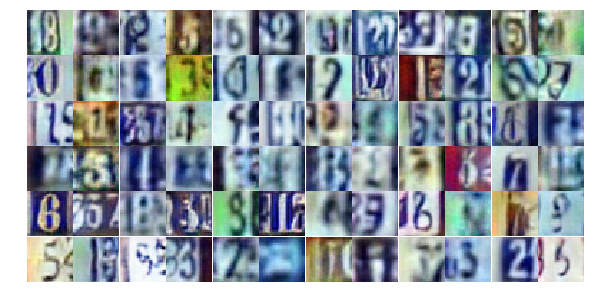

Epoch 24/25... Discriminator Loss: 1.0245... Generator Loss: 0.6678
Epoch 24/25... Discriminator Loss: 1.2494... Generator Loss: 0.4959
Epoch 24/25... Discriminator Loss: 1.0264... Generator Loss: 0.7045
Epoch 24/25... Discriminator Loss: 0.7432... Generator Loss: 1.0384
Epoch 24/25... Discriminator Loss: 0.8824... Generator Loss: 0.7962
Epoch 25/25... Discriminator Loss: 0.9206... Generator Loss: 0.8491
Epoch 25/25... Discriminator Loss: 0.6365... Generator Loss: 1.4070
Epoch 25/25... Discriminator Loss: 0.6601... Generator Loss: 1.0385
Epoch 25/25... Discriminator Loss: 1.1354... Generator Loss: 0.5754
Epoch 25/25... Discriminator Loss: 1.0770... Generator Loss: 0.5973


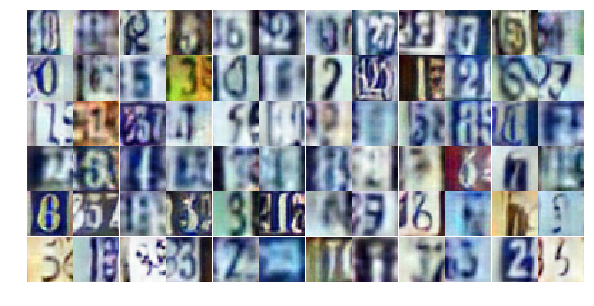

Epoch 25/25... Discriminator Loss: 1.1603... Generator Loss: 0.5885
Epoch 25/25... Discriminator Loss: 1.3402... Generator Loss: 0.4438
Epoch 25/25... Discriminator Loss: 0.7396... Generator Loss: 0.9429
Epoch 25/25... Discriminator Loss: 0.7380... Generator Loss: 0.9584
Epoch 25/25... Discriminator Loss: 0.9661... Generator Loss: 0.8034
Epoch 25/25... Discriminator Loss: 0.9870... Generator Loss: 0.8160
Epoch 25/25... Discriminator Loss: 0.8154... Generator Loss: 0.8817
Epoch 25/25... Discriminator Loss: 0.8180... Generator Loss: 0.9181
Epoch 25/25... Discriminator Loss: 0.5221... Generator Loss: 1.4799
Epoch 25/25... Discriminator Loss: 0.9098... Generator Loss: 0.6960


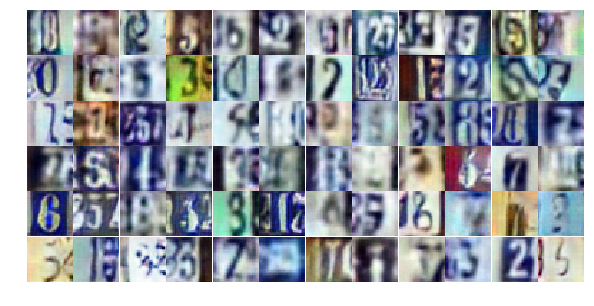

Epoch 25/25... Discriminator Loss: 0.8542... Generator Loss: 0.9578
Epoch 25/25... Discriminator Loss: 0.6365... Generator Loss: 1.2038
Epoch 25/25... Discriminator Loss: 0.9896... Generator Loss: 0.6825
Epoch 25/25... Discriminator Loss: 0.6596... Generator Loss: 1.1958
Epoch 25/25... Discriminator Loss: 0.9386... Generator Loss: 0.7439
Epoch 25/25... Discriminator Loss: 0.7477... Generator Loss: 1.0103
Epoch 25/25... Discriminator Loss: 0.9065... Generator Loss: 0.7822
Epoch 25/25... Discriminator Loss: 1.0687... Generator Loss: 0.6489
Epoch 25/25... Discriminator Loss: 0.4824... Generator Loss: 1.4049
Epoch 25/25... Discriminator Loss: 0.5609... Generator Loss: 1.3293


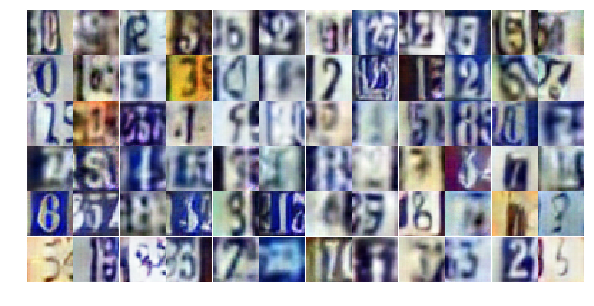

Epoch 25/25... Discriminator Loss: 0.9205... Generator Loss: 0.7263
Epoch 25/25... Discriminator Loss: 0.6436... Generator Loss: 1.0325
Epoch 25/25... Discriminator Loss: 1.5956... Generator Loss: 0.4443
Epoch 25/25... Discriminator Loss: 0.7952... Generator Loss: 0.8894
Epoch 25/25... Discriminator Loss: 0.7820... Generator Loss: 0.9271
Epoch 25/25... Discriminator Loss: 0.6728... Generator Loss: 0.9907
Epoch 25/25... Discriminator Loss: 0.7554... Generator Loss: 1.0925
Epoch 25/25... Discriminator Loss: 0.9880... Generator Loss: 0.6750
Epoch 25/25... Discriminator Loss: 0.6886... Generator Loss: 2.1962
Epoch 25/25... Discriminator Loss: 0.5938... Generator Loss: 1.2984


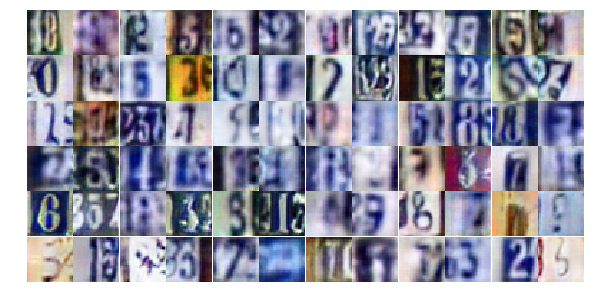

Epoch 25/25... Discriminator Loss: 0.7290... Generator Loss: 1.0829
Epoch 25/25... Discriminator Loss: 0.6254... Generator Loss: 1.1942
Epoch 25/25... Discriminator Loss: 0.9505... Generator Loss: 0.7283
Epoch 25/25... Discriminator Loss: 0.5641... Generator Loss: 1.1318
Epoch 25/25... Discriminator Loss: 1.7277... Generator Loss: 0.3484
Epoch 25/25... Discriminator Loss: 0.8002... Generator Loss: 1.0230
Epoch 25/25... Discriminator Loss: 0.4815... Generator Loss: 1.3112
Epoch 25/25... Discriminator Loss: 0.5678... Generator Loss: 1.2870
Epoch 25/25... Discriminator Loss: 1.6016... Generator Loss: 0.3824
Epoch 25/25... Discriminator Loss: 0.6233... Generator Loss: 1.1527


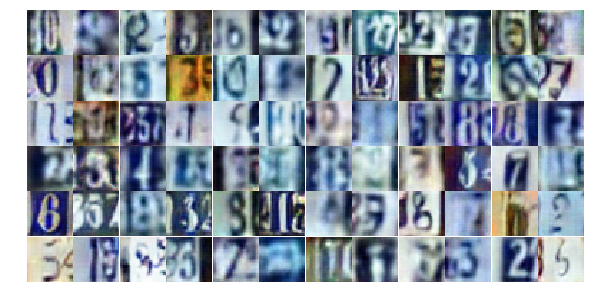

Epoch 25/25... Discriminator Loss: 0.8909... Generator Loss: 0.7970
Epoch 25/25... Discriminator Loss: 1.2674... Generator Loss: 0.4775
Epoch 25/25... Discriminator Loss: 1.2187... Generator Loss: 0.5011
Epoch 25/25... Discriminator Loss: 0.8223... Generator Loss: 0.8883
Epoch 25/25... Discriminator Loss: 0.9781... Generator Loss: 0.7163
Epoch 25/25... Discriminator Loss: 0.5157... Generator Loss: 1.3047
Epoch 25/25... Discriminator Loss: 1.2376... Generator Loss: 0.4960
Epoch 25/25... Discriminator Loss: 1.0684... Generator Loss: 0.5971
Epoch 25/25... Discriminator Loss: 0.8080... Generator Loss: 0.9962
Epoch 25/25... Discriminator Loss: 1.2639... Generator Loss: 0.5504


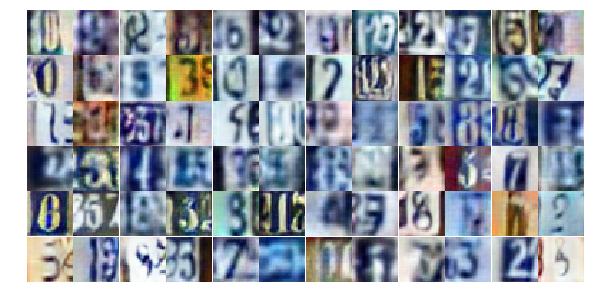

Epoch 25/25... Discriminator Loss: 0.5262... Generator Loss: 1.5614
Epoch 25/25... Discriminator Loss: 1.0760... Generator Loss: 0.6501
all done!


In [17]:
# Load the data and train the network here
dataset = Dataset(trainset, testset)
losses, samples = train(net, dataset, epochs, batch_size, figsize=(10,5))

print('all done!')

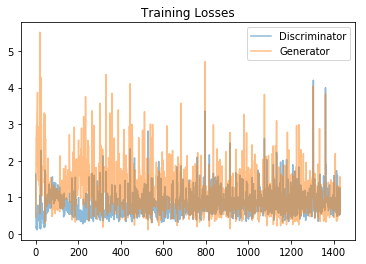

In [18]:
fig, ax = plt.subplots()
losses = np.array(losses)
plt.plot(losses.T[0], label='Discriminator', alpha=0.5)
plt.plot(losses.T[1], label='Generator', alpha=0.5)
plt.title("Training Losses")
plt.legend()

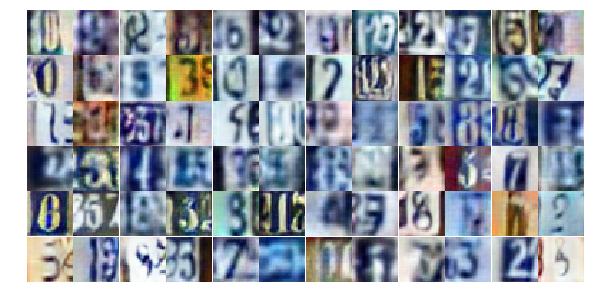

In [19]:
_ = view_samples(-1, samples, 6, 12, figsize=(10,5))